In [1]:
import os
import pdb
import h5py
from collections import defaultdict

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.stats import pearsonr

# Config

In [2]:
data_dir = "/clusterfs/nilah/ruchir/src/finetuning-enformer/finetuning/data/h5_bins_384_chrom_split/"
enformer_data_dir = "/global/scratch/users/aniketh/enformer_data/"
models_dir = "/global/scratch/users/aniketh/finetune-enformer/saved_models/"
test_preds_dir = "/global/scratch/users/aniketh/finetune-enformer/test_preds_final/"

train_h5_path = os.path.join(data_dir, "train.h5")
val_h5_path = os.path.join(data_dir, "val.h5")
test_h5_path = os.path.join(data_dir, "test.h5")

GEUVADIS_COUNTS_PATH = "../process_geuvadis_data/log_tpm/corrected_log_tpm.annot.csv.gz"
BASELINE_PREDS_PATH = (
    "../baseline/baseline_enformer.384_bins.rc.csv"
)
PREDIXCAN_PREDS_PATH = "../predixcan_lite/h5_bins_384_chrom_split/384_bins_no_cv/preds.csv"

all_main_run_names={
    "classification": "NCCL_P2P_DISABLE=1 python finetuning/train_pairwise_classification_parallel_h5_dataset_dynamic_sampling_dataset.py {train_h5_path} {val_h5_path} {run_name} {models_dir} --batch_size 1 --lr 0.0001 --weight_decay 0.001 --data_seed {data_seed} --resume_from_checkpoint",
    "regression": "NCCL_P2P_DISABLE=1 python finetuning/train_pairwise_regression_parallel_h5_dataset.py {train_h5_path} {val_h5_path} {run_name} {models_dir} --batch_size 1 --lr 0.0001 --weight_decay 0.001 --use_scheduler --warmup_steps 1000 --data_seed {data_seed} --resume_from_checkpoint",
    "single_regression_counts": "NCCL_P2P_DISABLE=1 python finetuning/train_single_counts_parallel_h5_dataset.py {train_h5_path} {val_h5_path} {run_name} {models_dir} --batch_size 2 --lr 0.0001 --weight_decay 0.001 --use_scheduler --warmup_steps 1000 --data_seed {data_seed} --resume_from_checkpoint",
#     "single_regression": "NCCL_P2P_DISABLE=1 python finetuning/train_single_parallel_h5_dataset.py {train_h5_path} {val_h5_path} {run_name} {models_dir} --batch_size 2 --lr 0.0001 --weight_decay 0.001 --use_scheduler --warmup_steps 1000 --data_seed {data_seed} --resume_from_checkpoint", ###DOEST PERFORM WELL, NOT USED
    "joint_classification": "NCCL_P2P_DISABLE=1 python finetuning/train_pairwise_classification_with_enformer_data_parallel_h5_dynamic_sampling_dataset.py {train_h5_path} {val_h5_path} {enformer_data_dir} {run_name} {models_dir} --batch_size 1 --lr 0.0005 --weight_decay 0.005 --use_scheduler --warmup_steps 1000 --data_seed {data_seed} --resume_from_checkpoint",
    "joint_regression": "NCCL_P2P_DISABLE=1 python finetuning/train_pairwise_regression_with_enformer_data_parallel_h5_dynamic_sampling_dataset.py {train_h5_path} {val_h5_path} {enformer_data_dir} {run_name} {models_dir} --batch_size 1 --lr 0.0005 --weight_decay 0.005 --use_scheduler --warmup_steps 1000 --data_seed {data_seed} --resume_from_checkpoint",
}
all_seeds = [42, 97, 7]
subsample_fracs = [0.2, 0.4, 0.6, 0.8]
all_afs = list(np.arange(0.01, 0.1, 0.01).round(2)) + list(np.arange(0.1, 0.4, 0.05).round(2)) + list(np.arange(0.41, 0.49, 0.01).round(2))

In [3]:
ALL_PREDS_PATHS = {}

# MAIN TEST RUNS
for run in all_main_run_names:
    for i, seed in enumerate(all_seeds):
        train_cmd_template = all_main_run_names[run]
        lr_used_during_training = train_cmd_template.split("--lr ")[-1].split(" ")[0]
        wd_used_during_training = train_cmd_template.split("--weight_decay ")[-1].split(" ")[0]
        rcprob_used_during_training = 0.5
        rsmax_used_during_training = 3
            
        model_name = f"{run}_data_seed_{seed}_lr_{lr_used_during_training}_wd_{wd_used_during_training}_rcprob_{rcprob_used_during_training}_rsmax_{rsmax_used_during_training}"
        ALL_PREDS_PATHS[model_name] = os.path.join(test_preds_dir, model_name)
        
# TEST RUNS FOR SUBSAMPLED TRAIN SET RUNS FOR REGRESSION
for run in ["regression"]:
    for i, seed in enumerate(all_seeds):
        for j, frac in enumerate(subsample_fracs):
            train_cmd_template = all_main_run_names[run]
            lr_used_during_training = train_cmd_template.split("--lr ")[-1].split(" ")[0]
            wd_used_during_training = train_cmd_template.split("--weight_decay ")[-1].split(" ")[0]
            rcprob_used_during_training = 0.5
            rsmax_used_during_training = 3
            
            model_name = f"{run}_data_seed_{seed}_lr_{lr_used_during_training}_wd_{wd_used_during_training}_rcprob_{rcprob_used_during_training}_rsmax_{rsmax_used_during_training}_subsample_ratio_{frac}"
            ALL_PREDS_PATHS[model_name] = os.path.join(test_preds_dir, model_name)

# TEST RUNS USING SUBSAMPLED VARIANTS FOR REGRESSION
for run in ["regression"]:
    for i, seed in enumerate(all_seeds):
        for j, af in enumerate(all_afs):
            train_cmd_template = all_main_run_names[run]
            lr_used_during_training = train_cmd_template.split("--lr ")[-1].split(" ")[0]
            wd_used_during_training = train_cmd_template.split("--weight_decay ")[-1].split(" ")[0]
            rcprob_used_during_training = 0.5
            rsmax_used_during_training = 3
            
            model_name = f"{run}_data_seed_{seed}_lr_{lr_used_during_training}_wd_{wd_used_during_training}_rcprob_{rcprob_used_during_training}_rsmax_{rsmax_used_during_training}"
            if not os.path.exists(os.path.join(test_preds_dir, model_name, f"af_{af}", "test_preds.npz")):
                print("Dir missing", os.path.join(test_preds_dir, model_name, f"af_{af}"))
                continue
            ALL_PREDS_PATHS[model_name + f"_af_{af}"] = os.path.join(test_preds_dir, model_name, f"af_{af}")

test_h5 = h5py.File(test_h5_path, "r")

# Read test set predictions and compute correlations

In [4]:
def load_geuvadis_data() -> pd.DataFrame:
    counts_df = pd.read_csv(GEUVADIS_COUNTS_PATH, index_col=0)
    counts_df = counts_df.reset_index().set_index("our_gene_name")
    return counts_df


def load_finetuned_preds(PREDS_PATH):
    """
    Returns a dictionary of dictionaries, where the outer keys are the genes
    and the inner keys are the samples. The values are the predictions.
    """
    preds_by_gene = defaultdict(dict)
    ancestries_by_gene = defaultdict(dict)
    data = np.load(os.path.join(PREDS_PATH, "test_preds.npz"))

    preds, genes, samples = data["preds"], data["genes"], data["samples"]
    ancestries = test_h5["ancestries"][:].astype(str)
    for (pred, gene, sample, ancestry) in zip(preds, genes, samples, ancestries):
        preds_by_gene[gene][sample] = pred
        ancestries_by_gene[gene][sample] = ancestry
    return preds_by_gene, ancestries_by_gene


def get_finetuned_corrs(finetuned_preds, geuvadis_df):
    corrs = {}
    for g in finetuned_preds:
        assert g in geuvadis_df.index
        samples = list(finetuned_preds[g].keys())
        gene_preds = [finetuned_preds[g][s] for s in samples]
        gene_counts = geuvadis_df.loc[g, samples].values.astype("float32")
        assert np.isnan(gene_preds).sum() == 0
        assert np.isnan(gene_counts).sum() == 0
        corrs[g] = pearsonr(gene_preds, gene_counts)[0]
        
        try:
            assert np.isnan(corrs[g]).sum() == 0
        except:
            print(f"Gene {g} has invalid predictions/counts and thus has a nan pearsonR")
            corrs[g] = 0
            
    return corrs


def compare_to_geuvadis_counts(finetuned_preds, geuvadis_df, gene, ax):
    samples = list(finetuned_preds[gene].keys())
    gene_preds = [finetuned_preds[gene][s] for s in samples]
    gene_counts = geuvadis_df.loc[gene, samples].values
    ax.scatter(gene_counts, gene_preds)
    ax.set(
        xlabel="Geuvadis counts",
        ylabel="finetuned predictions",
        title=f"Correlation: {pearsonr(gene_preds, gene_counts)[0]:.3f}",
    )


def compare_to_baseline_counts(finetuned_preds, baseline_df, gene, ax):
    samples = list(finetuned_preds[gene].keys())
    baseline_preds = baseline_df[gene][samples].values
    finetuned_preds = [finetuned_preds[gene][s] for s in samples]
    ax.scatter(baseline_preds, finetuned_preds)
    ax.set(
        xlabel="baseline predictions",
        ylabel="finetuned predictions",
        title=f"Correlation: {pearsonr(baseline_preds, finetuned_preds)[0]:.3f}",
    )


def load_other_model_preds_df(preds_df_path):
    preds_df = pd.read_csv(preds_df_path, index_col=0).T
    return preds_df


def get_other_model_corrs(preds_df, geuvadis_df, finetuned_preds):
    corrs = {}
    for g in finetuned_preds:
        if g not in preds_df.columns:
            print(f"Gene {g} has no predictions/counts and thus has a nan PearsonR")
            corrs[g] = 0
            continue
        
        assert g in geuvadis_df.index
        samples = list(finetuned_preds[g].keys())

        gene_preds = preds_df[g][samples].values
        gene_counts = geuvadis_df.loc[g, samples].values
        corrs[g] = pearsonr(gene_preds, gene_counts)[0]
        
        try:
            assert np.isnan(corrs[g]).sum() == 0
        except:
            print(f"Gene {g} has invalid predictions/counts and thus has a nan PearsonR")
            corrs[g] = 0
            
    return corrs


def compare_finetuned_to_baseline_perf(
    finetuned_corrs, baseline_corrs, finetuned_preds, ancestries_by_gene, abs_corrs: bool = False
):
    genes = list(finetuned_corrs.keys())
    finetuned_corrs_l = [finetuned_corrs[g] for g in genes]
    baseline_corrs_l = [baseline_corrs[g] for g in genes]
    
    gene_class = []
    for g in genes:
        temp = np.array([ancestries_by_gene[g][key] for key in ancestries_by_gene[g]])
        if (temp != "Yoruba").sum() == 0:
            gene_class.append("yri_split")
        elif len(finetuned_preds[g]) <= 77:
            gene_class.append("random_split")
        else:
            gene_class.append("unseen")
    
    df = pd.DataFrame(
        {
            "gene": genes,
            "finetuned Pearson": np.abs(finetuned_corrs_l) 
            if abs_corrs 
            else finetuned_corrs_l,
            "baseline Pearson": np.abs(baseline_corrs_l)
            if abs_corrs
            else baseline_corrs_l,
            "gene_class": gene_class,
        }
    )

    ax = sns.scatterplot(
        data=df,
        x="baseline Pearson",
        y="finetuned Pearson",
        hue="gene_class",
    )
    ax.set_ylabel("|finetuned Pearson|" if abs_corrs else "finetuned Pearson")
    ax.set_xlabel("|baseline Pearson|" if abs_corrs else "baseline Pearson")
    lims = [
        np.min([ax.get_xlim(), ax.get_ylim()]),  # min of both axes
        np.max([ax.get_xlim(), ax.get_ylim()]),  # max of both axes
    ]
    ax.set(aspect="equal", xlim=lims, ylim=lims)
    
    ax.axhline(
        df[df["gene_class"] == "random_split"]["finetuned Pearson"].mean(),
        color="blue",
        ls="--",
        label="random_split"
    )
    ax.axvline(
        df[df["gene_class"] == "random_split"]["baseline Pearson"].mean(),
        color="blue",
        ls="--",
        label="random_split"
    )

    ax.axhline(
        df[df["gene_class"] == "yri_split"]["finetuned Pearson"].mean(),
        color="orange",
        ls="--",
        label="yri_split"
    )
    ax.axvline(
        df[df["gene_class"] == "yri_split"]["baseline Pearson"].mean(),
        color="orange",
        ls="--",
        label="yri_split"
    )
    
    ax.axhline(
        df[df["gene_class"] == "unseen"]["finetuned Pearson"].mean(),
        color="green",
        ls="--",
        label="unseen"
    )
    ax.axvline(
        df[df["gene_class"] == "unseen"]["baseline Pearson"].mean(),
        color="green",
        ls="--",
        label="unseen"
    )
    
    summary = {}
    
    for split in ["random_split", "yri_split", "unseen"]:
        print(f"Split {split}, n_samples = {(df['gene_class'] == split).sum()}")
        print(f"Baseline PearsonR = {df[df['gene_class'] == split]['baseline Pearson'].mean()}")
        print(f"Finetuned PearsonR = {df[df['gene_class'] == split]['finetuned Pearson'].mean()}")
        print()
        
        summary["Baseline " + split] = df[df['gene_class'] == split]['baseline Pearson'].mean()
        summary["Finetuned " + split] = df[df['gene_class'] == split]['finetuned Pearson'].mean()

    plt.show()
    return summary

In [5]:
geuvadis_df = load_geuvadis_data()
baseline_df = load_other_model_preds_df(BASELINE_PREDS_PATH)
predixcan_df = load_other_model_preds_df(PREDIXCAN_PREDS_PATH)

classification_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

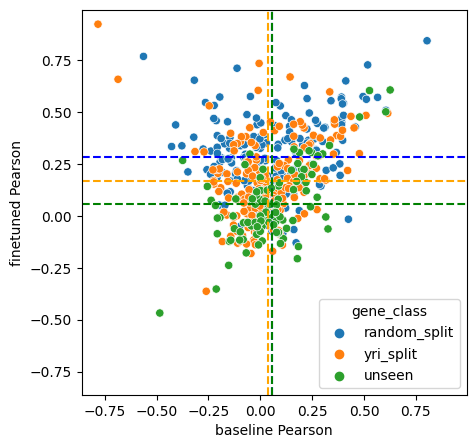

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2903297049040467

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19529911932379362

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1370004755564583



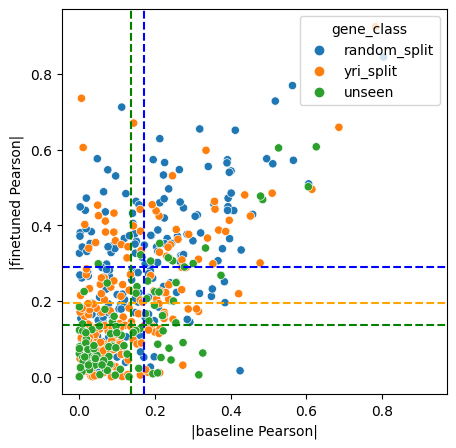

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2844971575752882

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16718678125924807

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.05840994003236499



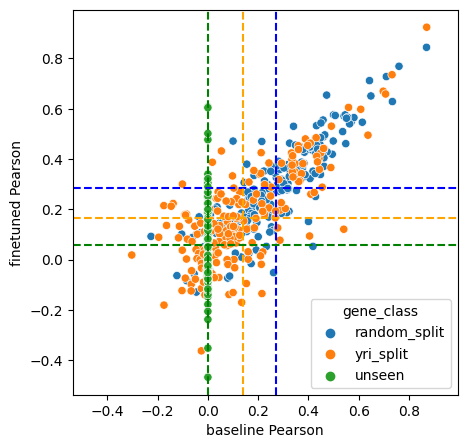

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2903297049040467

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19529911932379362

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1370004755564583



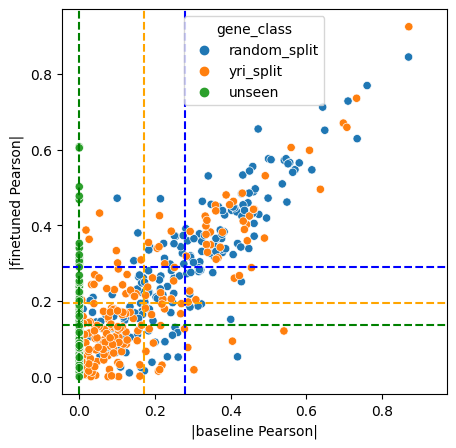

classification_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

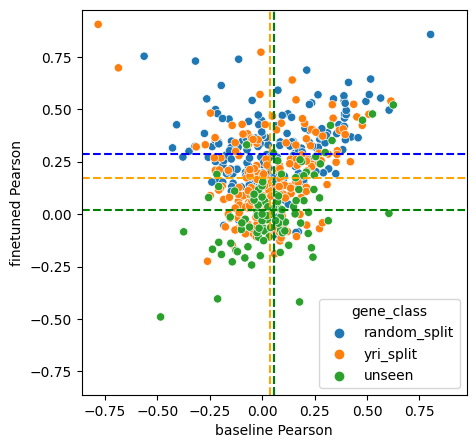

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.29247307187302474

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19542859050529407

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13376489619305712



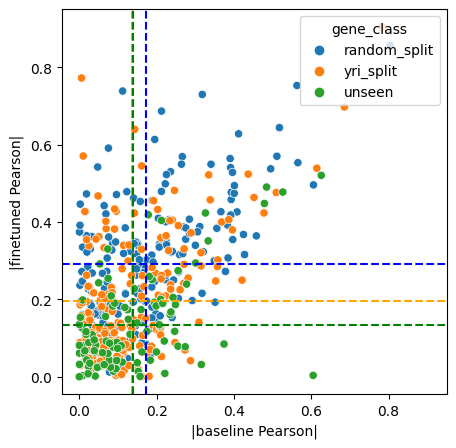

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2872947362573528

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.17066781529837294

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.02005952504310517



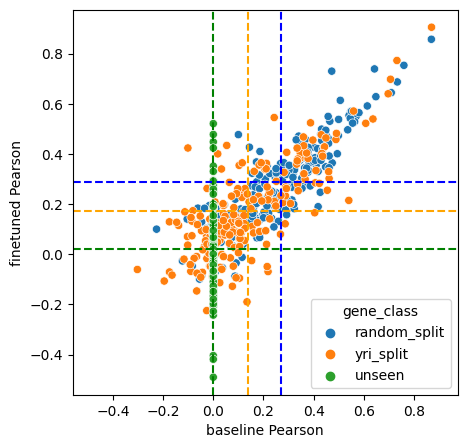

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.29247307187302474

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19542859050529407

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13376489619305712



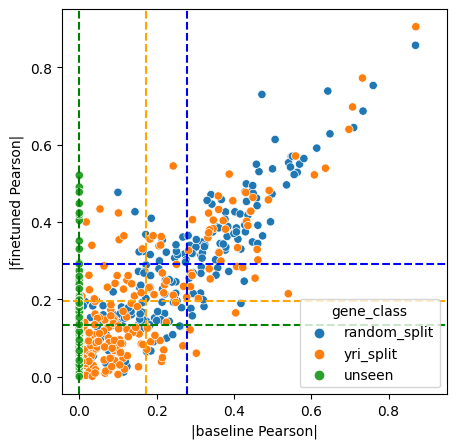

classification_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

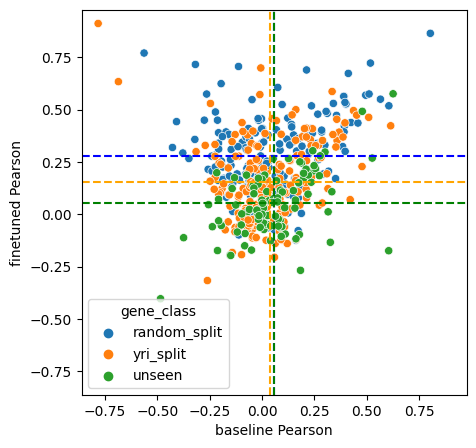

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28748450489794525

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18844012603256588

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12165702910894347



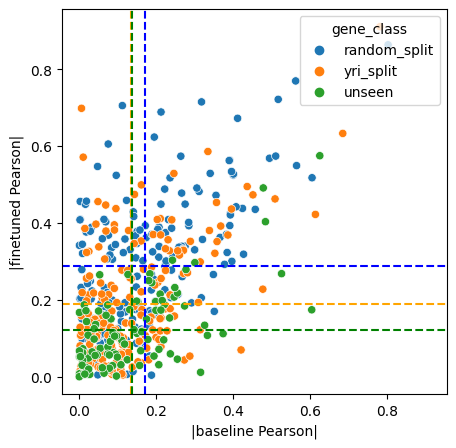

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.28023437285420144

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.15450001463786564

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.05149472131627092



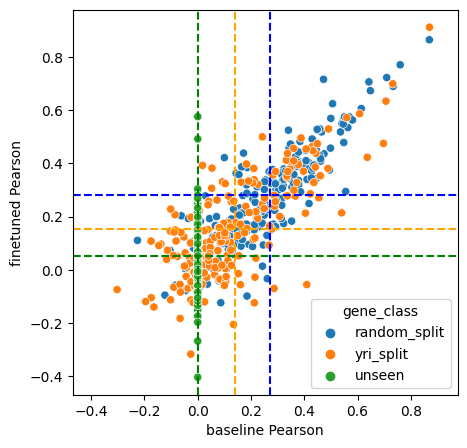

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28748450489794525

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18844012603256588

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12165702910894347



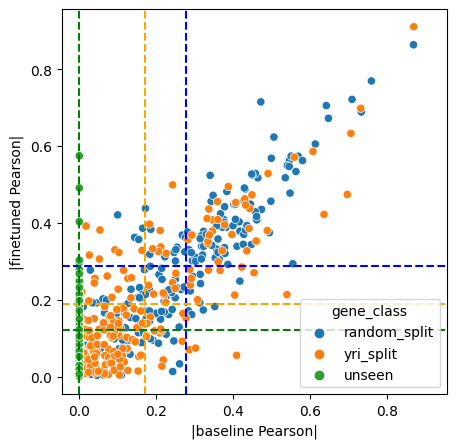

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

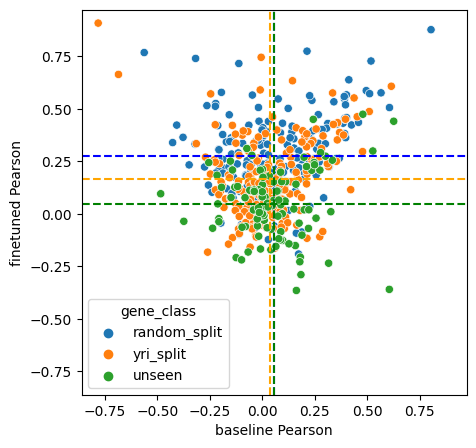

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2864498208251164

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19199188102290024

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



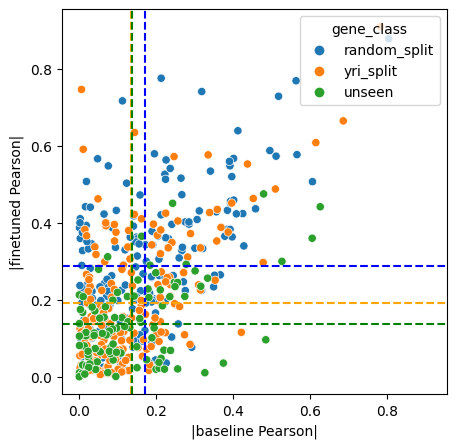

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2777387260096611

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16751589011498683

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



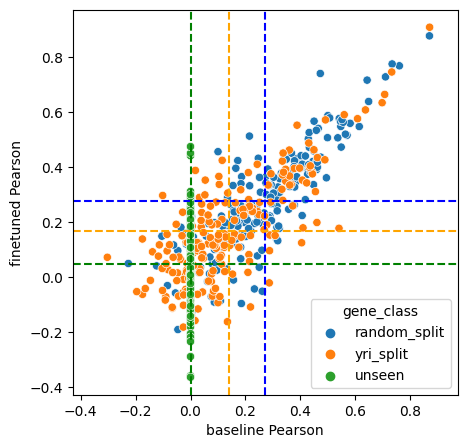

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2864498208251164

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19199188102290024

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



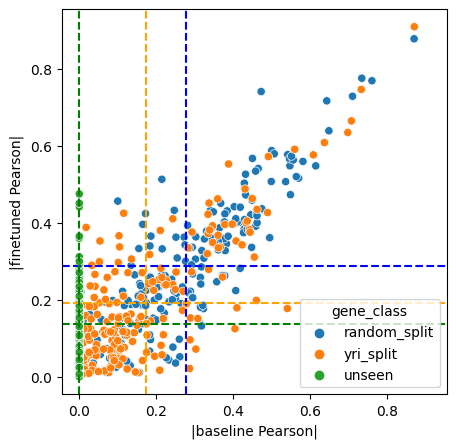

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

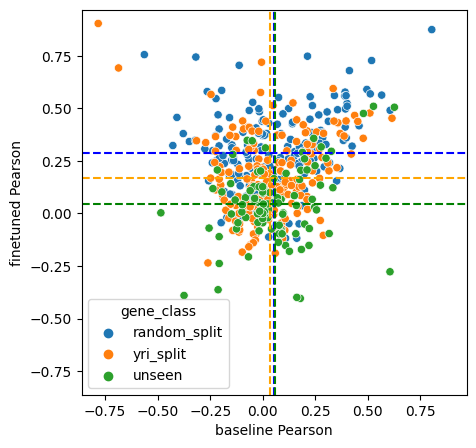

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2924177726007687

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1950672131816264

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



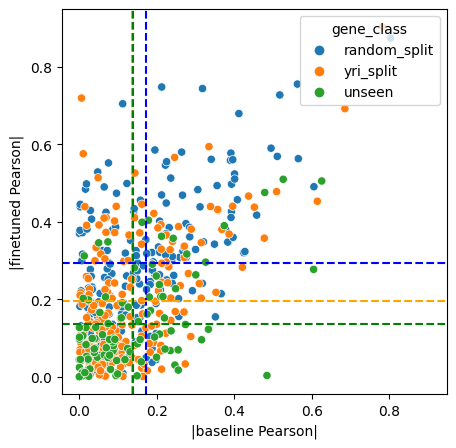

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.28652725175724975

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1694765095981889

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



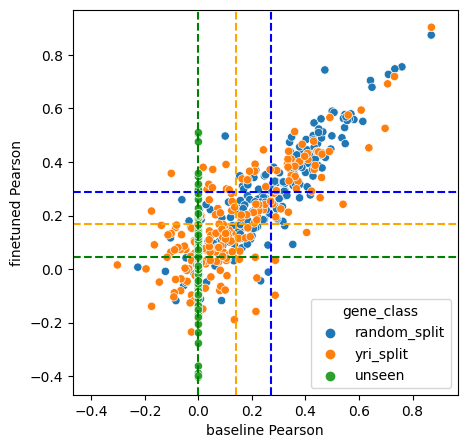

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2924177726007687

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1950672131816264

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



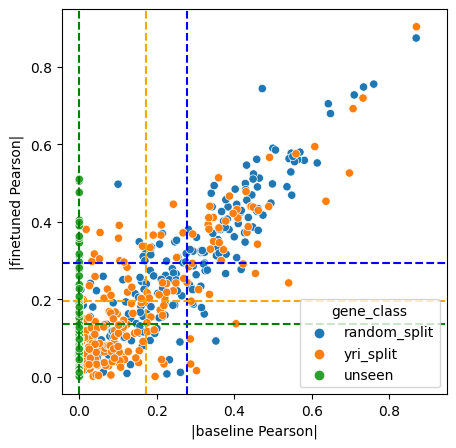

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

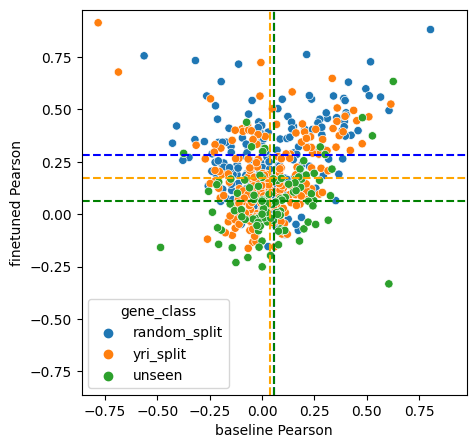

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.285579802038548

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1931652604974186

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



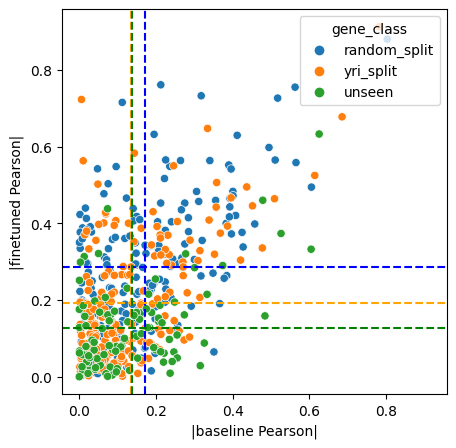

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2802915051501422

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.17270695717684426

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



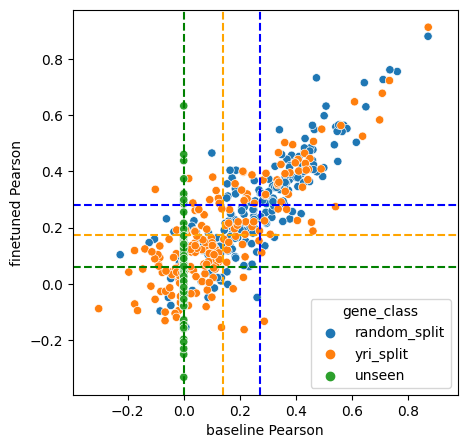

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.285579802038548

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1931652604974186

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



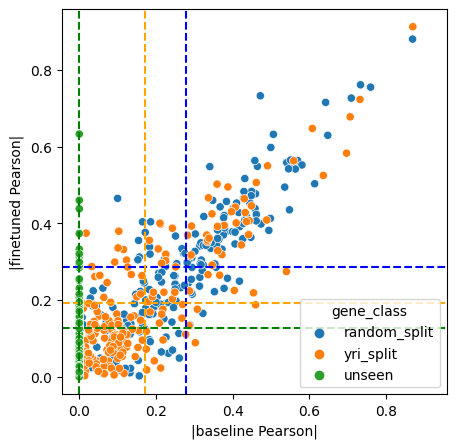

single_regression_counts_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

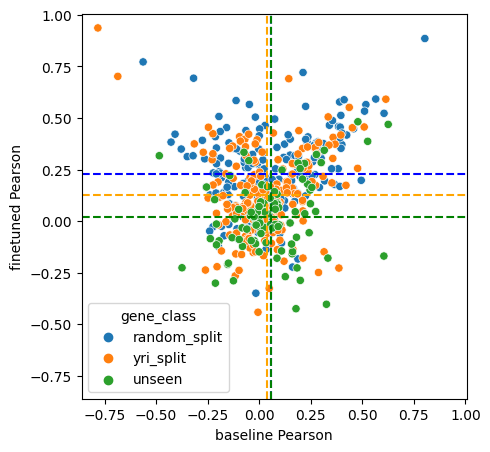

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.24835076446176652

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18386428010469338

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13368484073253964



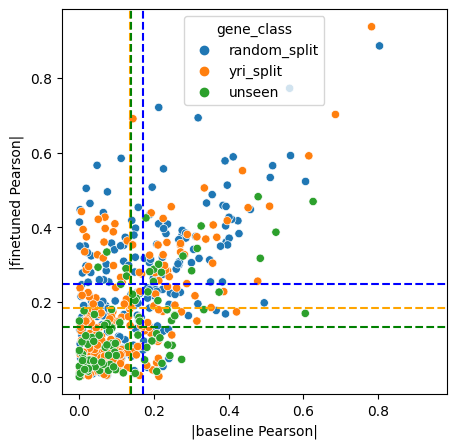

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.22933072071669883

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.12794970209008072

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.021491541229631067



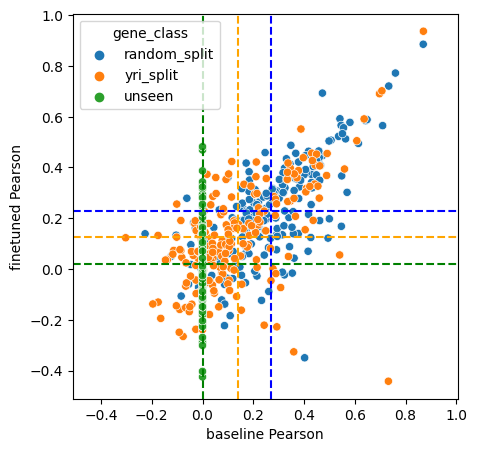

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.24835076446176652

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18386428010469338

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13368484073253964



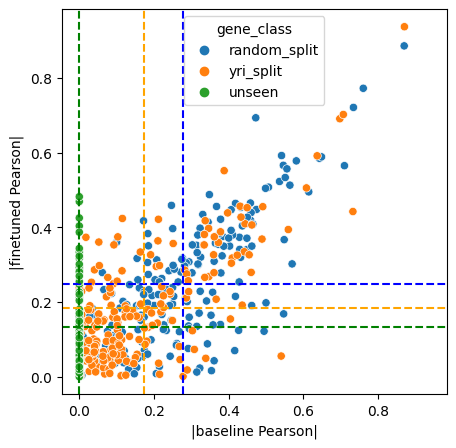

single_regression_counts_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

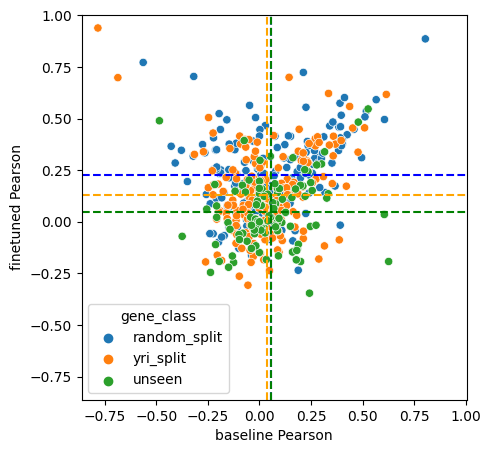

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.24085183952837375

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17957906194550285

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1314842215368026



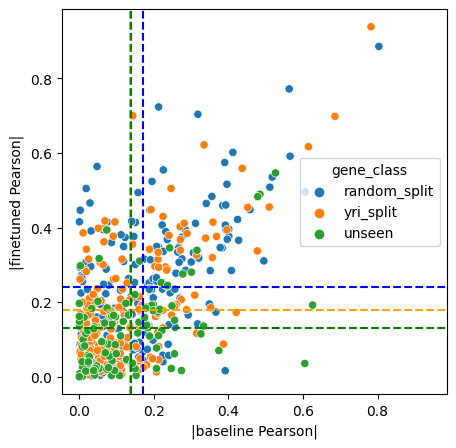

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.22490085857920206

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.13072568623478695

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04760627573517777



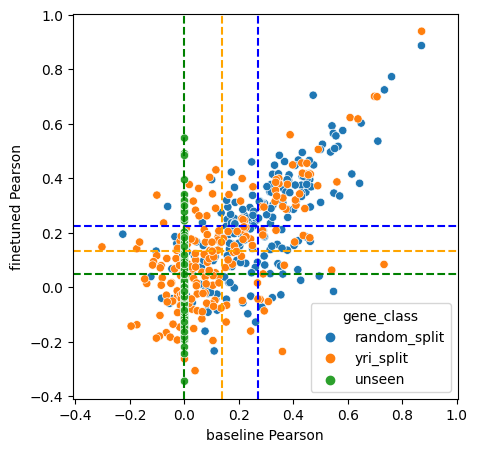

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.24085183952837375

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17957906194550285

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1314842215368026



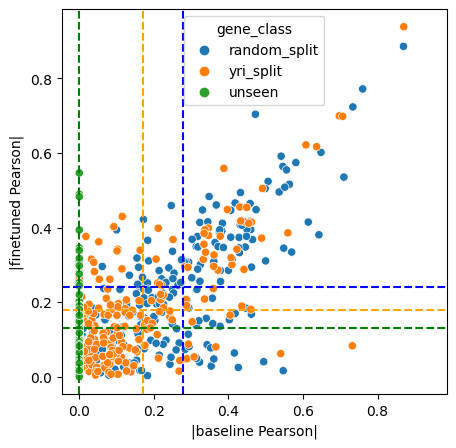

single_regression_counts_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

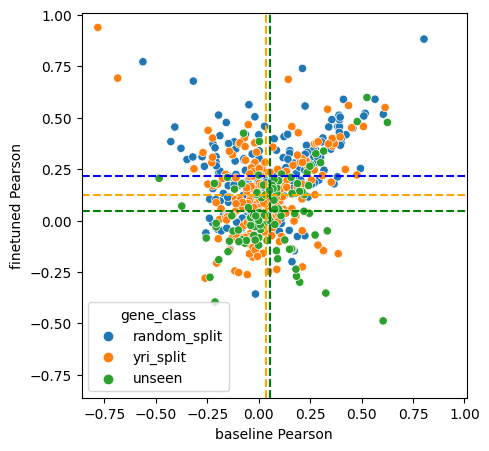

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2361964083454267

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17755888411308557

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.14292938456887258



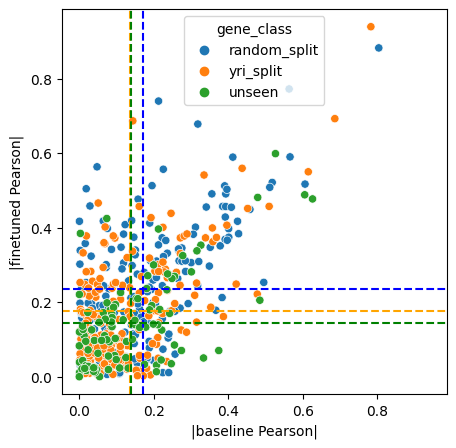

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2180967852373051

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.12219919200270336

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04507468832200029



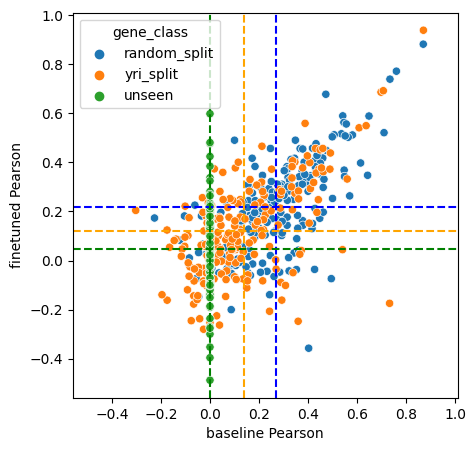

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2361964083454267

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17755888411308557

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.14292938456887258



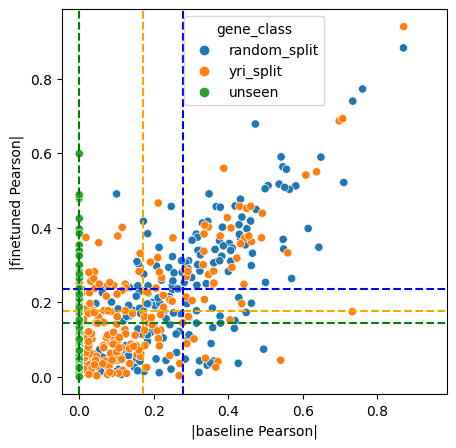

joint_classification_data_seed_42_lr_0.0005_wd_0.005_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

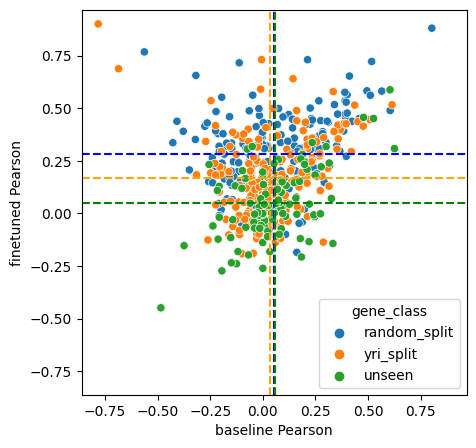

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2890439247250415

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19333012512825348

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13239244277090956



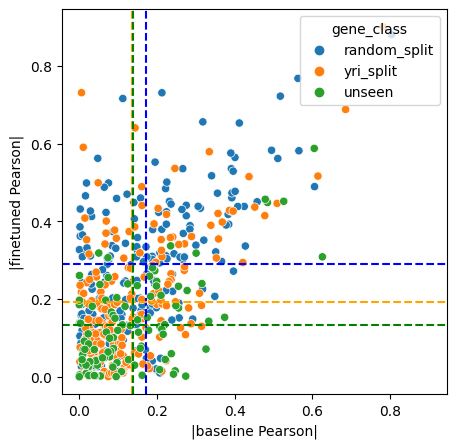

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.28208634671125643

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1694928907747048

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04901280110765865



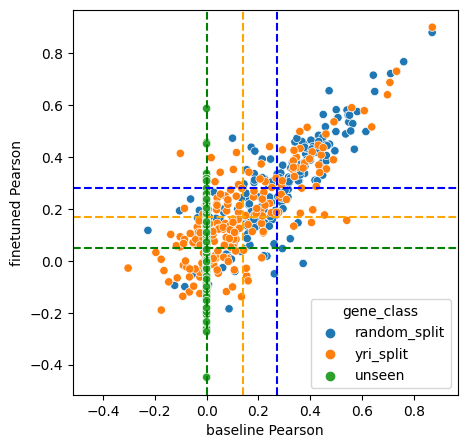

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2890439247250415

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19333012512825348

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13239244277090956



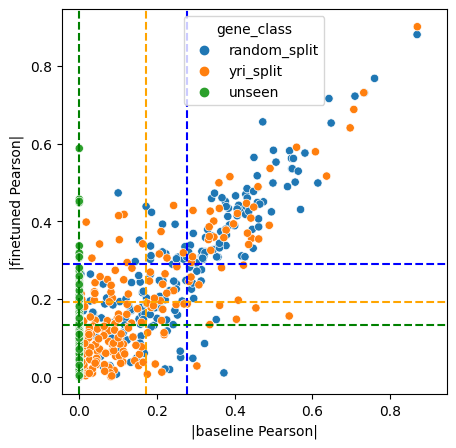

joint_classification_data_seed_97_lr_0.0005_wd_0.005_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

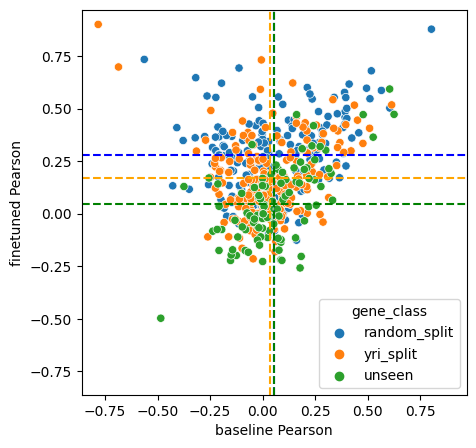

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28509624603962996

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1889761528226399

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.14942693866752985



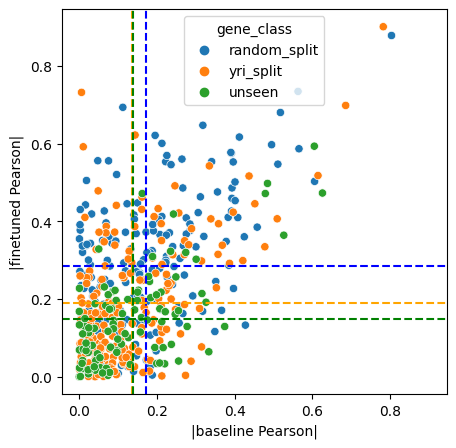

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.28058401167815916

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16832206241351108

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.045706811036111496



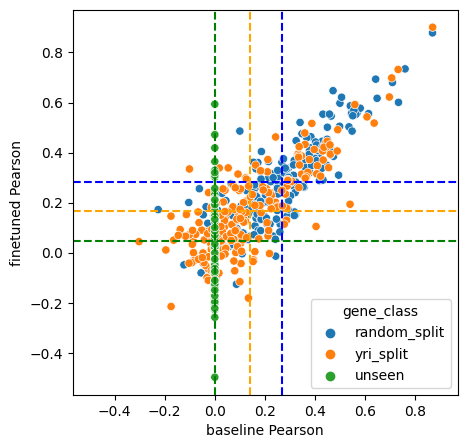

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28509624603962996

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1889761528226399

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.14942693866752985



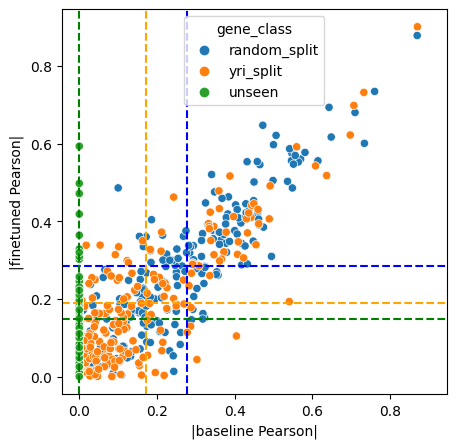

joint_classification_data_seed_7_lr_0.0005_wd_0.005_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

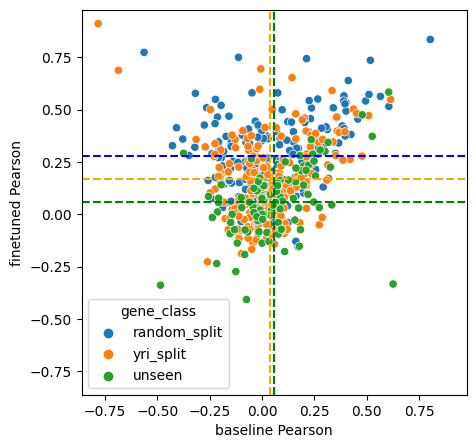

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2868321491253718

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19544027690772722

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13283431222253023



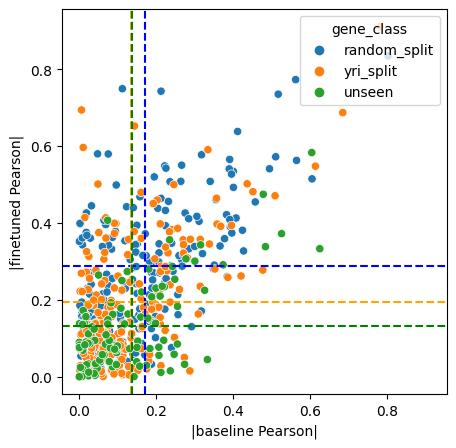

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.27948303868225305

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16668401129800445

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.05688172506557377



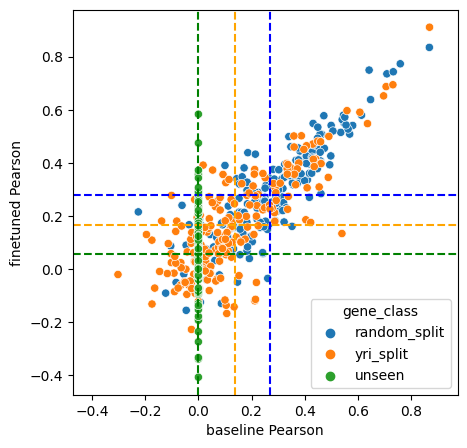

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2868321491253718

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19544027690772722

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13283431222253023



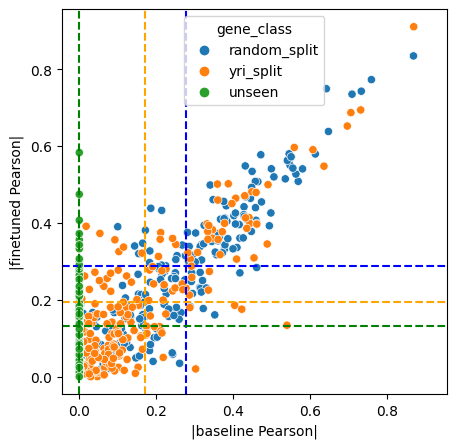

joint_regression_data_seed_42_lr_0.0005_wd_0.005_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

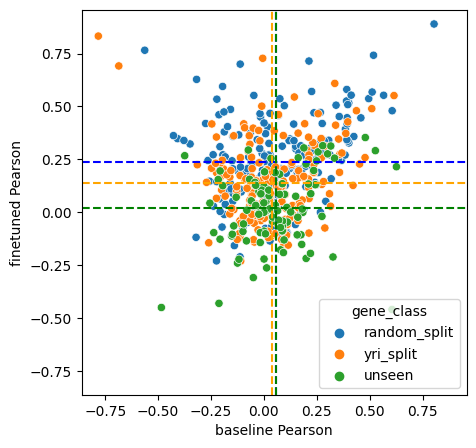

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.256371086719396

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17142417349148992

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1346716649773927



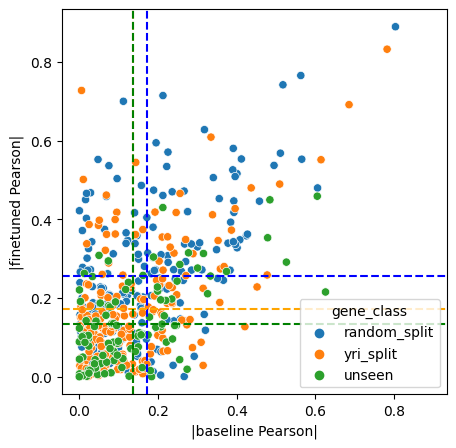

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.236629134173601

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.13929641555118194

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.01945252708587493



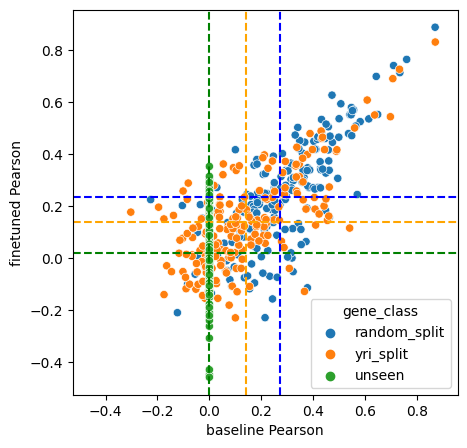

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.256371086719396

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17142417349148992

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1346716649773927



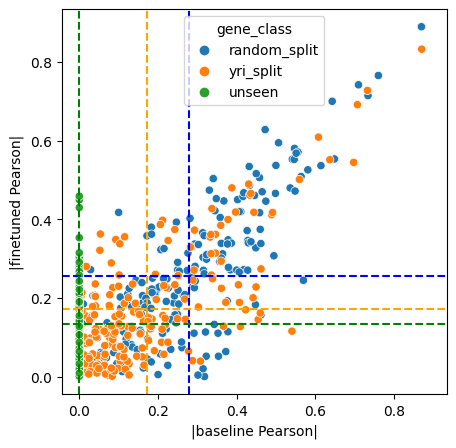

joint_regression_data_seed_97_lr_0.0005_wd_0.005_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

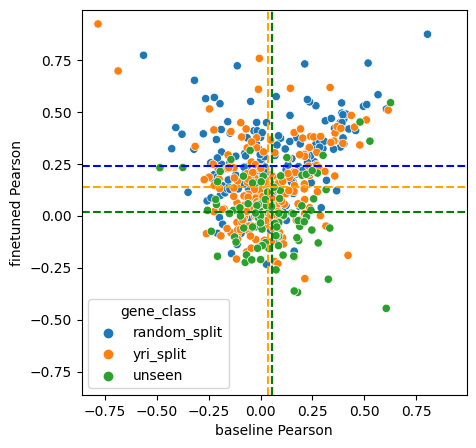

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.25424424037637144

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17711378842652883

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12557786016741887



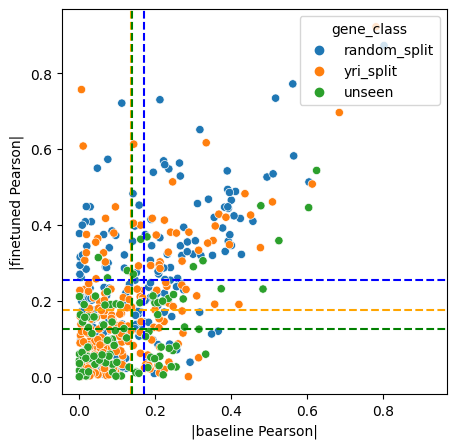

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.23829817839820022

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1378434622412094

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.015425256306327715



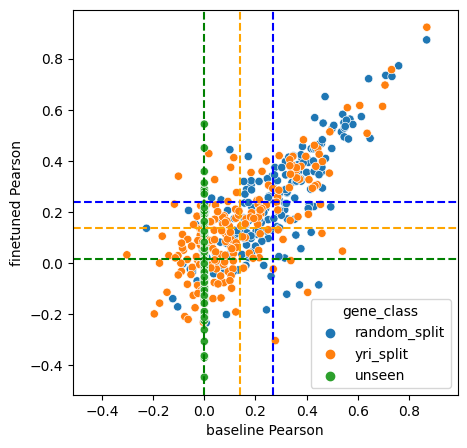

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.25424424037637144

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17711378842652883

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12557786016741887



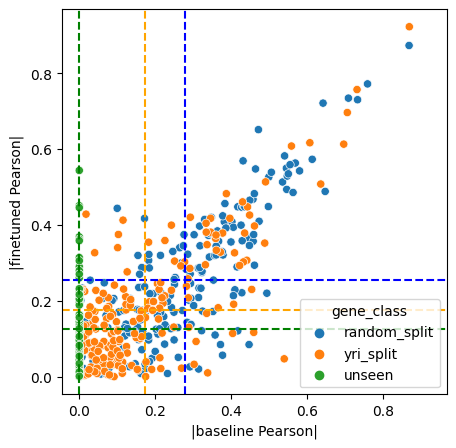

joint_regression_data_seed_7_lr_0.0005_wd_0.005_rcprob_0.5_rsmax_3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

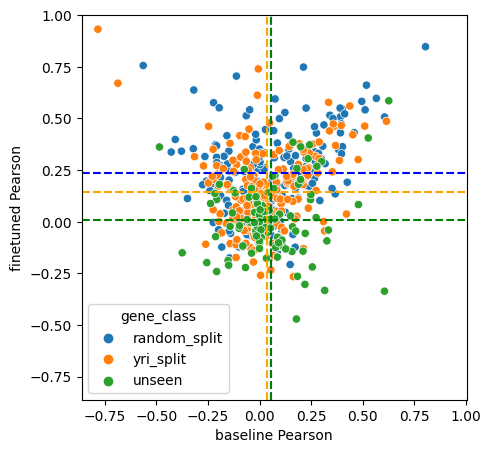

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.24992969991953765

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18555054111055305

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13520520793917273



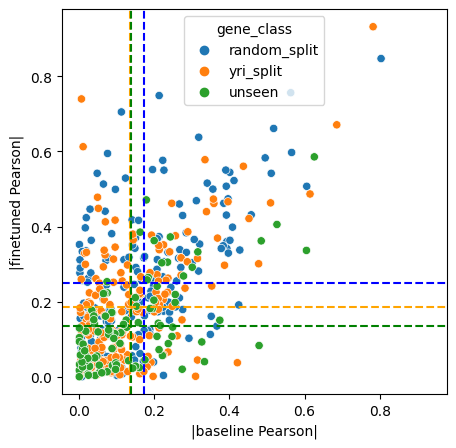

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.23360937035191573

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1460711015691729

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.00766516143585881



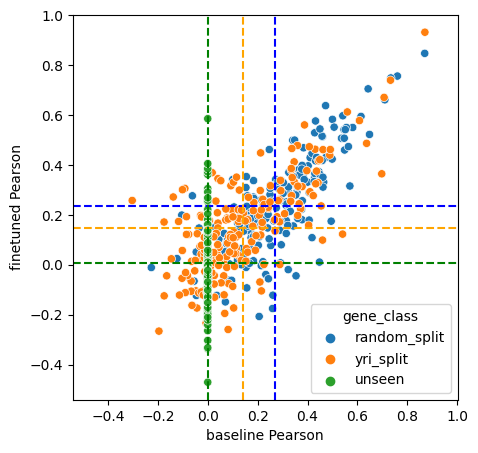

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.24992969991953765

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18555054111055305

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13520520793917273



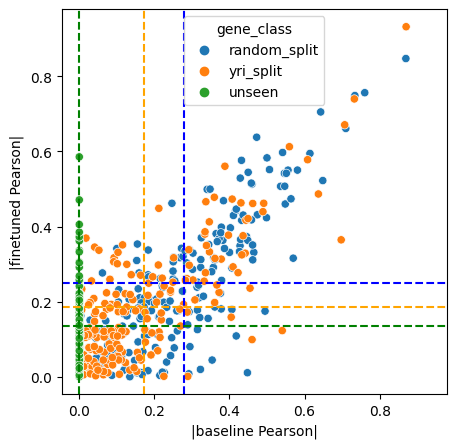

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.2


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

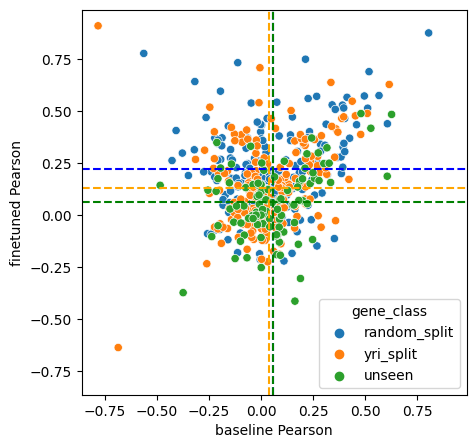

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.24074278131754936

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17605850373463924

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1380328284573469



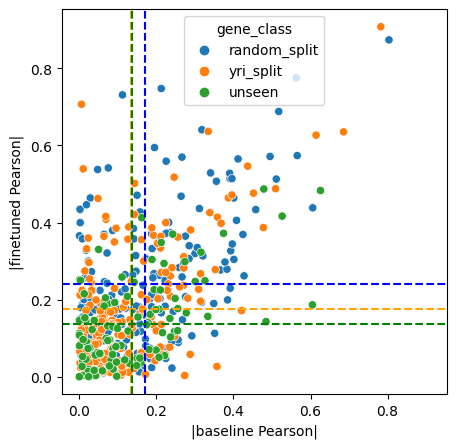

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2194924947674339

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.12957589243313555

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.06275685583542571



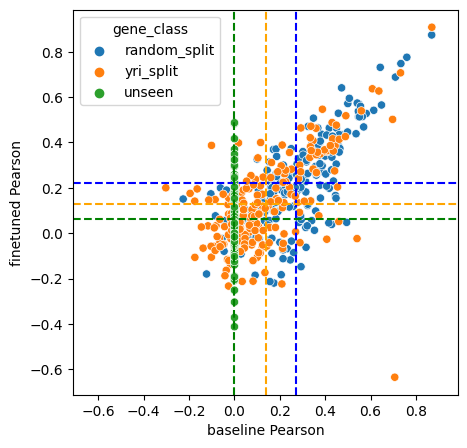

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.24074278131754936

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17605850373463924

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1380328284573469



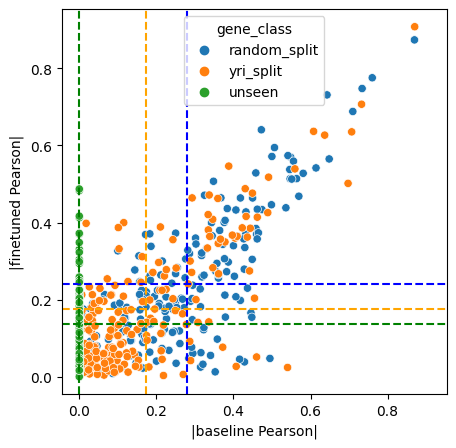

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.4


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

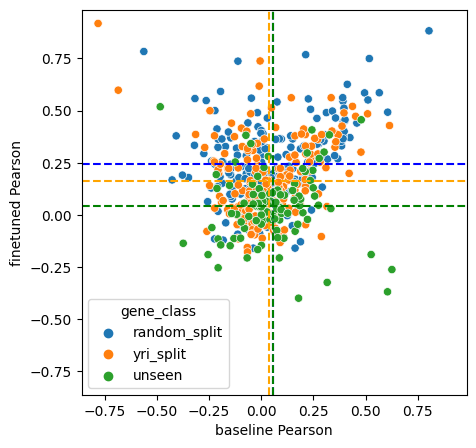

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.25828740489765495

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18489416826622332

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12709388423693077



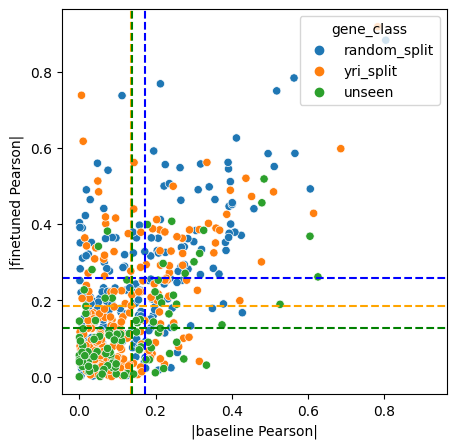

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2439364459904011

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16142662252563106

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04164827871455271



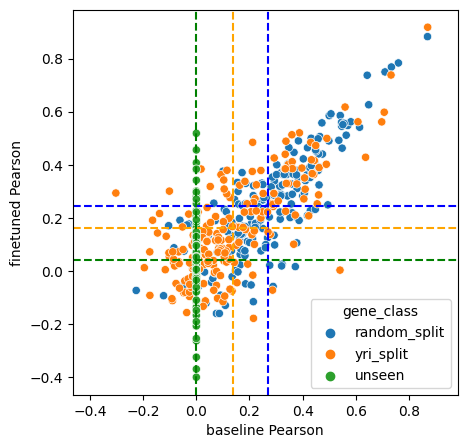

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.25828740489765495

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18489416826622332

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12709388423693077



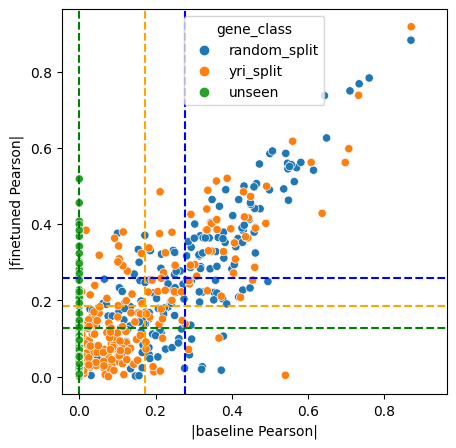

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.6


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

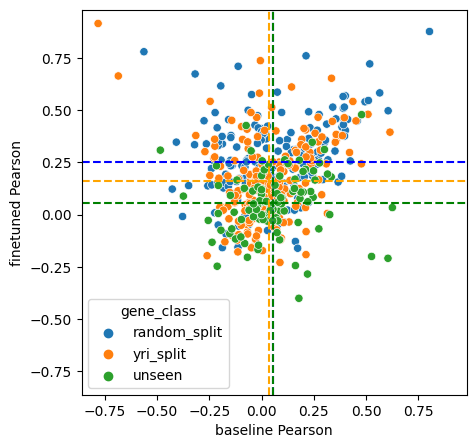

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.26496753725851163

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19341550910578442

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12377609815009466



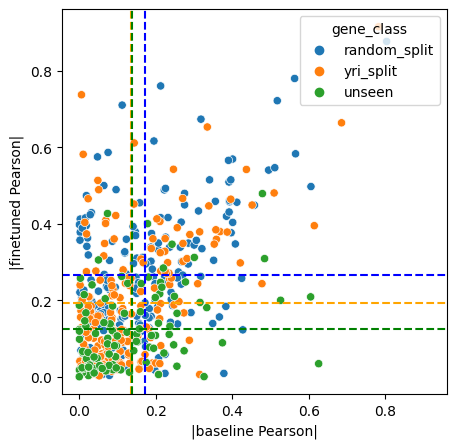

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2529905260159463

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1607514267915123

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.05618795300624433



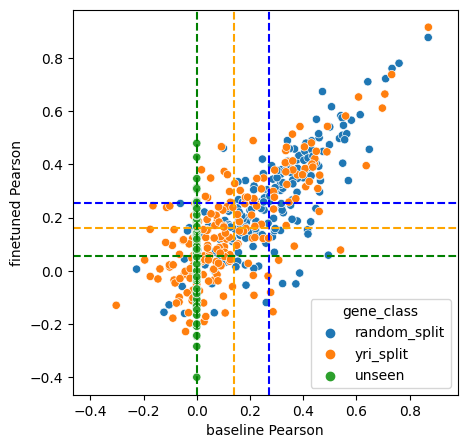

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.26496753725851163

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19341550910578442

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12377609815009466



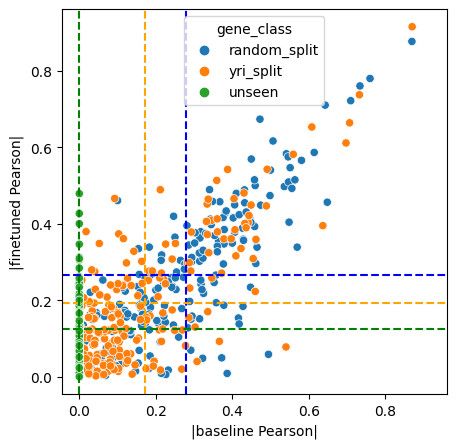

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.8


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

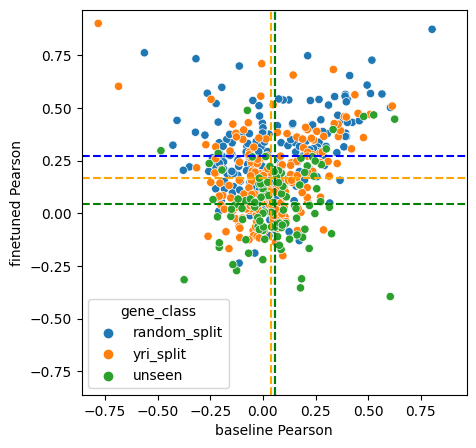

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2831381418807656

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18821087320512245

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1413147182608137



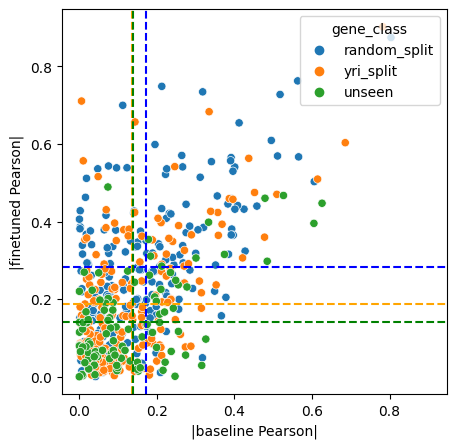

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2725543124645612

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16551322239244104

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04651620994888435



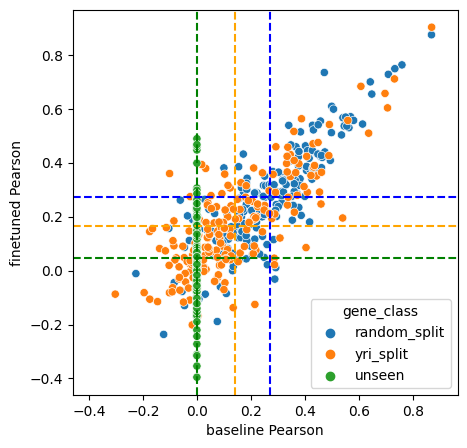

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2831381418807656

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18821087320512245

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1413147182608137



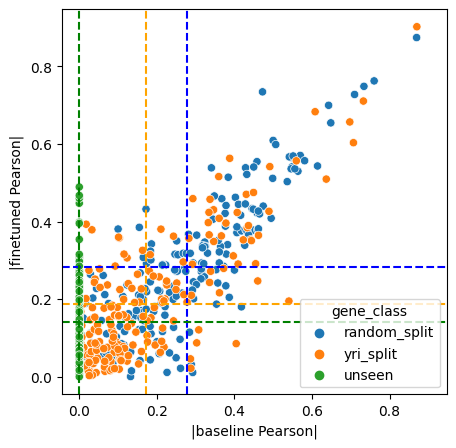

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.2


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

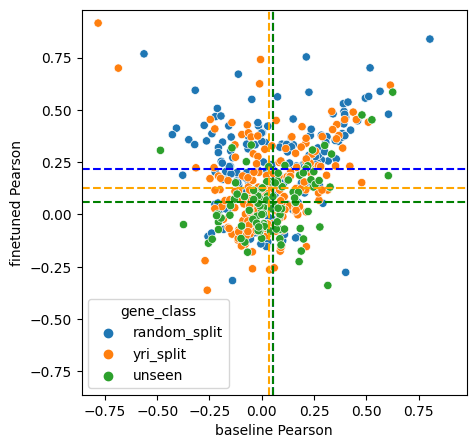

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.24368341902736637

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17169469947039723

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12300430870947687



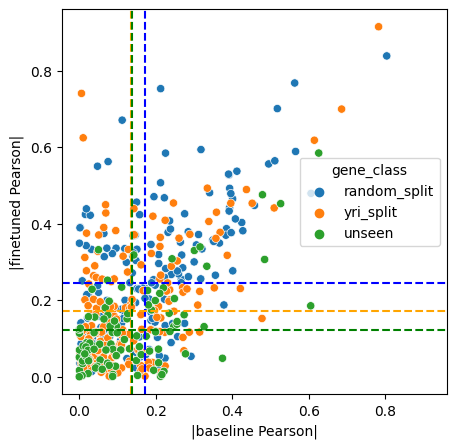

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2191118958713985

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.12573577423046622

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.06095453488493884



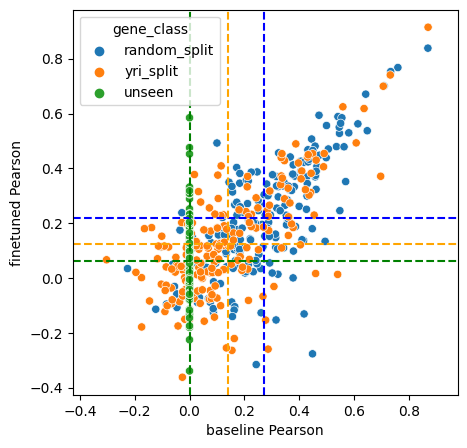

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.24368341902736637

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17169469947039723

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12300430870947687



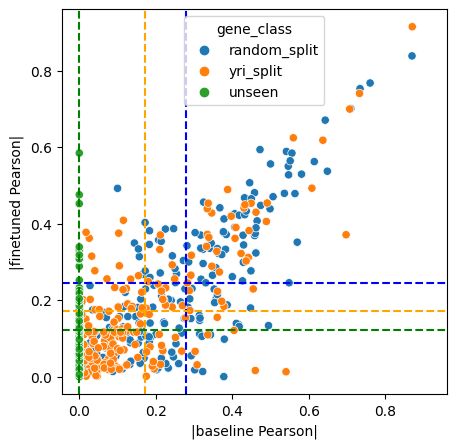

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.4


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

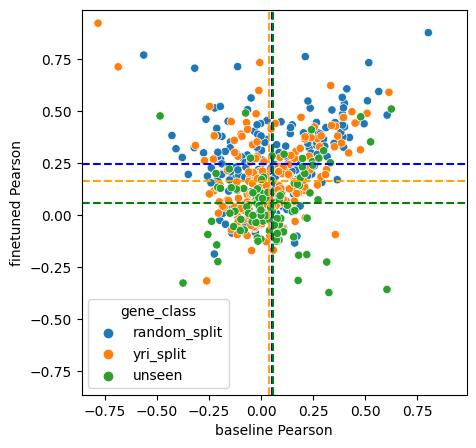

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2610232917483939

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18453206356951327

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13873661595807532



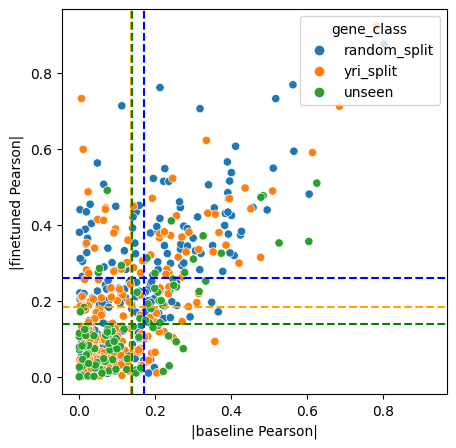

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.24849989524622948

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16269715671950225

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.0568013174354732



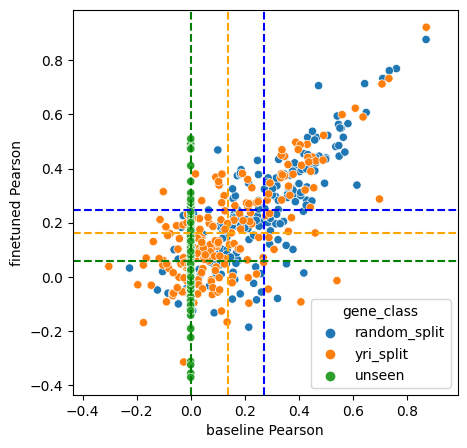

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2610232917483939

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18453206356951327

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13873661595807532



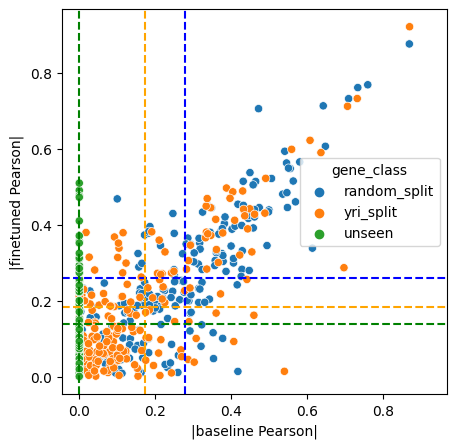

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.6


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

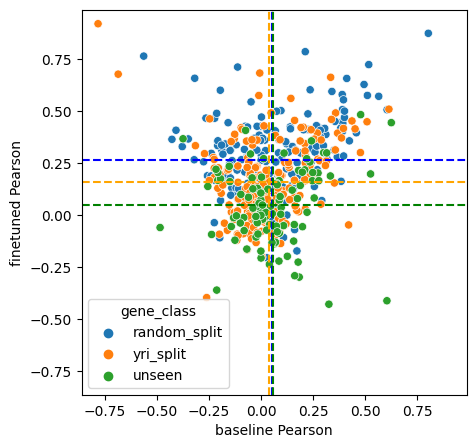

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2749648073986949

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1897054134086758

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1470465727452451



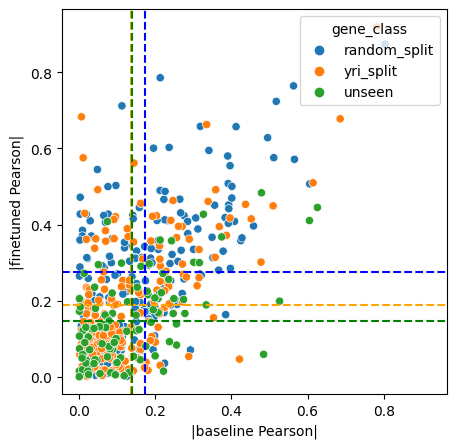

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.26500893215987475

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.158483808914809

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04779871787326484



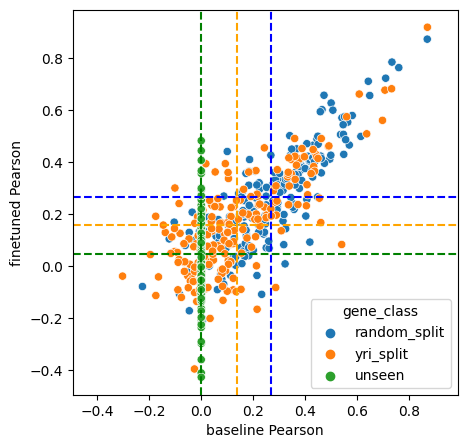

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2749648073986949

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1897054134086758

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1470465727452451



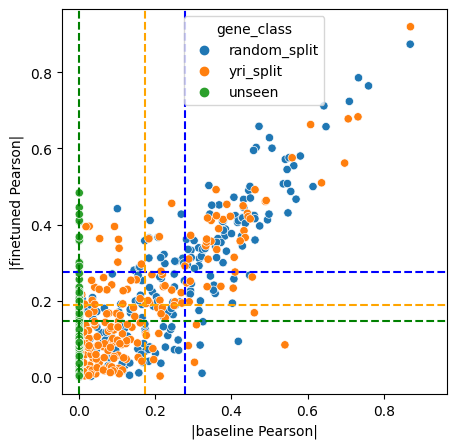

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.8


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

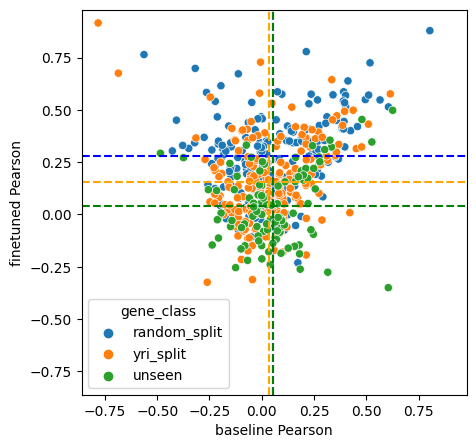

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2877614111811109

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18945083987302389

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.14328104044449272



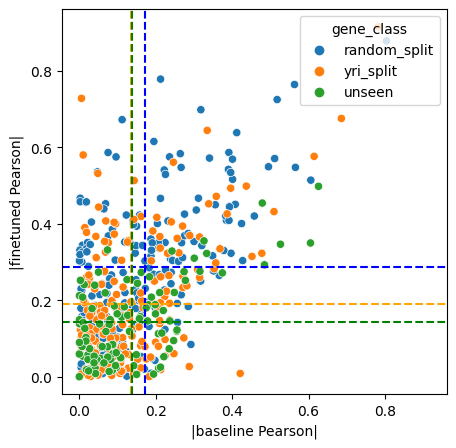

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2801776310375932

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1572554629551027

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.03925811496918225



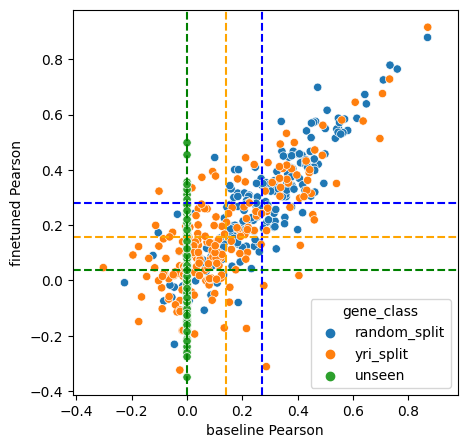

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2877614111811109

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18945083987302389

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.14328104044449272



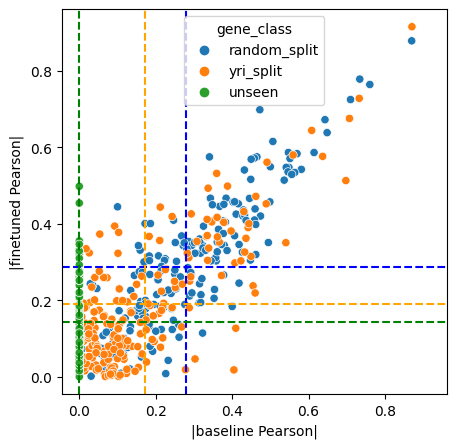

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.2


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

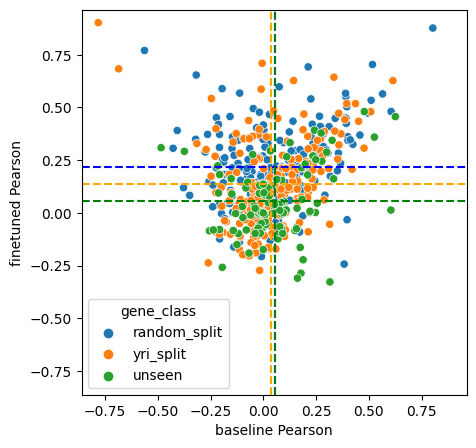

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2359602746004545

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1822667221054209

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1305674332515242



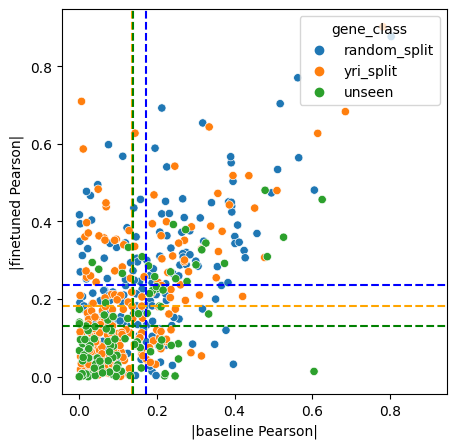

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.21715206279071034

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.13519956128534052

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.055887270186104336



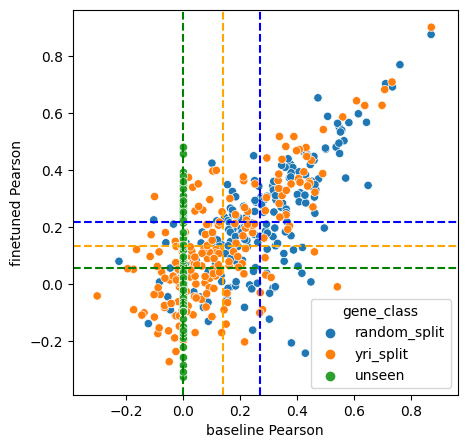

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2359602746004545

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1822667221054209

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1305674332515242



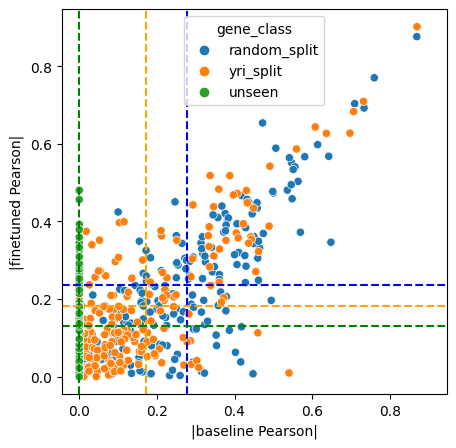

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.4


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

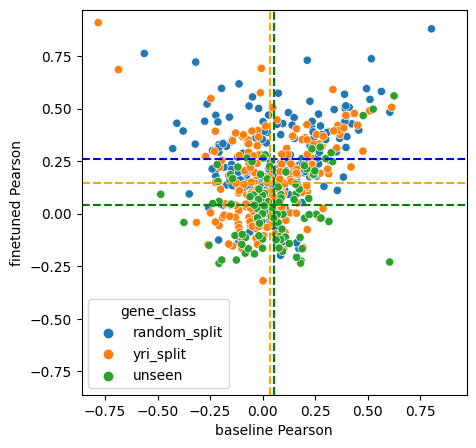

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2719750996262057

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18076941122282722

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13473743343298003



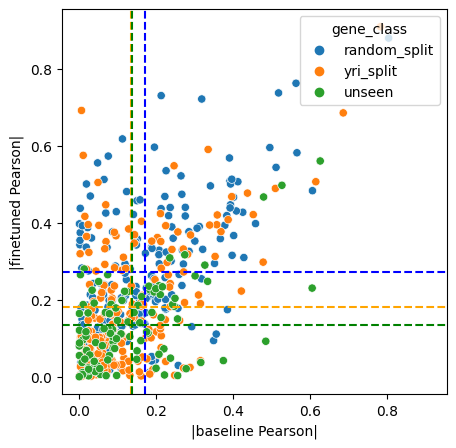

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2589452688463845

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1476402613679841

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.040211138901190234



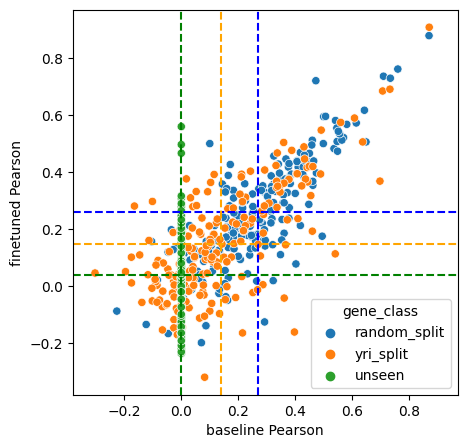

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2719750996262057

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18076941122282722

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13473743343298003



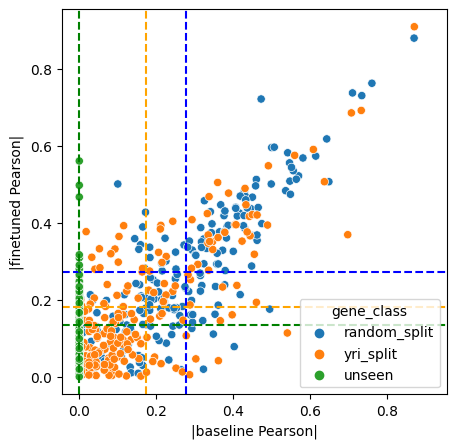

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.6


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

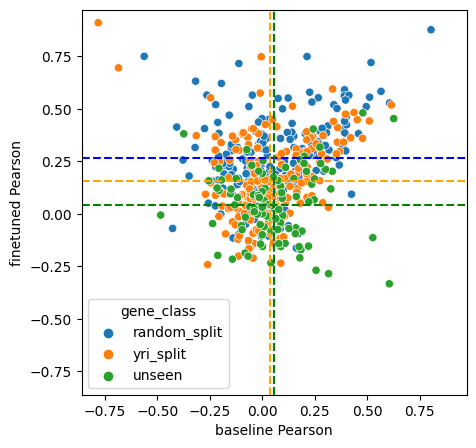

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2800619936673957

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1894934670347071

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13307994413509427



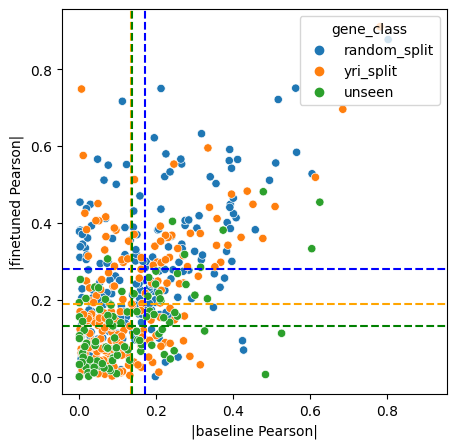

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.26773706102673805

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1564800506162614

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04176218867571582



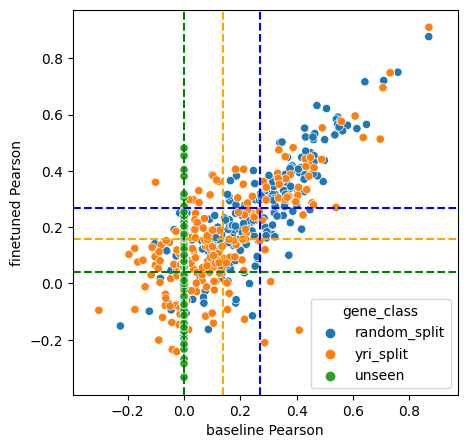

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2800619936673957

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1894934670347071

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13307994413509427



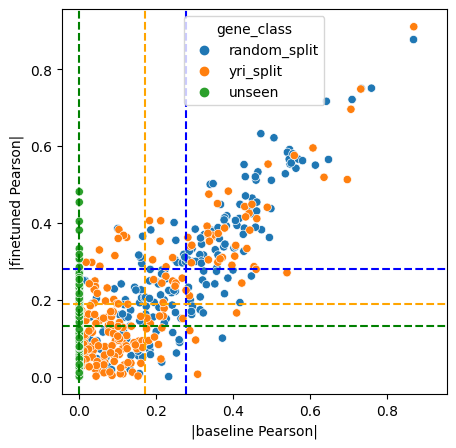

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_subsample_ratio_0.8


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

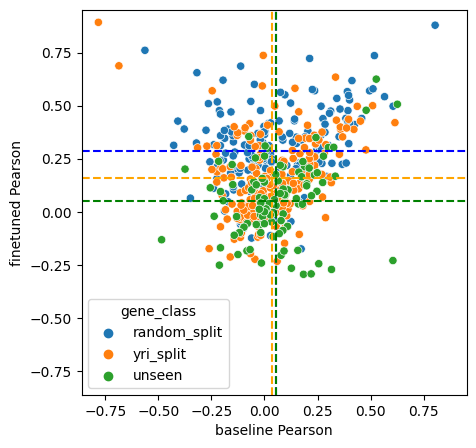

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.29351367502453335

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1883906404824449

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.14742564004799624



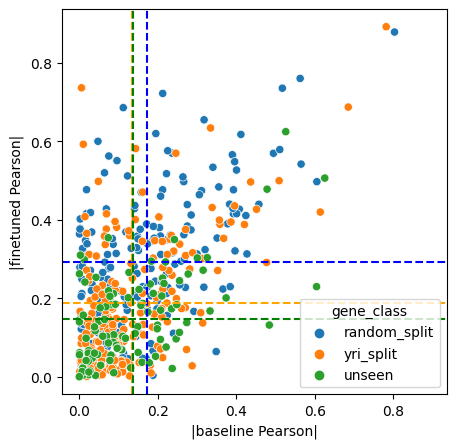

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2854569820950987

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.159868237912547

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.051528446330076146



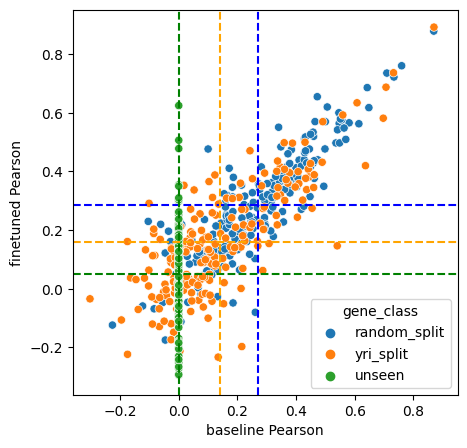

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.29351367502453335

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1883906404824449

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.14742564004799624



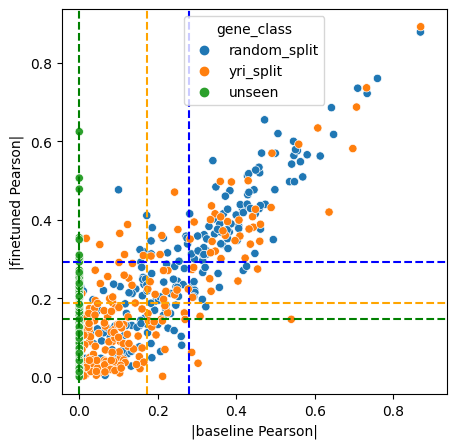

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.01


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

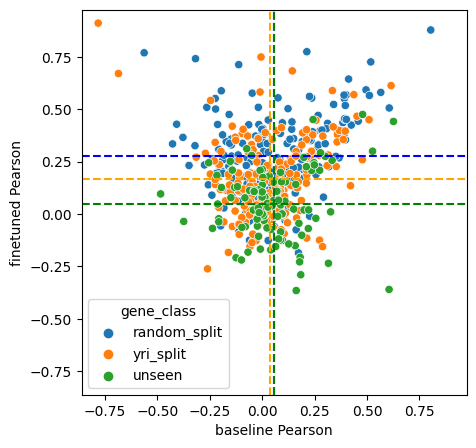

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2887766072664779

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19195655688032764

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



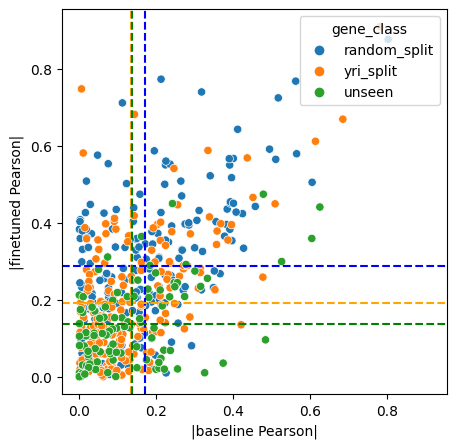

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.27840202007085735

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16538967501947532

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



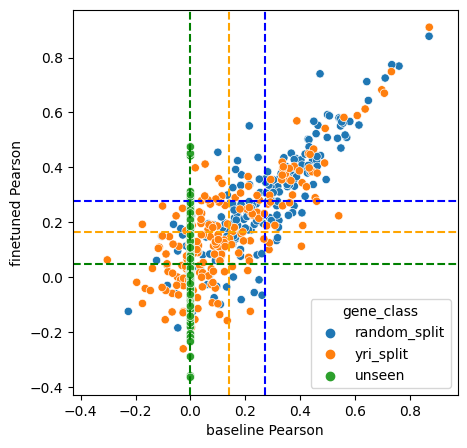

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2887766072664779

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19195655688032764

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



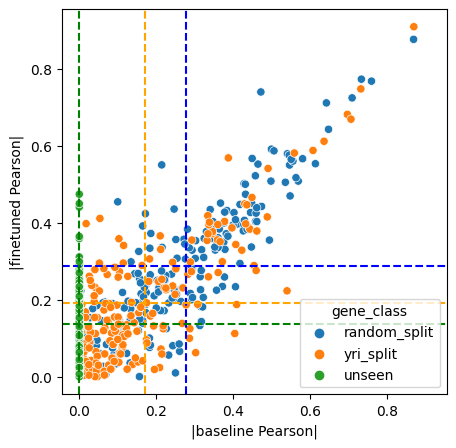

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.02


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

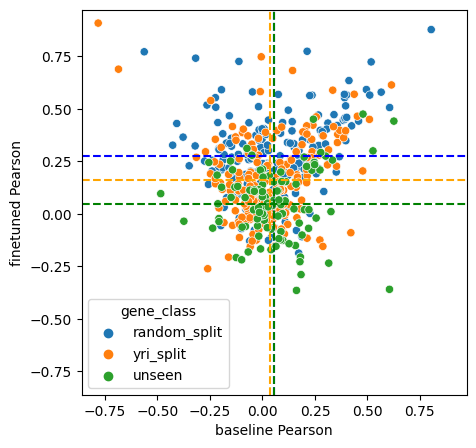

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28841788038314586

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19266472299702456

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



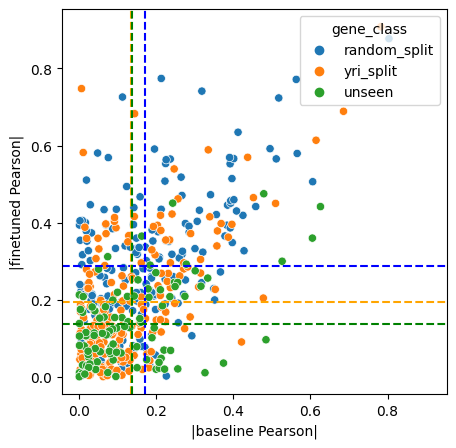

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2771850339523575

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16272435833616583

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



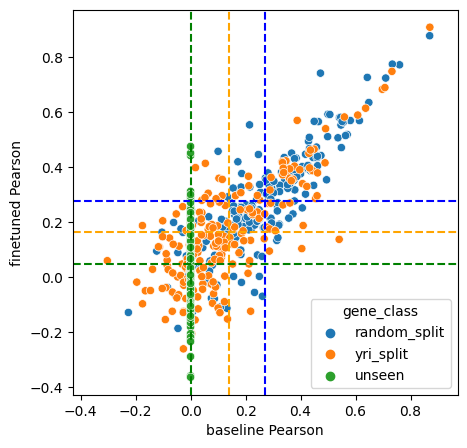

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28841788038314586

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19266472299702456

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



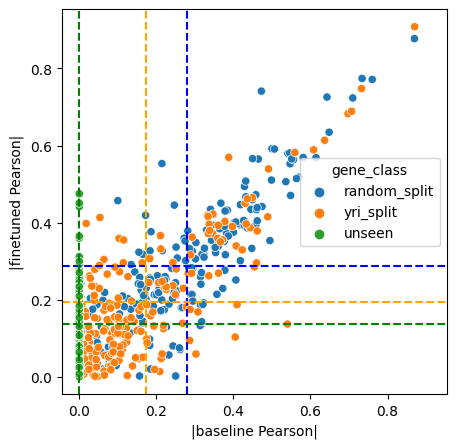

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.03


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

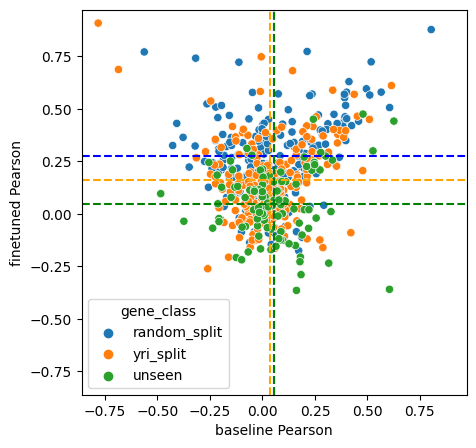

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28579472385870786

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19251280022546818

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



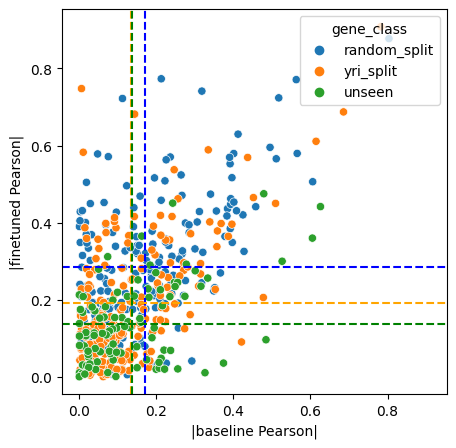

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.27346739862760416

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1611797662843982

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



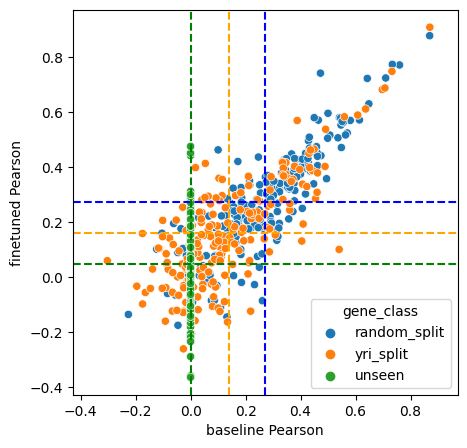

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28579472385870786

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19251280022546818

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



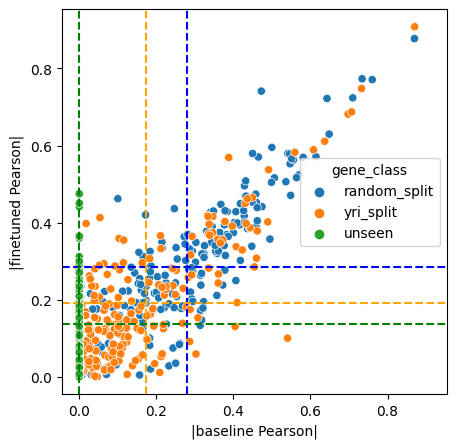

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.04


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

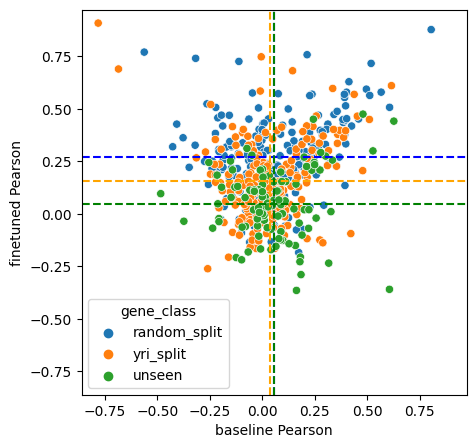

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28349613665412554

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1906643078748525

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



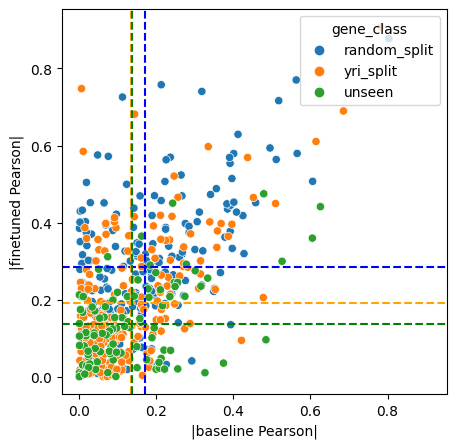

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2723554947975074

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1582893247971728

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



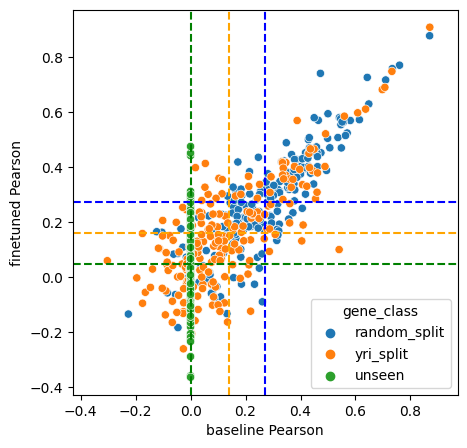

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28349613665412554

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1906643078748525

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



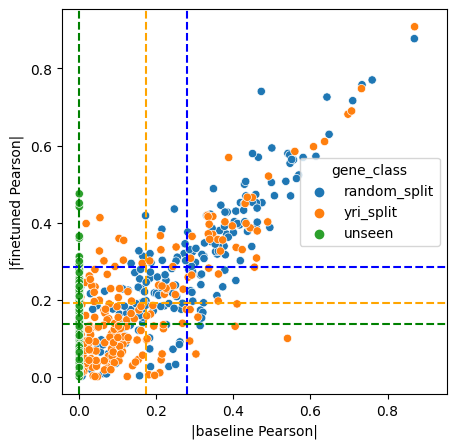

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.05


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

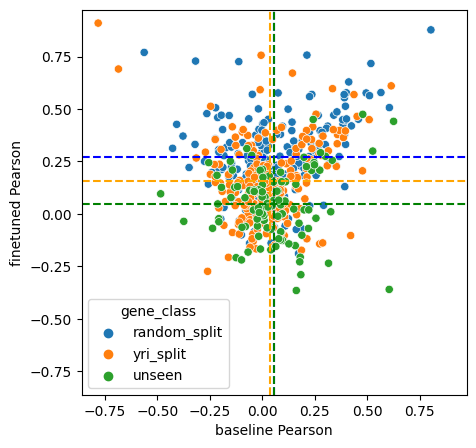

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2814317397573173

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19150020136728765

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



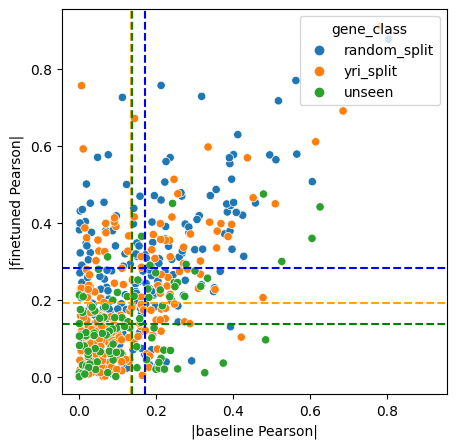

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.26964708303282636

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.15717237861513256

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



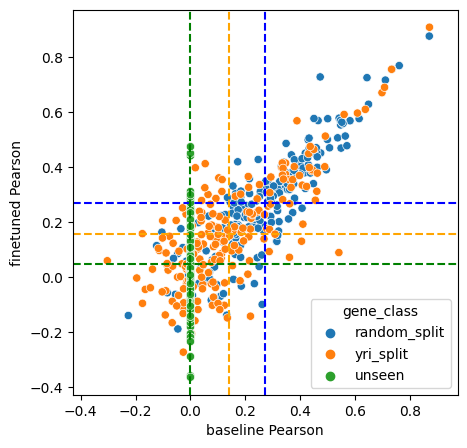

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2814317397573173

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19150020136728765

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



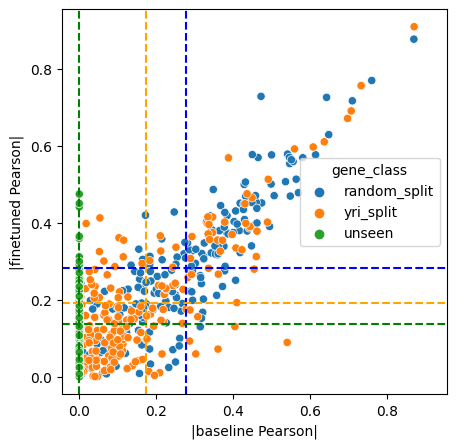

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.06


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

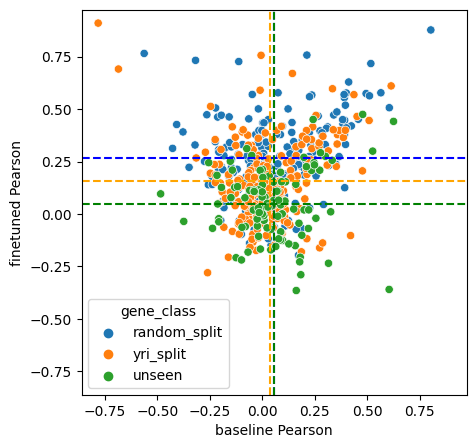

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2778033056022165

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19254898867626521

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



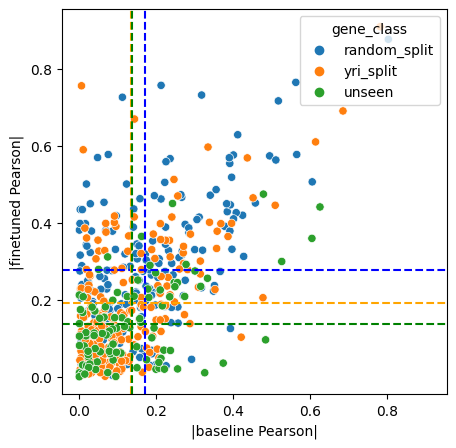

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2647659161749631

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.15804507857899697

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



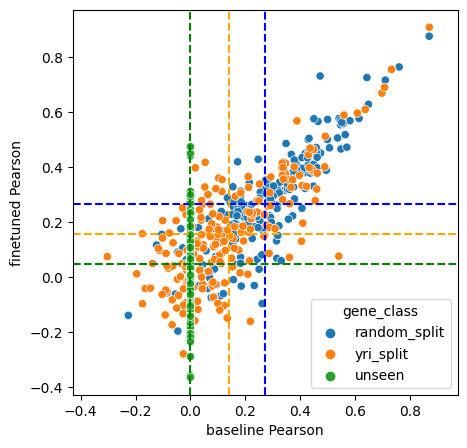

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2778033056022165

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19254898867626521

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



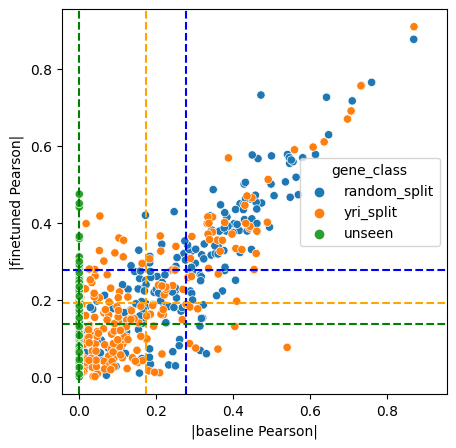

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.07


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

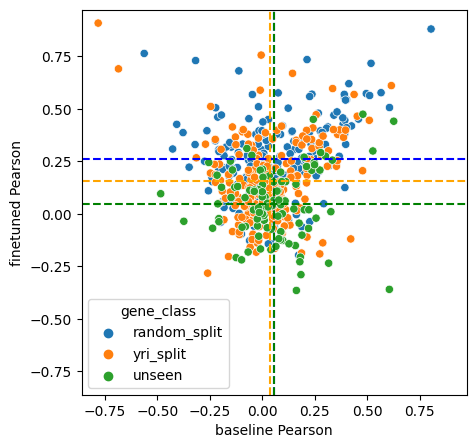

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.27451807777315984

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1934249458777351

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



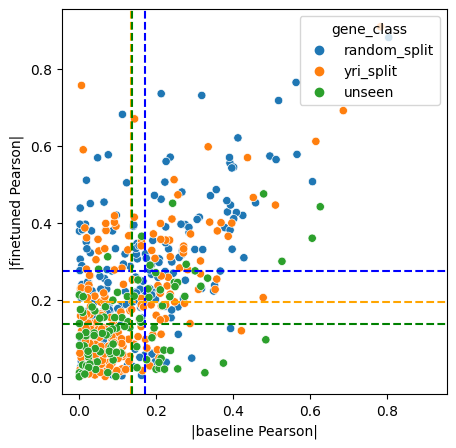

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.26169496589564534

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.15656109125802506

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



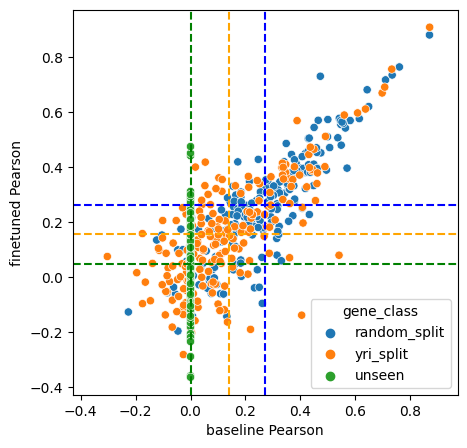

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.27451807777315984

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1934249458777351

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



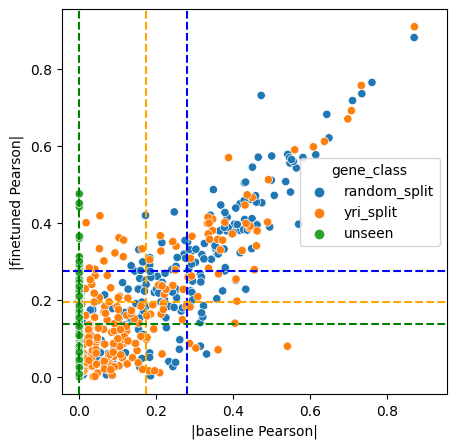

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.08


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

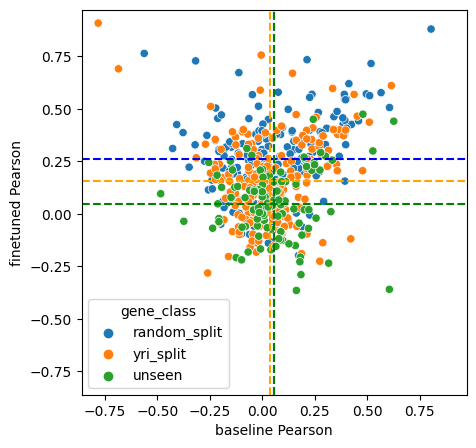

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2727379398689315

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19449718369251065

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



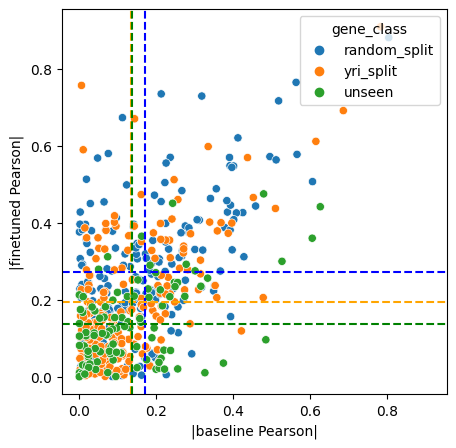

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2605230819579443

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.15535449924858694

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



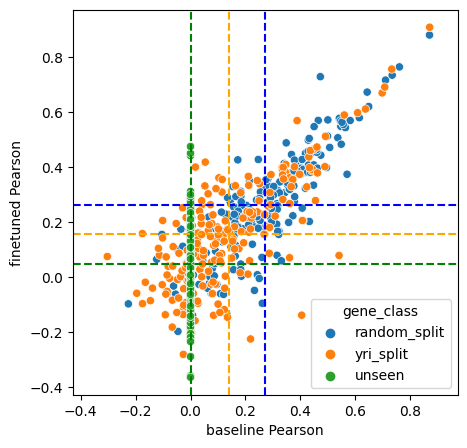

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2727379398689315

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19449718369251065

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



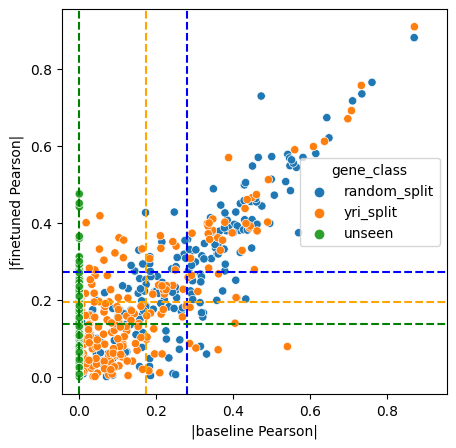

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.09


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

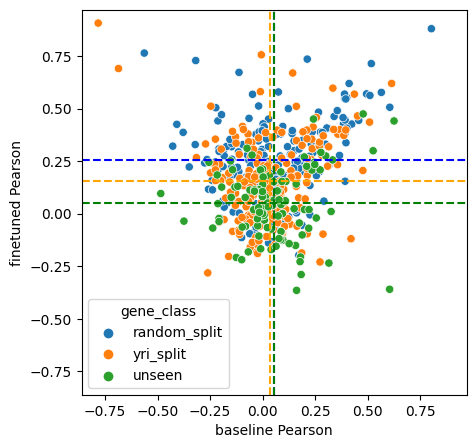

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.26921018293571186

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1946786493886882

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



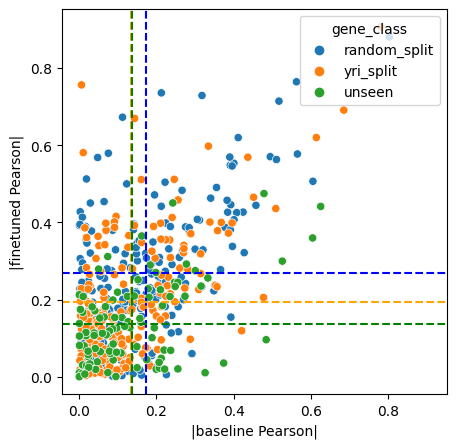

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.25704042347372924

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.15570206457779256

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



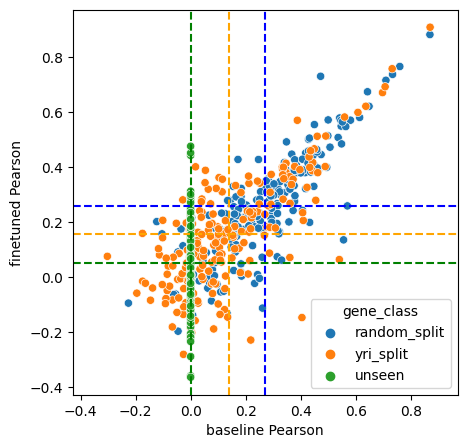

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.26921018293571186

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1946786493886882

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



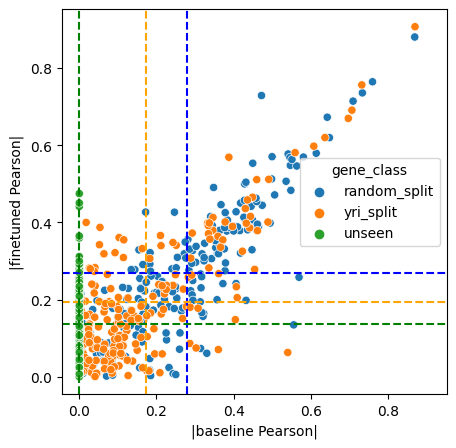

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.1


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

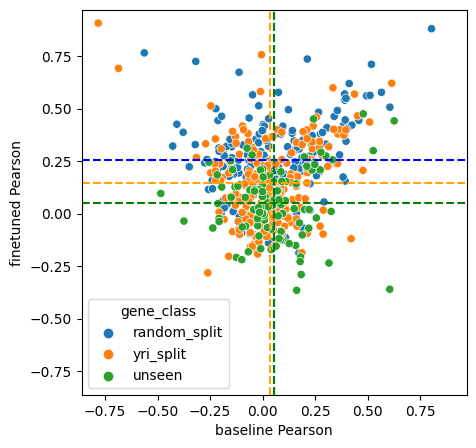

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2666482630917009

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18551353696079828

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



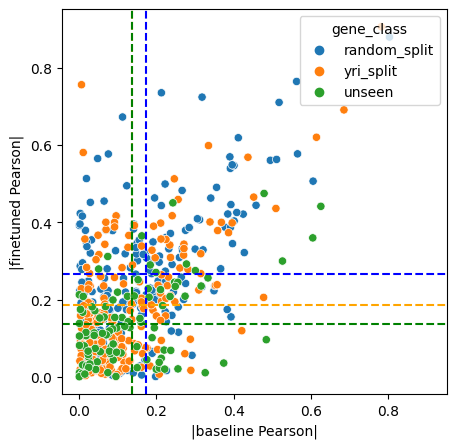

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.25354654956545863

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.14620700282445573

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



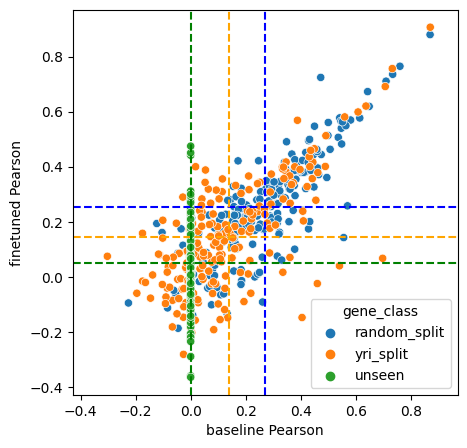

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2666482630917009

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18551353696079828

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



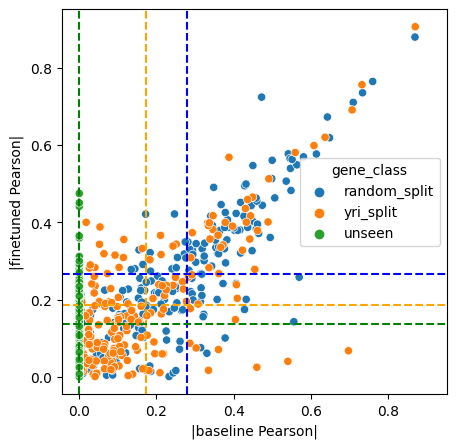

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.15


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

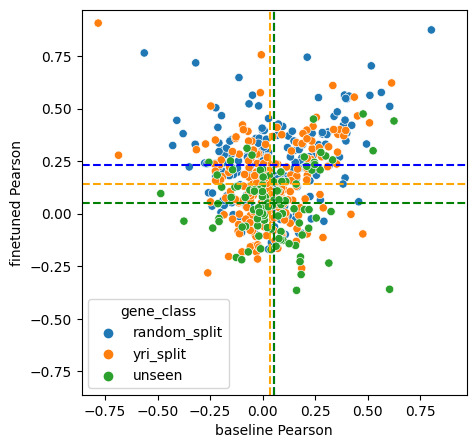

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2477490936590469

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18295119233902787

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



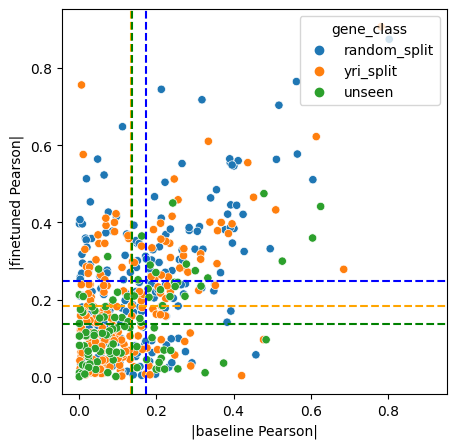

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.23410070145165668

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1411650531220986

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



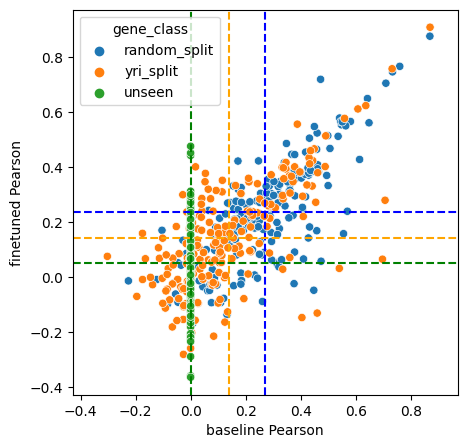

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2477490936590469

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18295119233902787

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



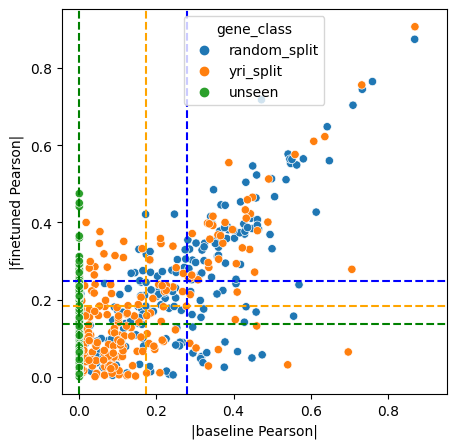

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.2


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

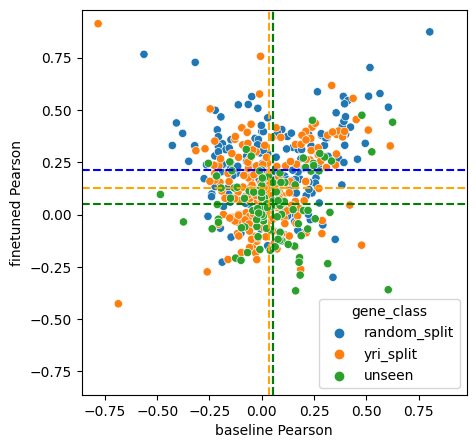

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2360595186547106

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17769879455790089

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



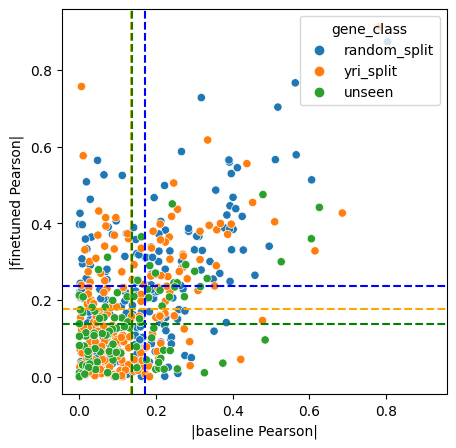

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2142744410610606

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.12914885639143645

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



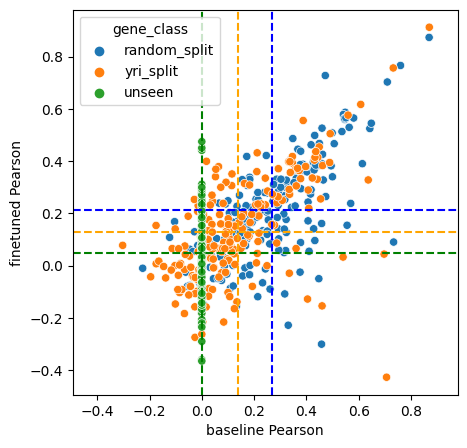

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2360595186547106

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17769879455790089

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



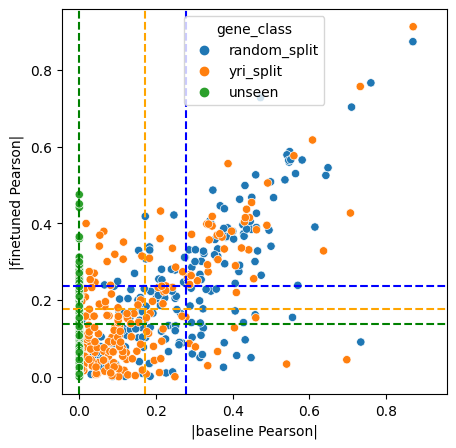

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.25


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

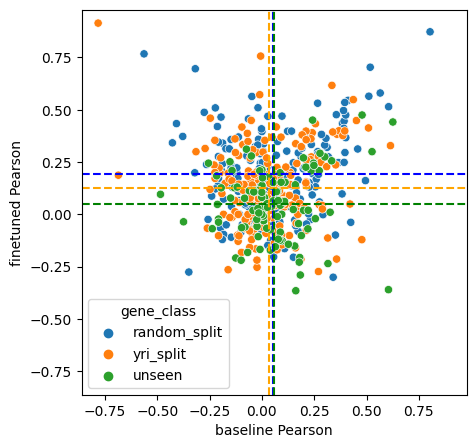

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.22537631564168806

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1763942855019709

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



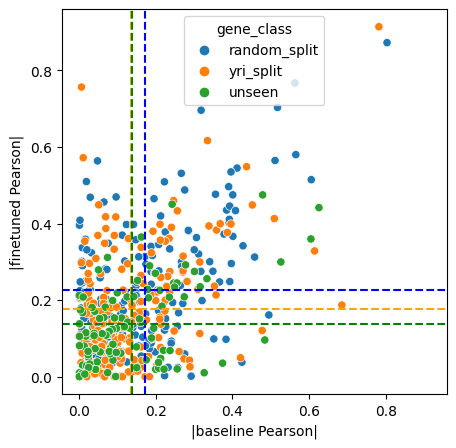

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.19461176329129734

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.12648336432317805

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



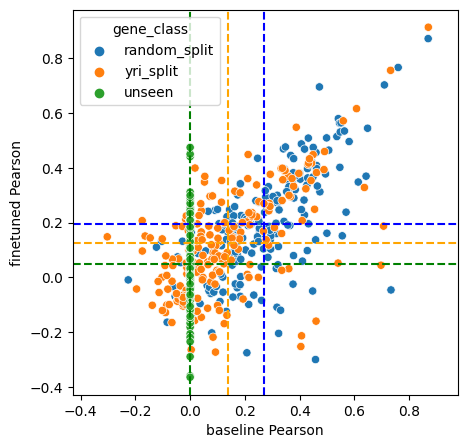

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.22537631564168806

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1763942855019709

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



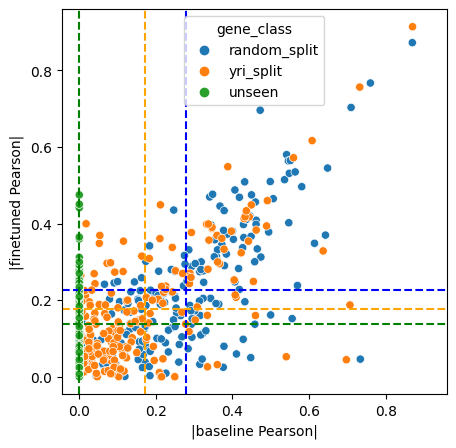

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

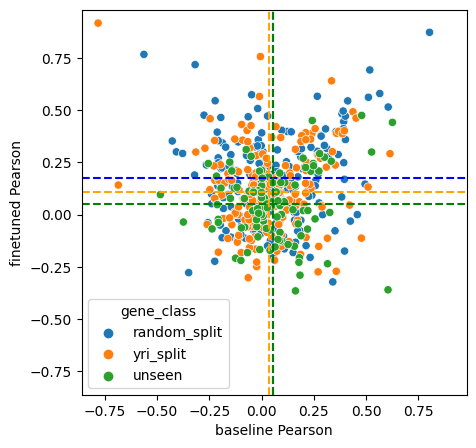

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.21520757821149655

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.16588262069376358

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



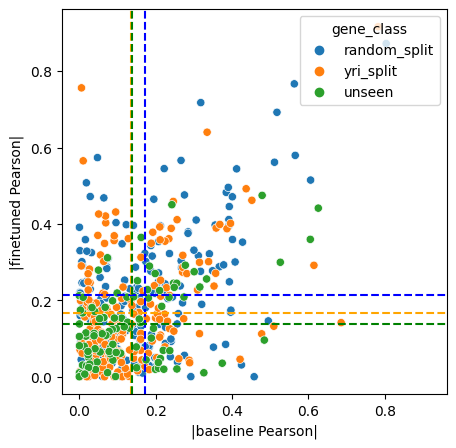

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.17523296967536503

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.10994272382792492

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



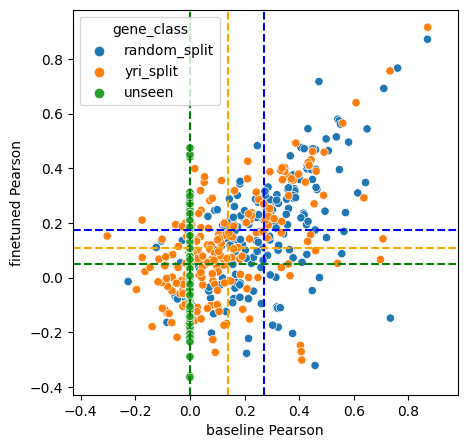

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.21520757821149655

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.16588262069376358

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



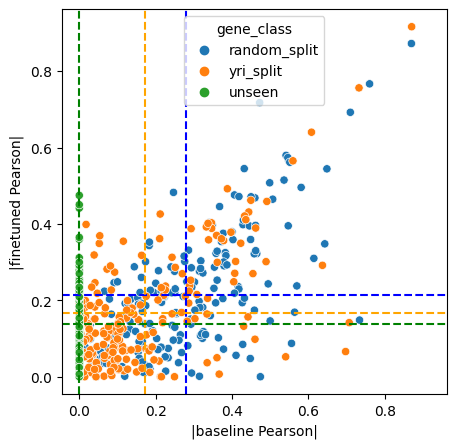

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.35


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

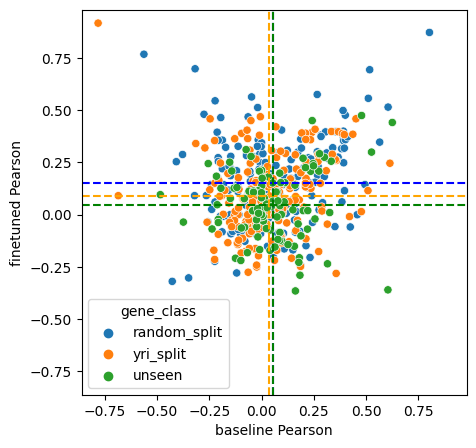

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.19819974592226672

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.15341567322001584

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



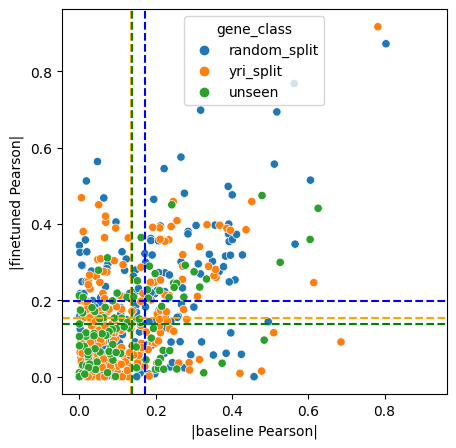

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.14993312669919479

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.09157402798562955

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



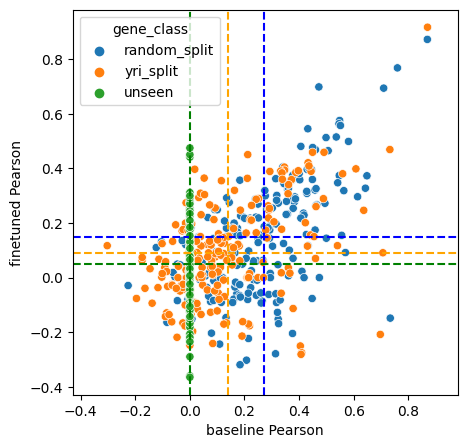

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.19819974592226672

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.15341567322001584

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



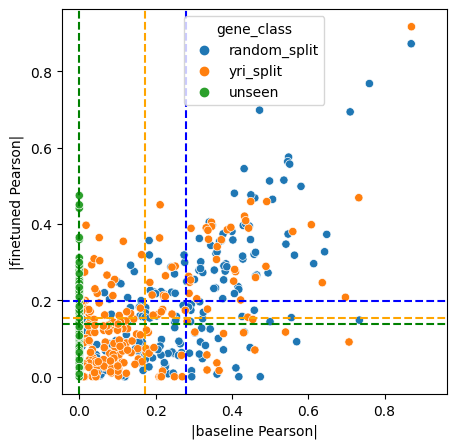

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.4


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene tmem163 has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

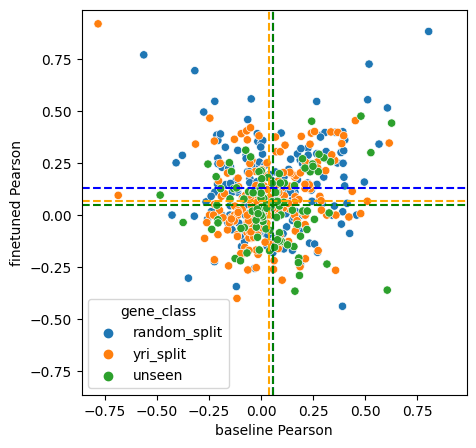

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.18044874616830517

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1373462762486659

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



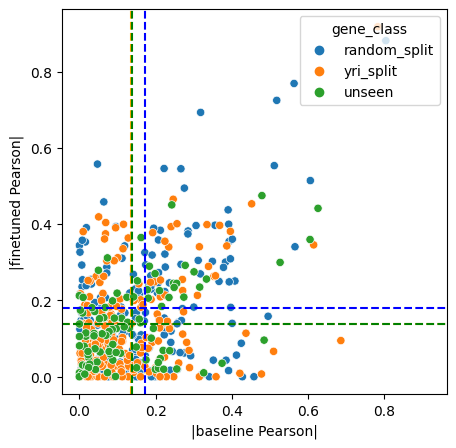

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.12838081194984155

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.069746236264514

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



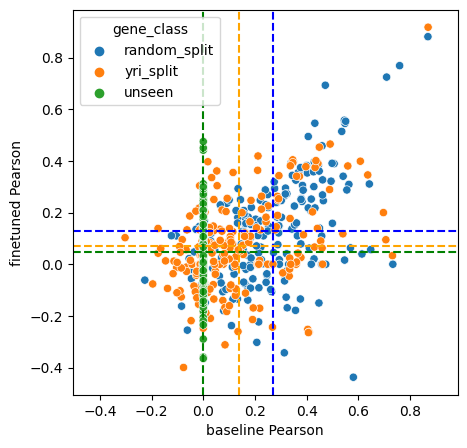

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.18044874616830517

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1373462762486659

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



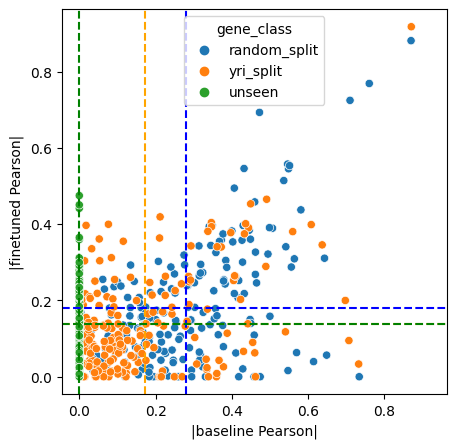

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.41


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene yipf5 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem163 has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

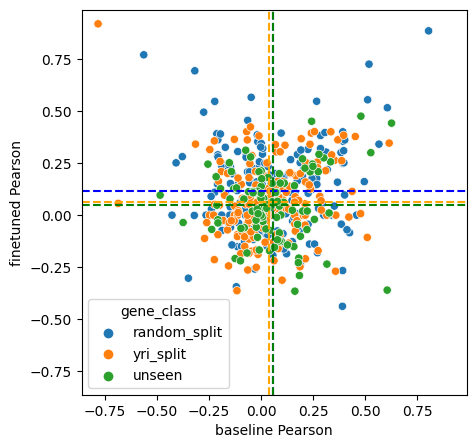

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.173739086984186

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.13168736634791453

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



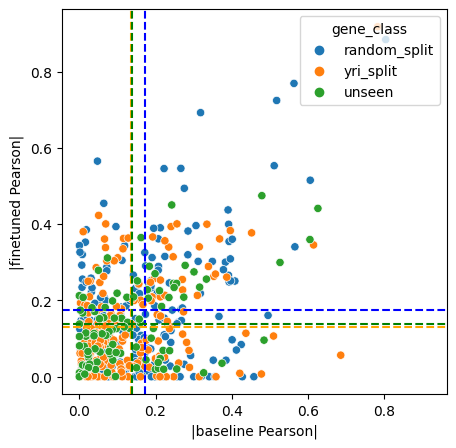

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.11814440957334878

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.06322015422954243

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



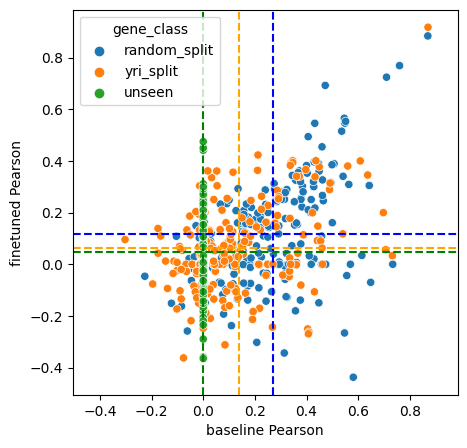

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.173739086984186

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.13168736634791453

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



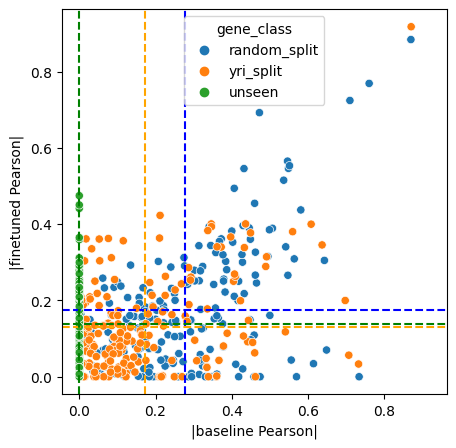

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.42


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR
Gene borcs7 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000232116 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene yipf5 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem163 has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

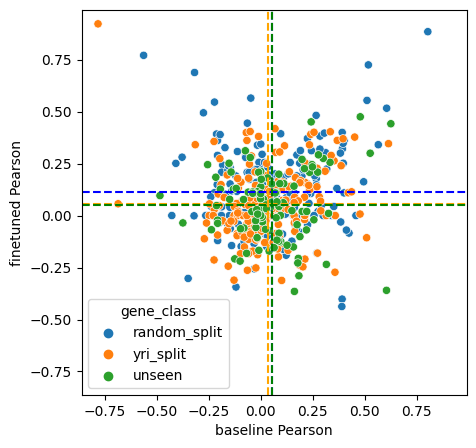

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.16658905000630425

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.12653745233476882

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



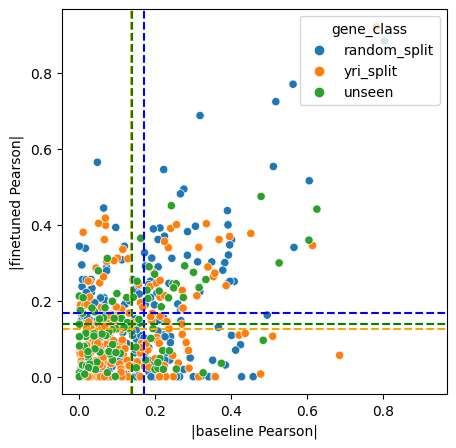

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.11265508774583526

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.054654447442466766

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



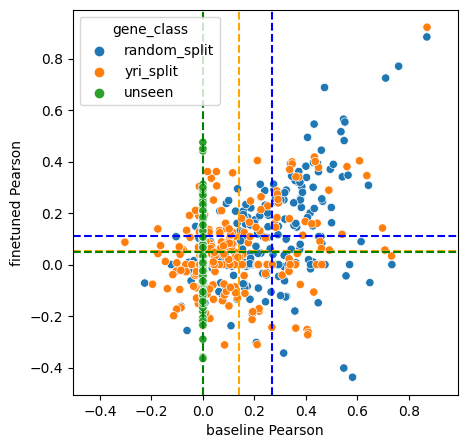

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.16658905000630425

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.12653745233476882

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



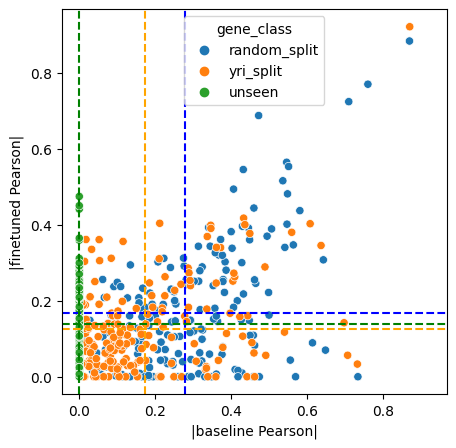

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.43


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR
Gene borcs7 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000232116 has invalid predictions/counts and thus has a nan 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene adk has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene tctn2 has invalid predictions/counts and thus has a nan pearsonR
Gene yipf5 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem1

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

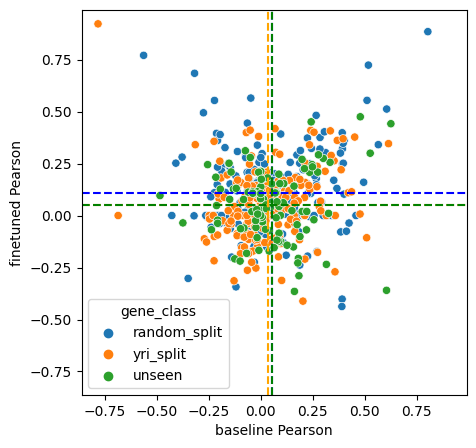

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.16263501984325757

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.12301939510704823

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



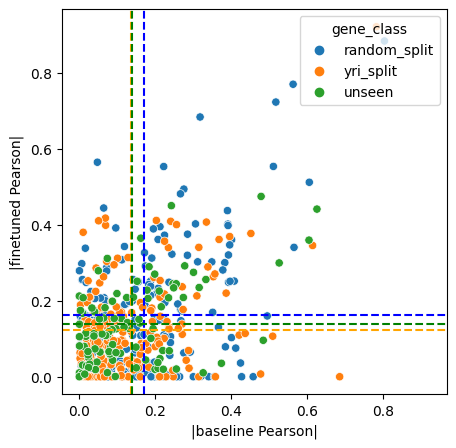

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.10841468634299488

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.04930117016931604

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



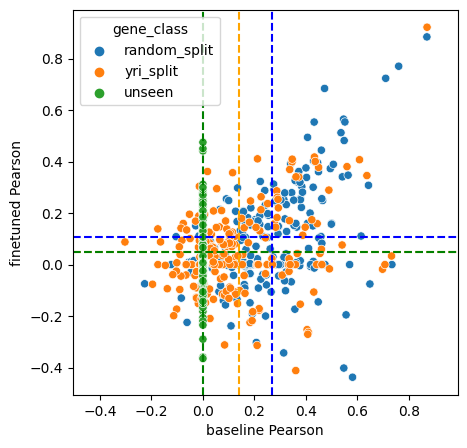

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.16263501984325757

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.12301939510704823

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



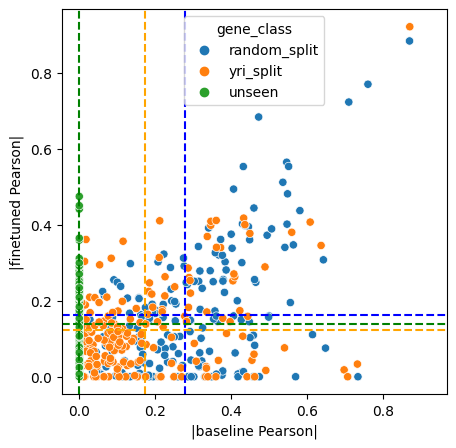

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.44


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene cdc42bpa has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR
Gene borcs7 has invalid predictions/counts and thus has a nan pearson

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearsonR
Gene ftcdnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene adk has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene e

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR
Gene hyal4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

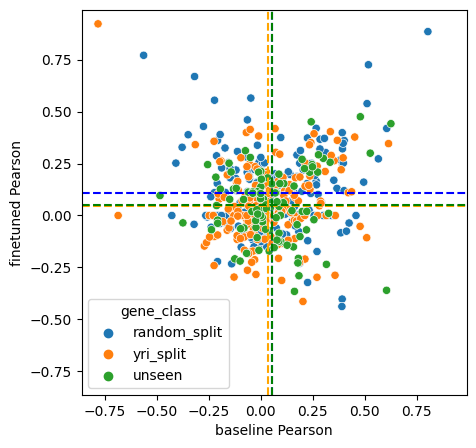

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.1617699412958816

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1216036327243266

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



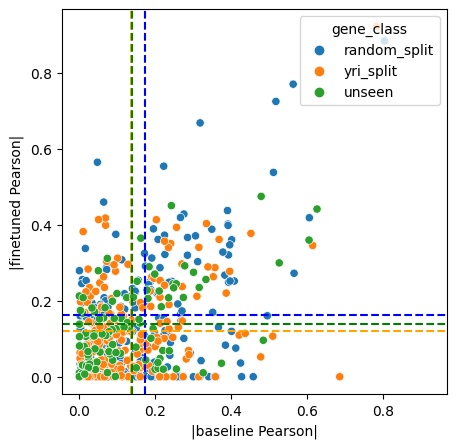

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.10757536838261704

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.0459408802602181

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



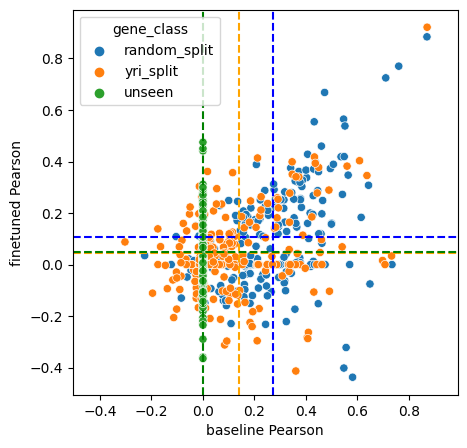

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.1617699412958816

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1216036327243266

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



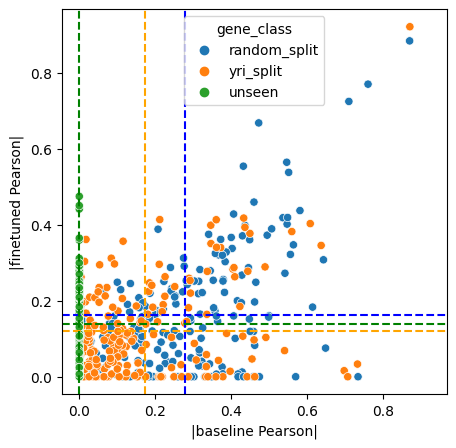

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.45


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene foxred1 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene ra

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene etv2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf283 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
Gene kptn has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
G

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rps14 has invalid predictions/counts and thus has a nan pearsonR
Gene rab33b has invalid predictions/counts and thus has a nan pearsonR
Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearsonR
Gene ftcdnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearson

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene mttp has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR
Gene arhgef35 has invalid predictions/counts and thus has a nan pearsonR
Ge

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

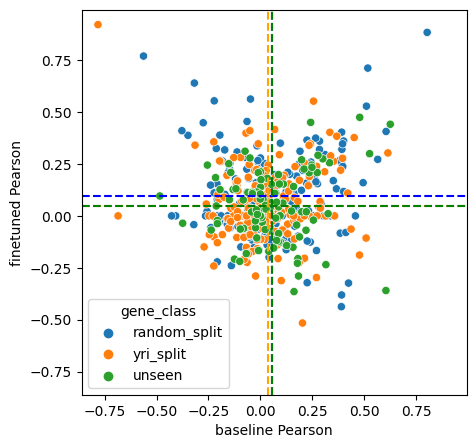

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.15564108530259801

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.11579741702892703

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



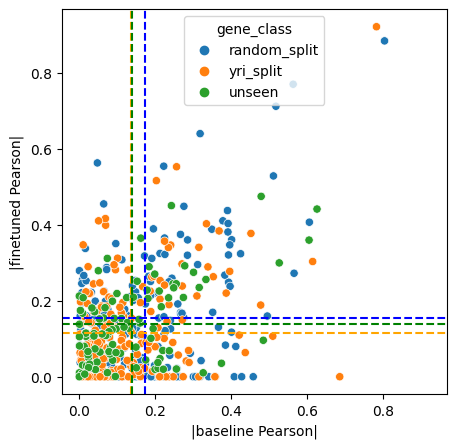

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.09714100290381474

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.048074806717751654

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



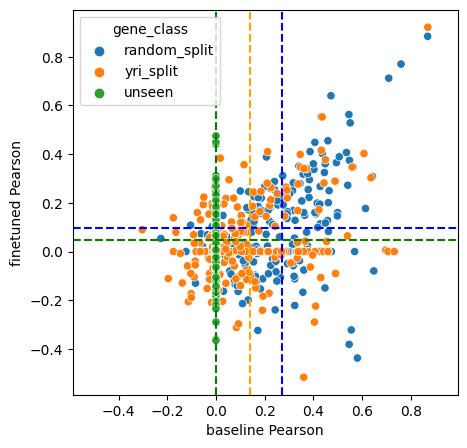

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.15564108530259801

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.11579741702892703

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



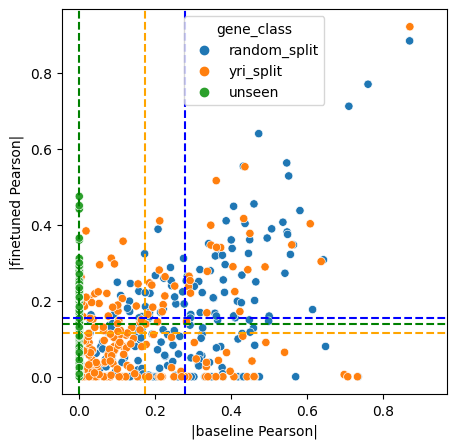

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.46


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene ap4b1 has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap35 has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene ighmbp2 has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene foxred1 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo h

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene etv2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf283 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
Gene kptn has invalid predictions/counts and thus has a nan pearsonR
Gene glul has invalid predictions/counts and thus has a nan pearsonR
Ge

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rps14 has invalid predictions/counts and thus has a nan pearsonR
Gene linc01006 has invalid predictions/counts and thus has a nan pearsonR
Gene rab33b has invalid predictions/counts and thus has a nan pearsonR
Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4m1 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearso

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene mttp has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene itgb1 has invalid predictions/counts and thus has a nan pearsonR
Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bbs12 has invalid predictions/counts and thus has a nan pearsonR
Gene nelfb has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene rnf

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

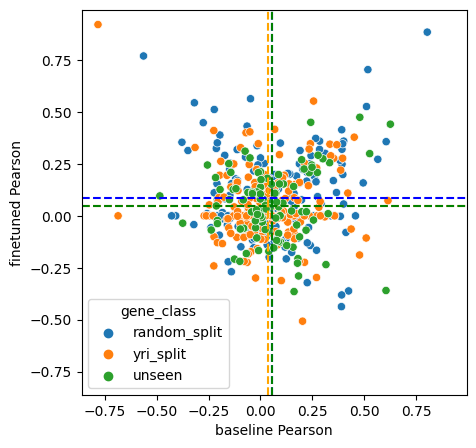

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.14439516476043635

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.10853608396603802

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



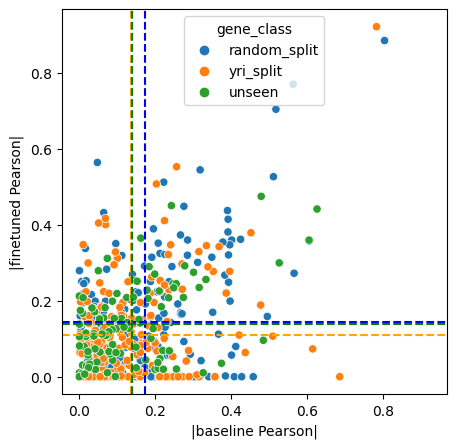

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.08432895863491709

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.046896987743577

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



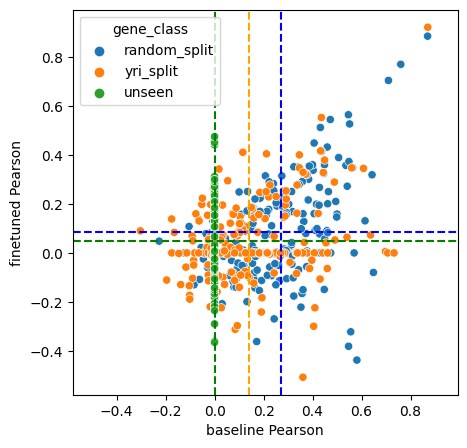

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.14439516476043635

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.10853608396603802

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



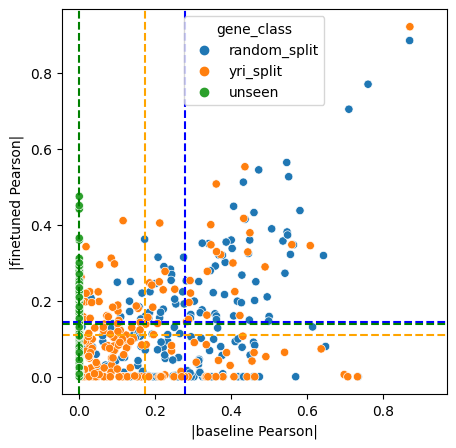

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.47
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene colca2 has invalid predictions/counts and thus has a nan pearsonR
Gene sdccag8 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4b1 has invalid predictions/counts and thus has a nan pearsonR
Gene rnf43 has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap35 has invalid predictions/counts and thus has a nan pearsonR
Gene sdhaf4 has invalid predictions/counts and thus has a nan pearsonR
Gene smtnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene ighmbp2 has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene fox

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene cenpq has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene ppan has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
Gene kptn has invalid predictions/counts and thus has a nan pearsonR
Gene pdss2 has invalid predictions/counts and thus has a nan pearsonR
Gene glul has invalid predictions/counts and thus has a nan pearsonR
Gene gtpbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene tmtc4 has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4m1 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearsonR
Gene ftcdnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene adk has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gen

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene ptbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bbs12 has invalid predictions/counts and thus has a nan pearsonR
Gene nelfb has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene rnf168 has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

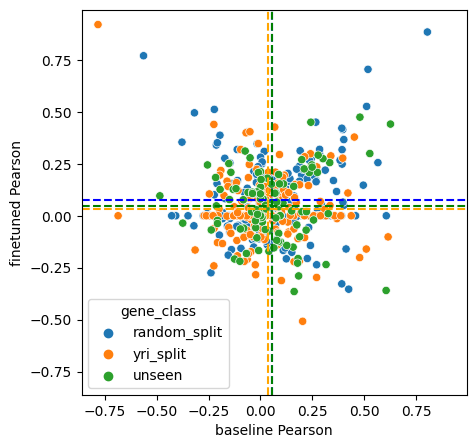

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.12895260089561217

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.09314796849973274

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



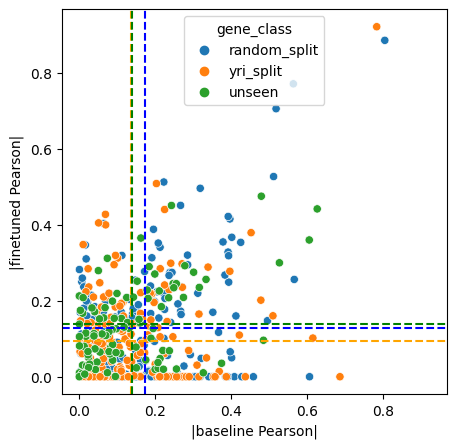

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.07590590063890203

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.030327852422817114

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



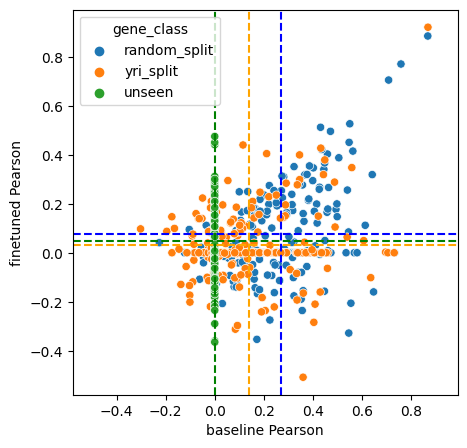

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.12895260089561217

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.09314796849973274

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



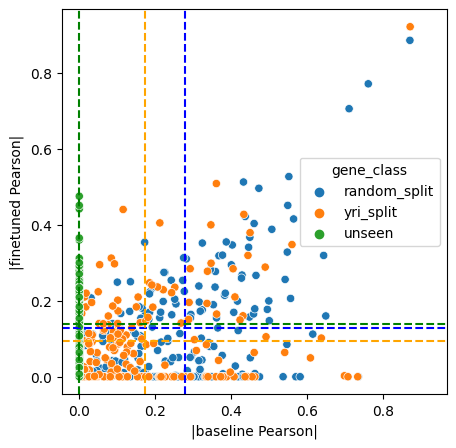

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.48


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene svbp has invalid predictions/counts and thus has a nan pearsonR
Gene exosc5 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene cd58 has invalid predictions/counts and thus has a nan pearsonR
Gene yif1a has invalid predictions/counts and thus has a nan pearsonR
Gene mag has invalid predictions/counts and thus has a nan pearsonR
Gene colca2 has invalid predictions/counts and thus has a nan pearsonR
Gene sdccag8 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4b1 has invalid predictions/counts and thus has a nan pearsonR
Gene rnf43 has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has inva

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene etv2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf283 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene mthfr has invalid predictions/counts and thus has a nan pearsonR
Gene dmac2 has invalid predictions/counts and thus has a nan pearsonR
Gene cenpq has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene linc01006 has invalid predictions/counts and thus has a nan pearsonR
Gene cox17 has invalid predictions/counts and thus has a nan pearsonR
Gene thumpd3 has invalid predictions/counts and thus has a nan pearsonR
Gene hat1 has invalid predictions/counts and thus has a nan pearsonR
Gene rab33b has invalid predictions/counts and thus has a nan pearsonR
Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene tmtc4 has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gen

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene itgb1 has invalid predictions/counts and thus has a nan pearsonR
Gene slc18a2 has invalid predictions/counts and thus has a nan pearsonR
Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpc has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene ptbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bbs12 has invalid predictions/counts and thus has a nan pearsonR
Gene nelfb has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

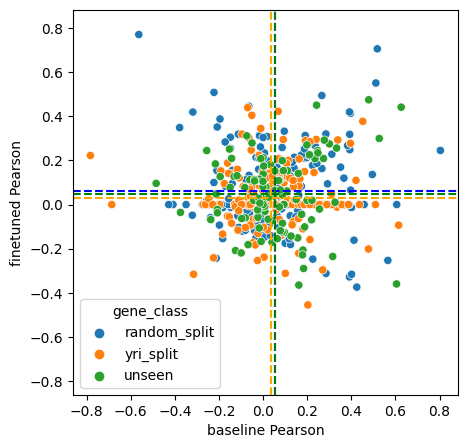

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.11819651162620419

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.07903759757599632

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



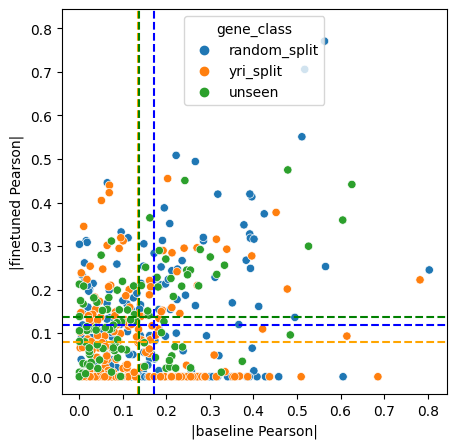

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.060480110916309913

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.029981268572566232

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



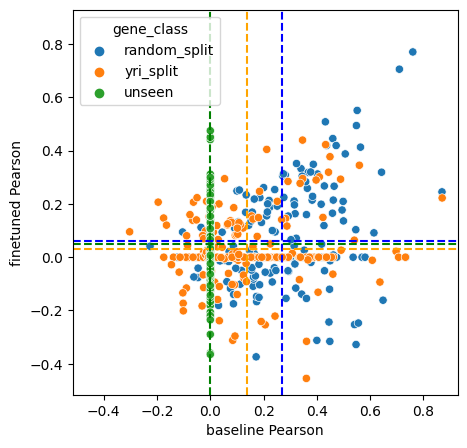

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.11819651162620419

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.07903759757599632

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



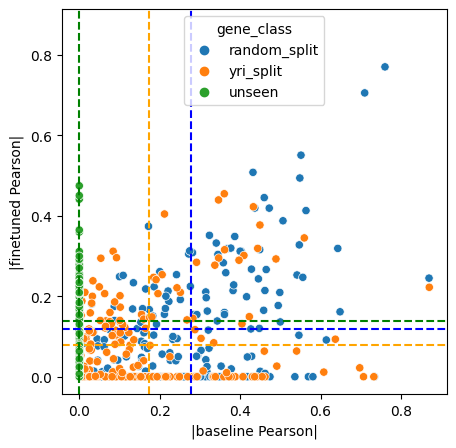

regression_data_seed_42_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.49


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene calm3 has invalid predictions/counts and thus has a nan pearsonR
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene acat1 has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene svbp has invalid predictions/counts and thus has a nan pearsonR
Gene al160408.3 has invalid predictions/counts and thus has a nan pearsonR
Gene exosc5 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene faap24 has invalid predictions/counts and thus has a nan pearsonR
Gene cd58 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000006075 has invalid predictions/counts and thus has a nan pearsonR
Gene yif1a has invalid predictions/counts and thus has a nan pearsonR
Gene mag has invalid predictions/counts and thus has a nan pearsonR
Gene c

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene linc01531 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene mthfr has invalid predictions/counts and thus has a nan pearsonR
Gene taf1a has invalid predictions/counts and thus has a nan pearsonR
Gene dmac2 has invalid predictions/counts and thus has a nan pearsonR
Gene cenpq has invalid predictions/counts and thus has a nan pearsonR
Gene chaf1a has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene slc16a9 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene hdhd3 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene mgmt has invalid predictions/counts and thus has a nan pearsonR
Gene ac104653.1 has invalid predictions/counts and thus has a nan pearsonR
Gene tmtc4 has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4m1 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearson

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene xpc has invalid predictions/counts and thus has a nan pearsonR
Gene cfap91 has invalid predictions/counts and thus has a nan pearsonR
Gene b3gnt7 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc27 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene acox3 has invalid predictions/counts and thus has a nan pearsonR
Gene anxa6 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene ptbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene fam234b has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene tprkb 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

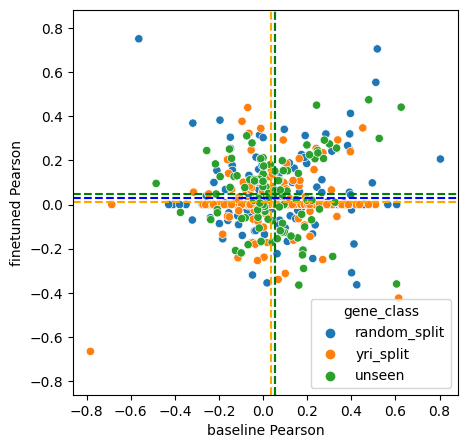

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.08020023855479934

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.055628283842521296

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.13755470070099546



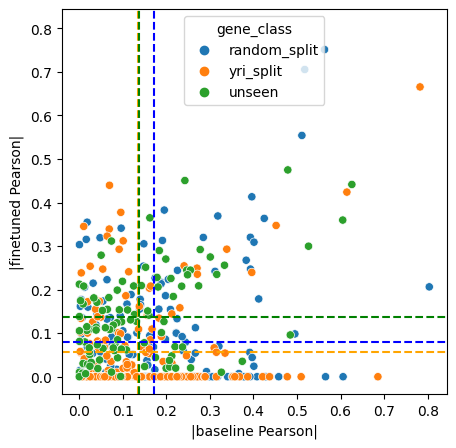

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.031541353465225214

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.011648107875949965

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.048736100838161295



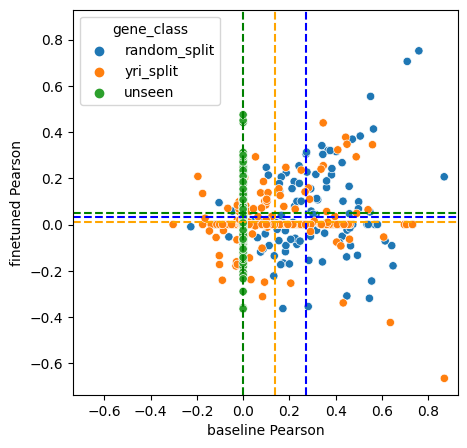

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.08020023855479934

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.055628283842521296

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.13755470070099546



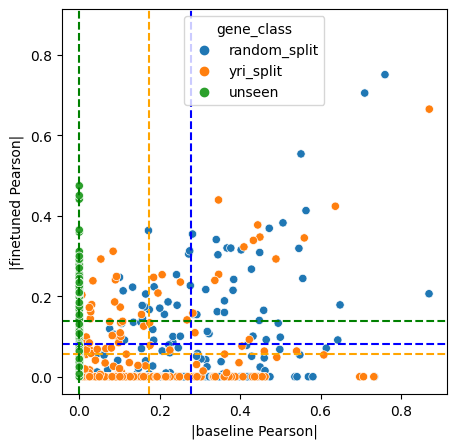

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.01


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

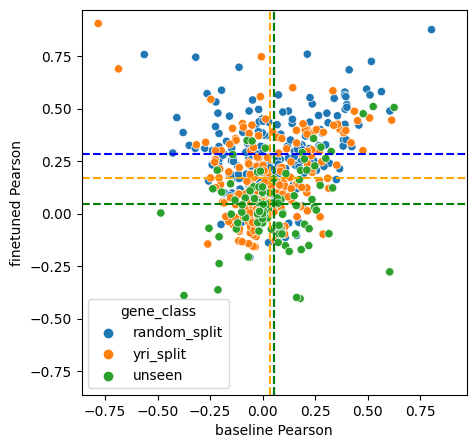

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2948576586000755

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19288140681710225

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



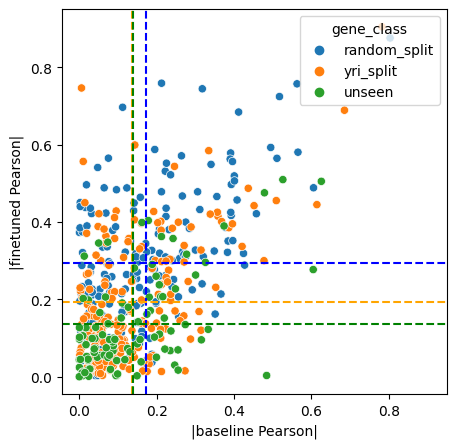

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.28578756247733667

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16749792048447706

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



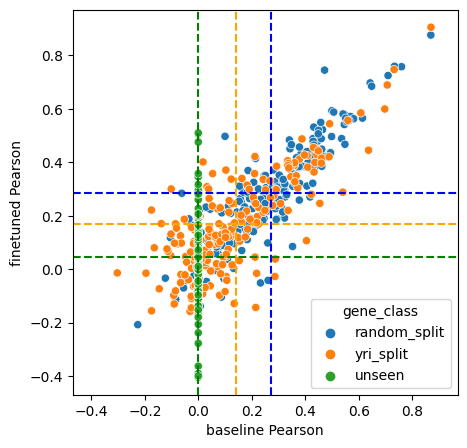

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2948576586000755

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19288140681710225

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



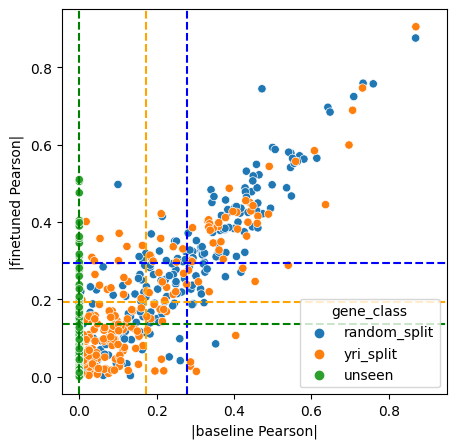

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.02


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

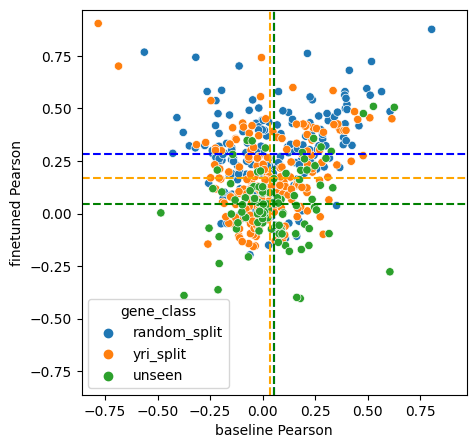

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.29389262791900295

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19395481003184997

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



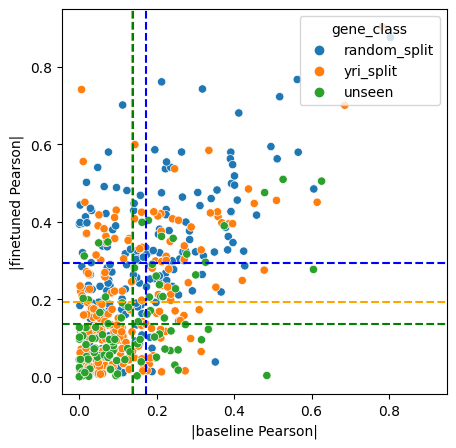

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2847543264210136

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.167186406618817

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



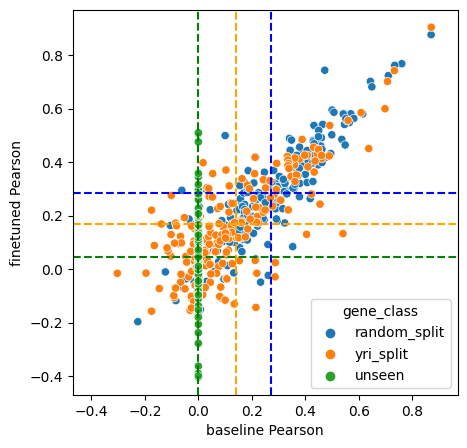

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.29389262791900295

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19395481003184997

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



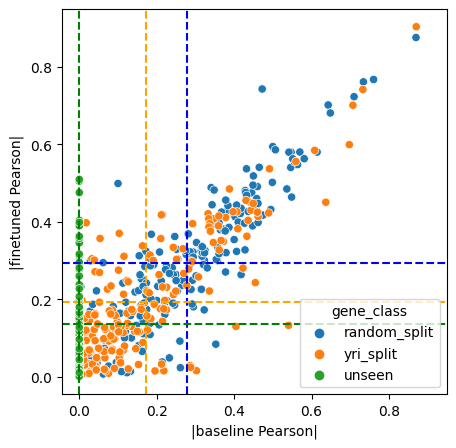

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.03


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

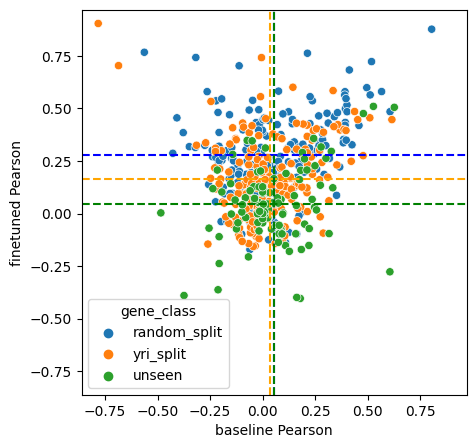

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.29166595883764673

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19331780355549108

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



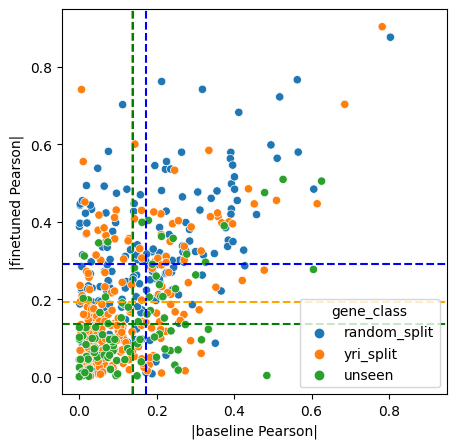

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2808041795262094

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1655998517784725

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



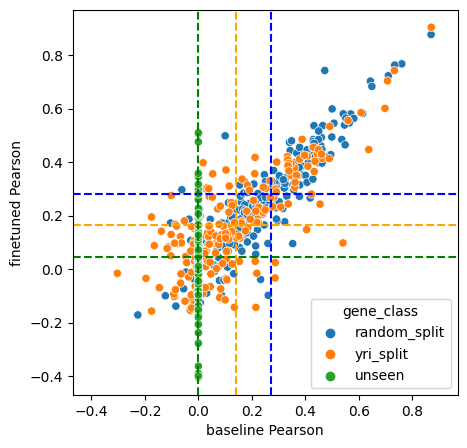

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.29166595883764673

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19331780355549108

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



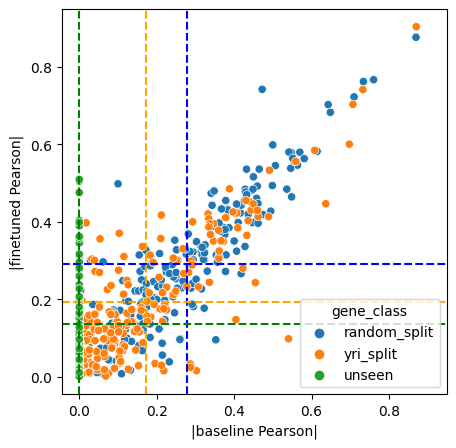

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.04


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

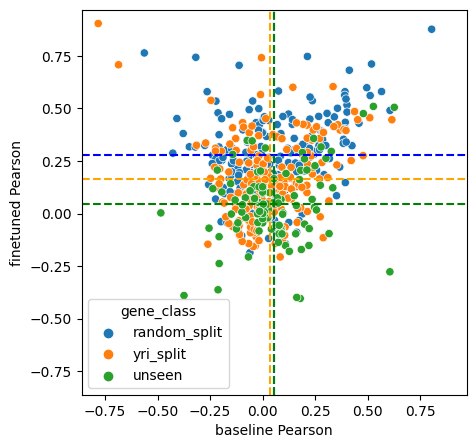

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28894543213657625

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19488340475172378

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



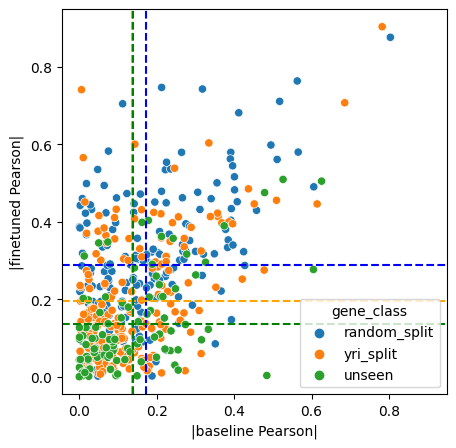

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.27839155475102356

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16370344712475549

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



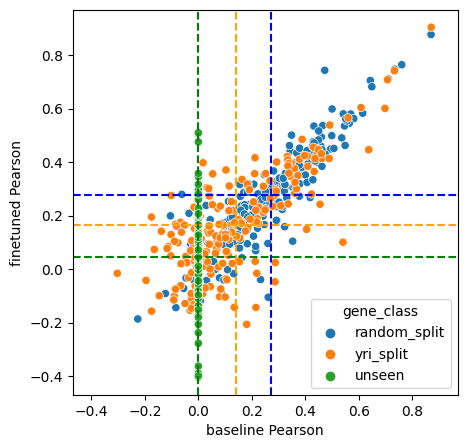

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28894543213657625

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19488340475172378

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



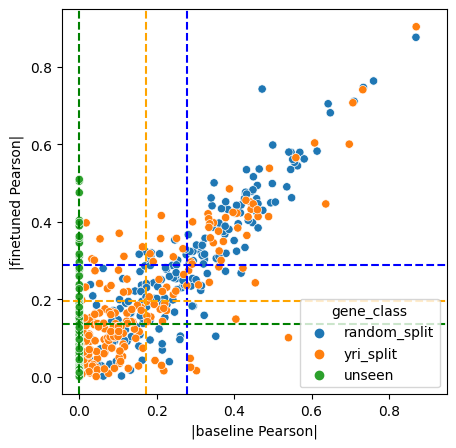

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.05


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

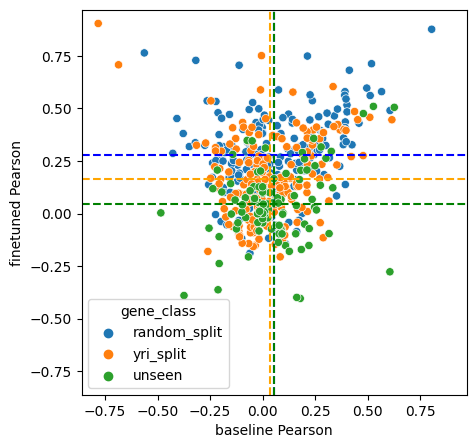

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2866783312970522

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19524017980425368

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



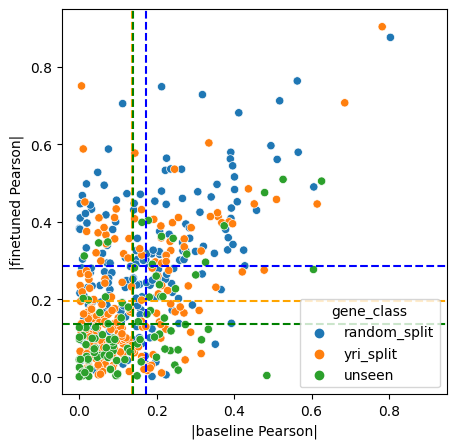

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.27610702885960947

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16249936708921553

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



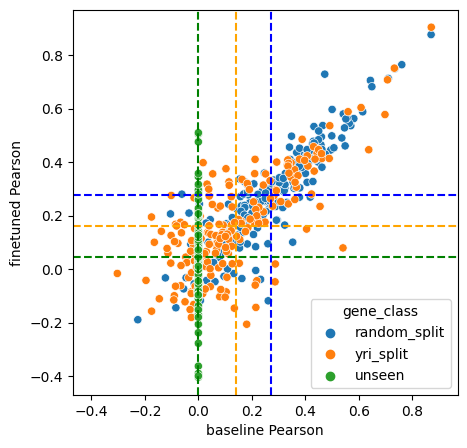

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2866783312970522

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19524017980425368

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



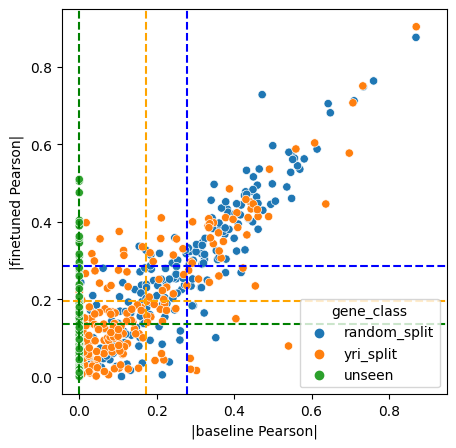

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.06


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

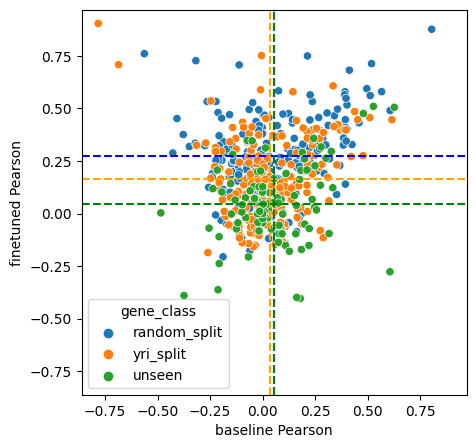

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28474714267213946

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19489122069820541

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



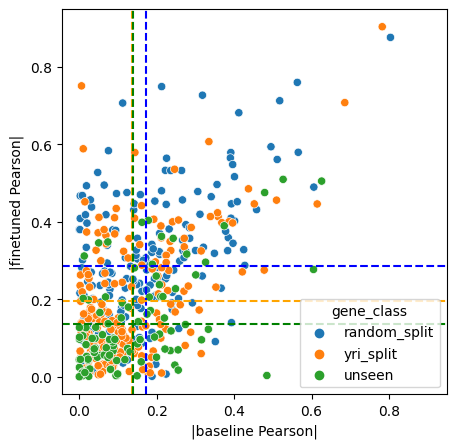

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2723813472700291

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16338315422858873

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



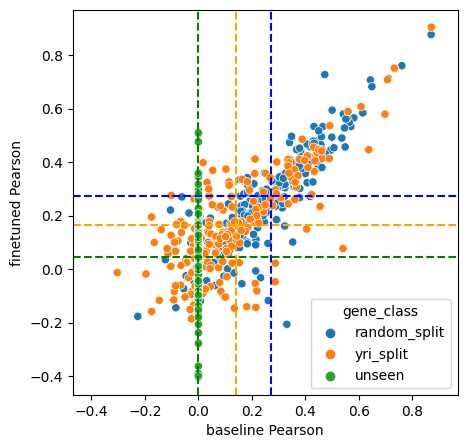

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28474714267213946

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19489122069820541

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



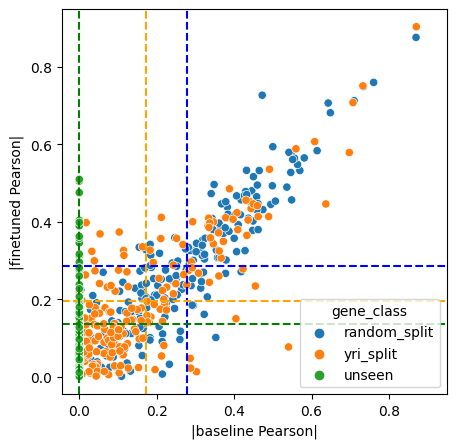

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.07


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

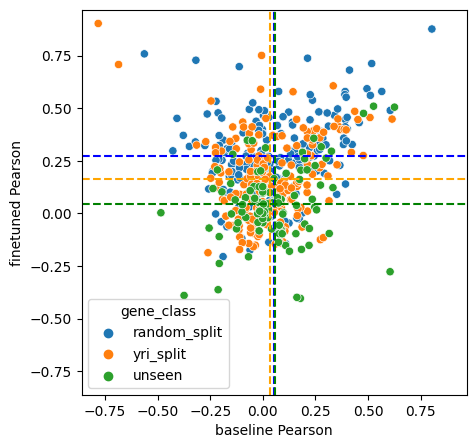

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2830815995772153

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19647137804448508

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



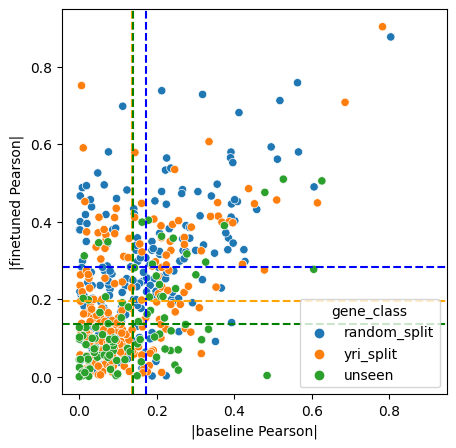

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2706718380639553

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16419436484754552

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



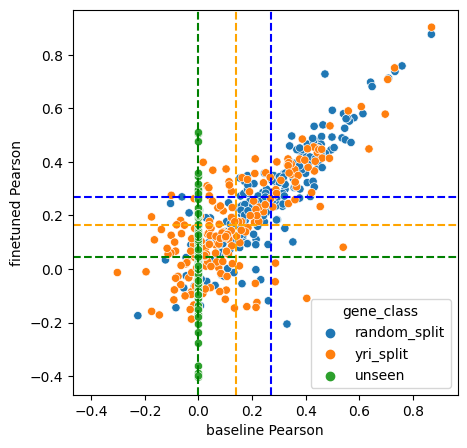

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2830815995772153

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19647137804448508

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



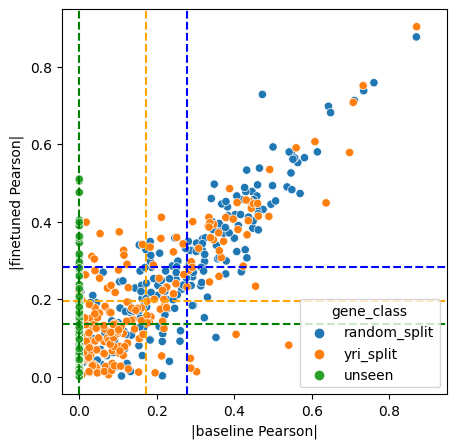

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.08


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

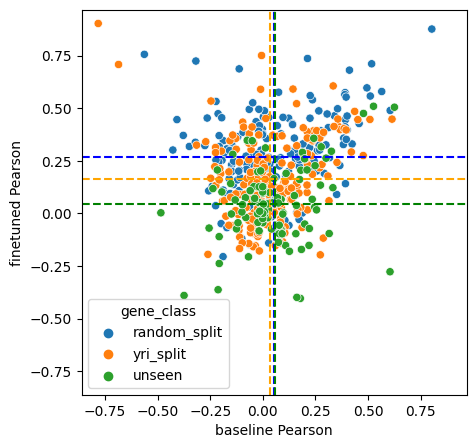

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28152631953373086

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19787530168388404

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



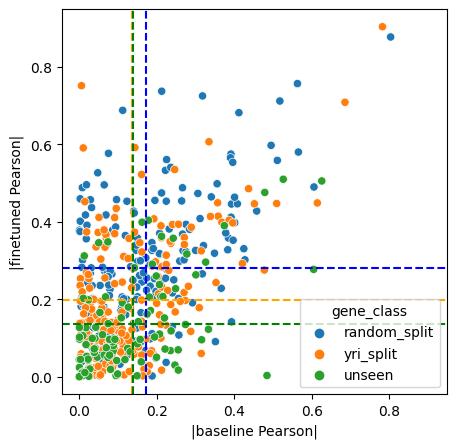

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2693766287519437

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16223262242269584

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



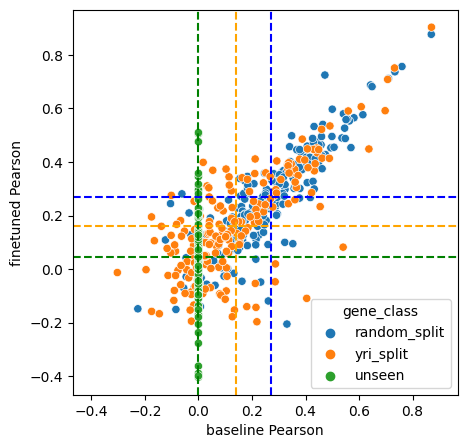

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28152631953373086

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19787530168388404

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



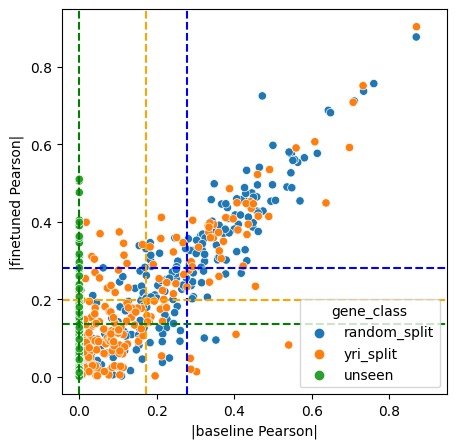

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.09


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

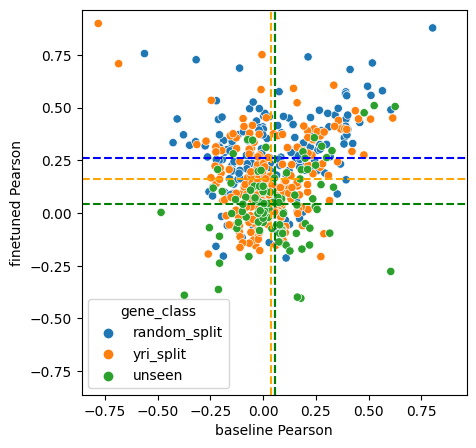

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.27665081326130386

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19794460490665317

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



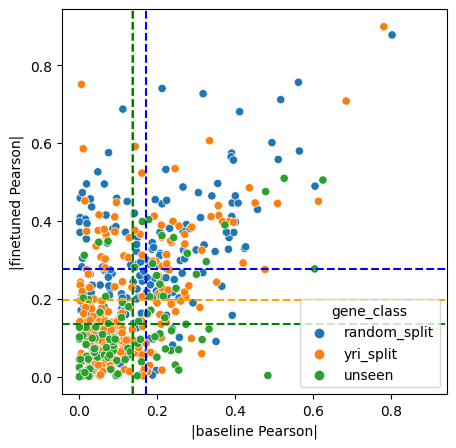

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2629278180130036

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16268034734065417

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



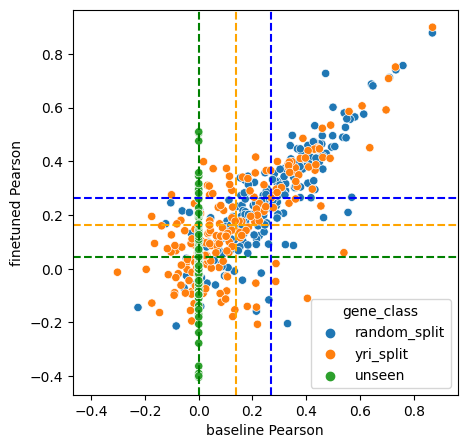

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.27665081326130386

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19794460490665317

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



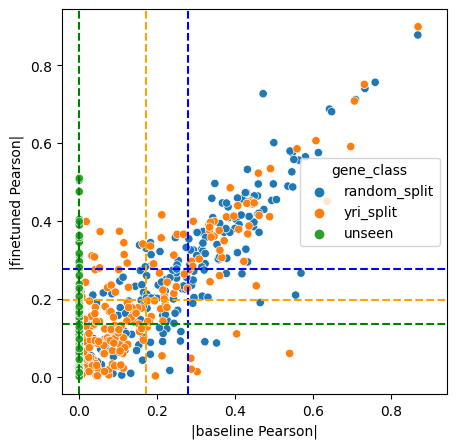

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.1


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

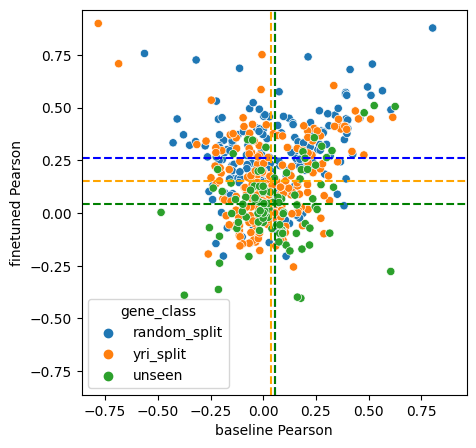

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2723061141682869

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18801451585779005

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



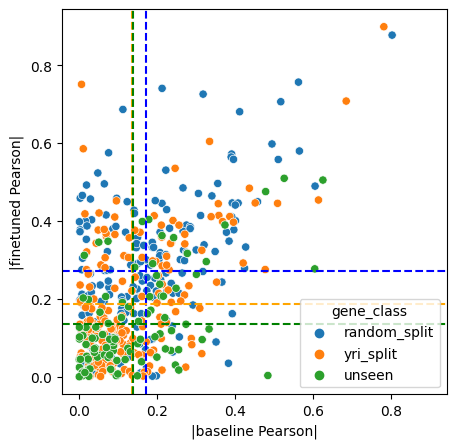

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.25868851669043436

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.15170575825013569

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



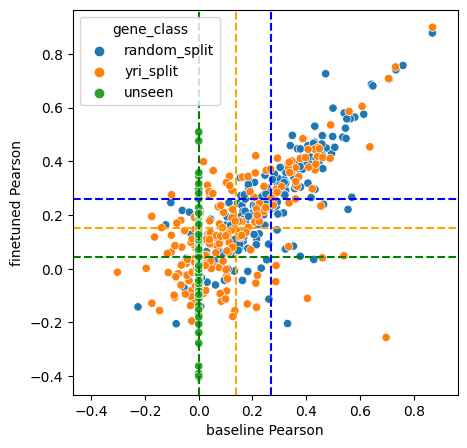

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2723061141682869

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18801451585779005

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



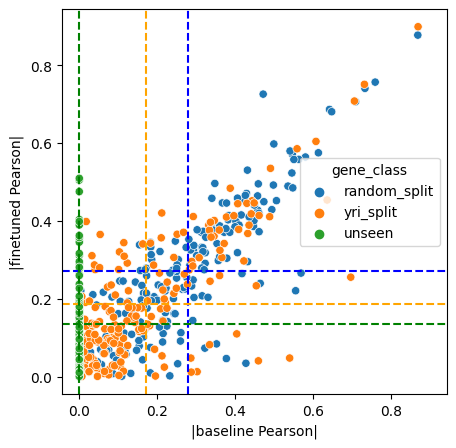

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.15


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

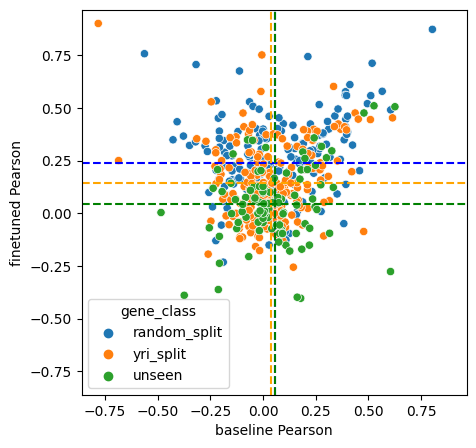

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2529107139238826

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17960677634907551

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



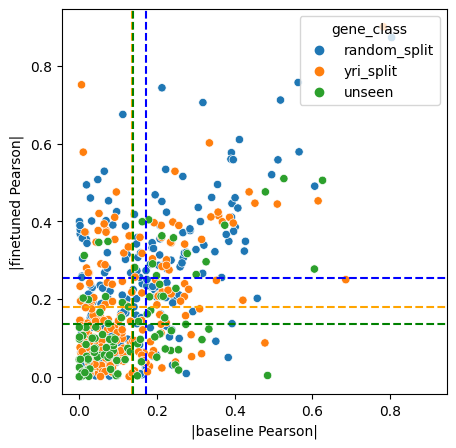

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.23950363348925904

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.14394356562541588

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



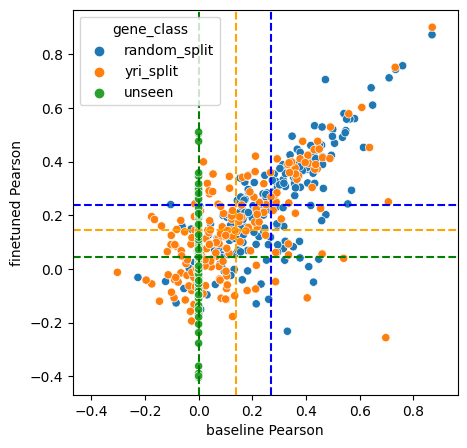

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2529107139238826

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17960677634907551

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



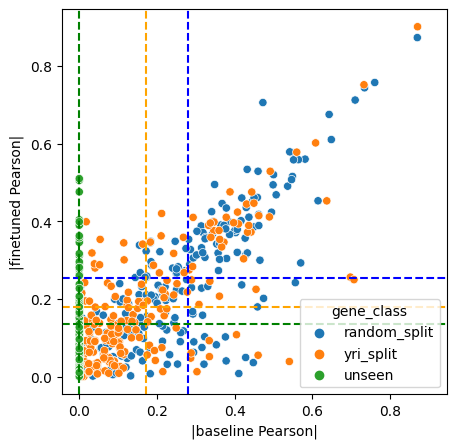

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.2


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

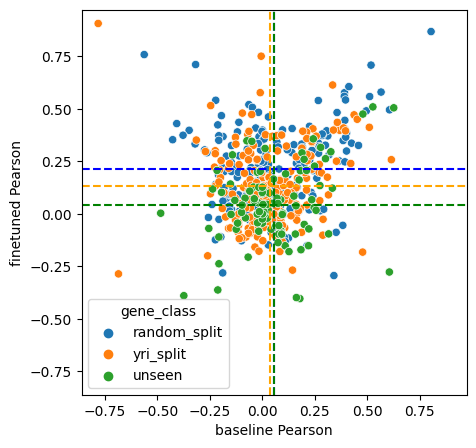

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.23733872639446718

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17554077178287553

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



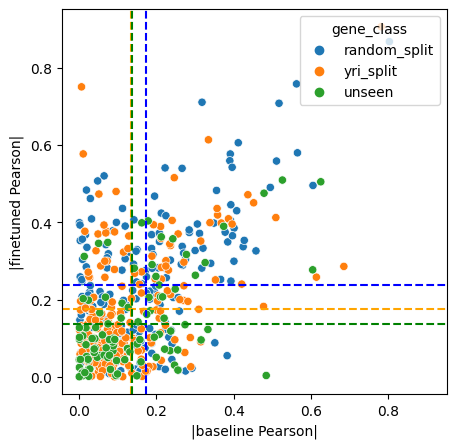

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.21556432672806436

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.13229403223601446

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



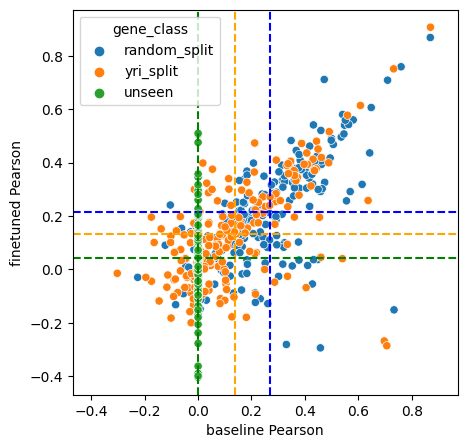

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.23733872639446718

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17554077178287553

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



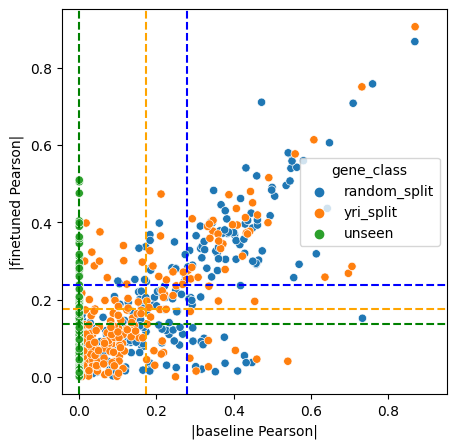

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.25


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

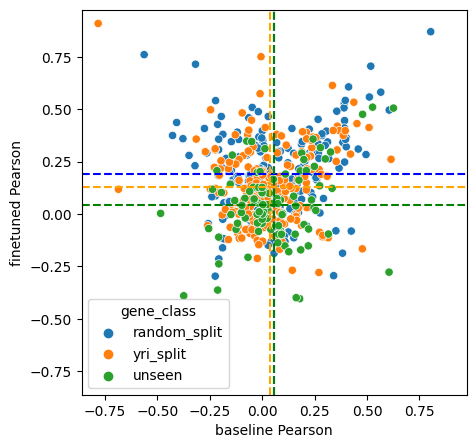

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.22463074647868317

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.17314150096036685

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



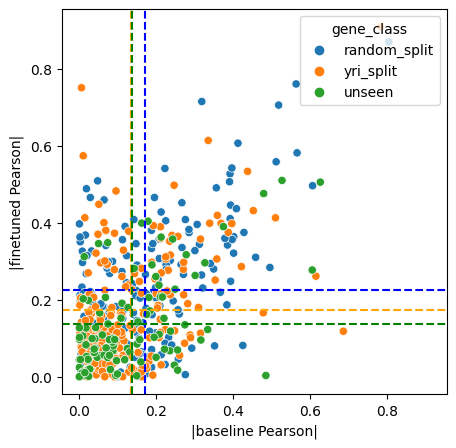

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.19280694558923323

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.131105780678236

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



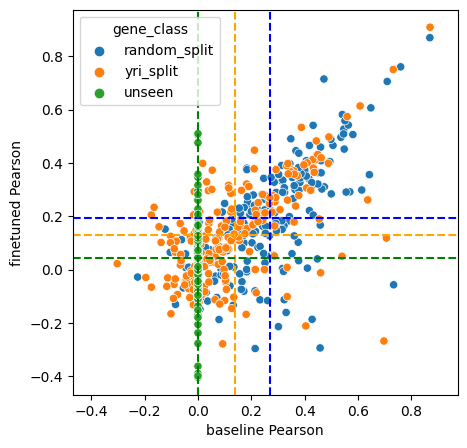

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.22463074647868317

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.17314150096036685

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



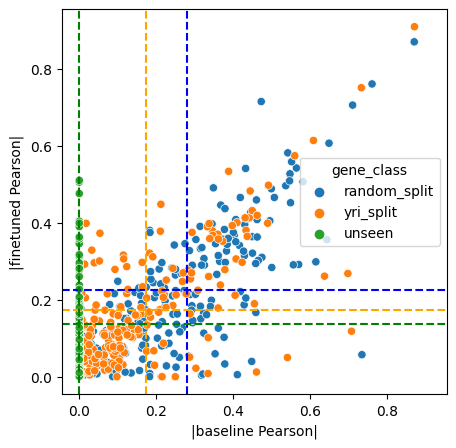

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

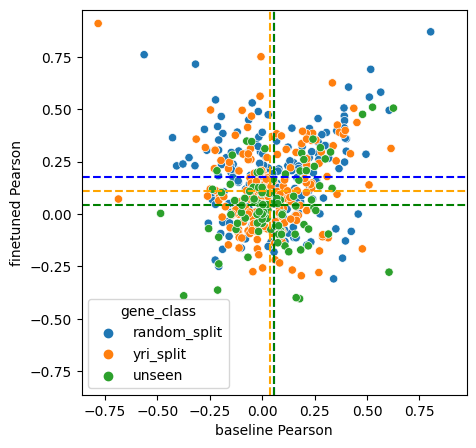

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2146505136159227

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.16428156622514323

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



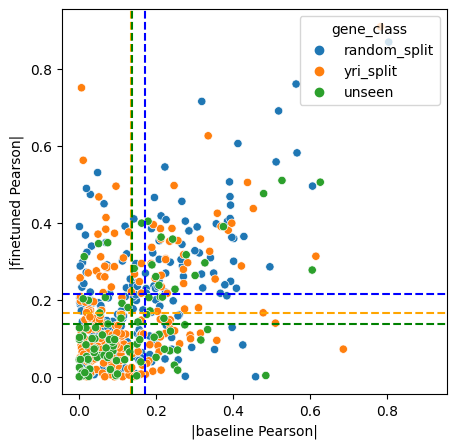

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.17744789527556365

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1097416439952163

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



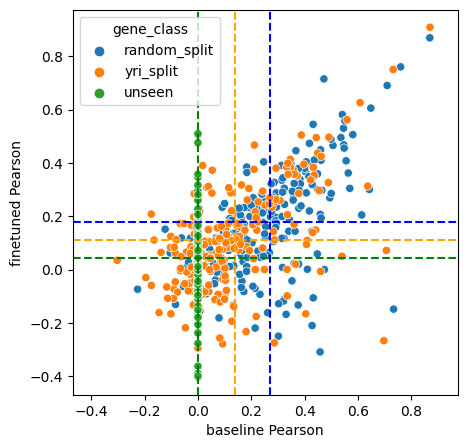

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2146505136159227

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.16428156622514323

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



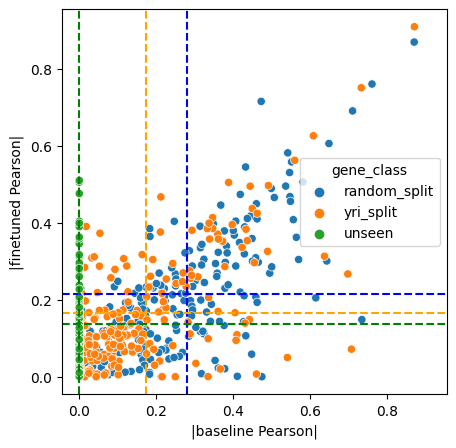

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.35


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

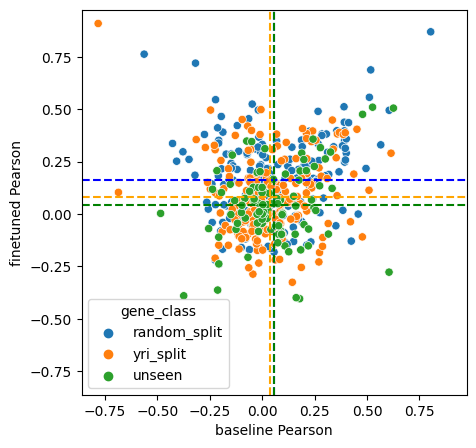

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.19716914426230112

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1505118137892252

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



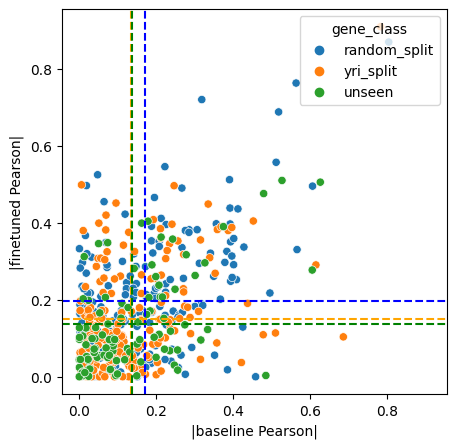

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.1635631873515978

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.08297471098013406

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



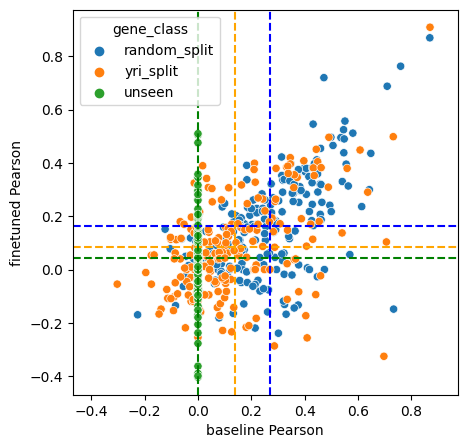

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.19716914426230112

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1505118137892252

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



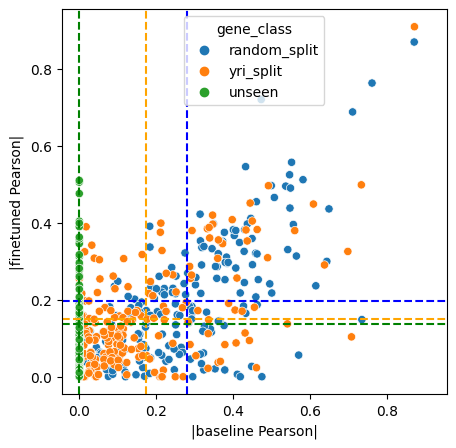

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.4


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene tmem163 has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

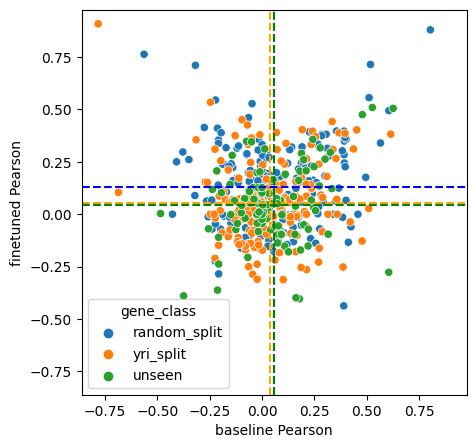

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.17681233121365472

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.13026028414433313

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



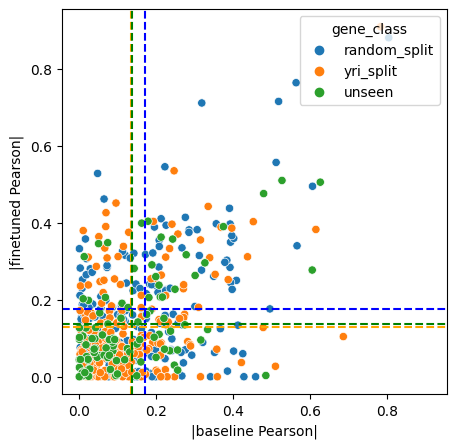

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.13082474018259896

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.05348810061481036

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



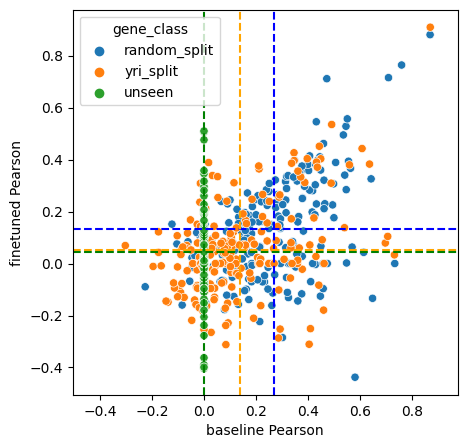

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.17681233121365472

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.13026028414433313

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



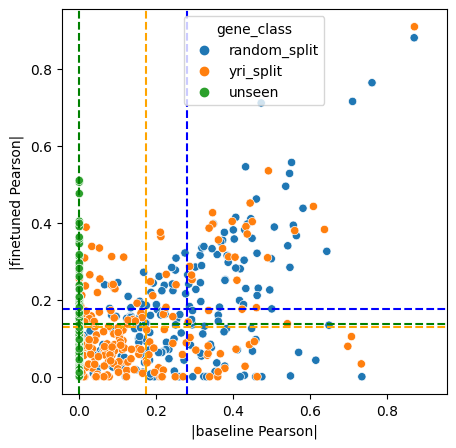

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.41


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene yipf5 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem163 has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

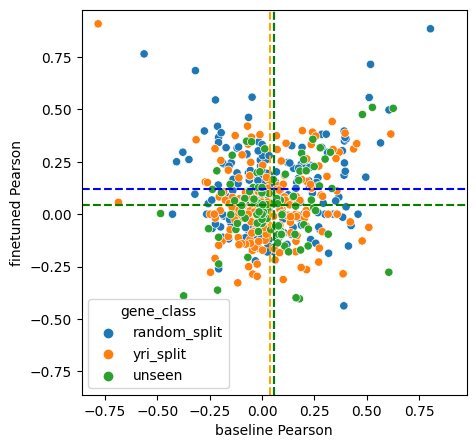

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.1691258875853412

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.12882573892831373

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



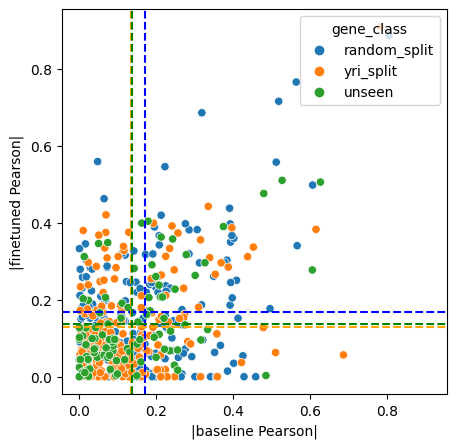

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.12146287494708834

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.04336525692170526

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



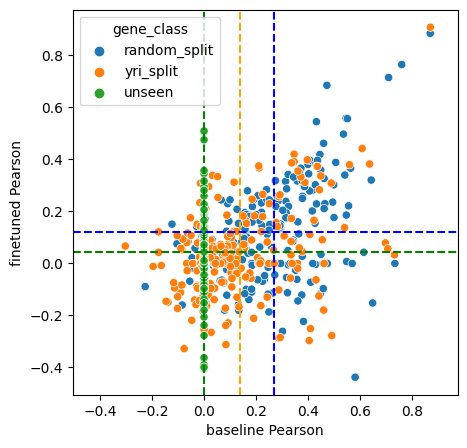

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.1691258875853412

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.12882573892831373

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



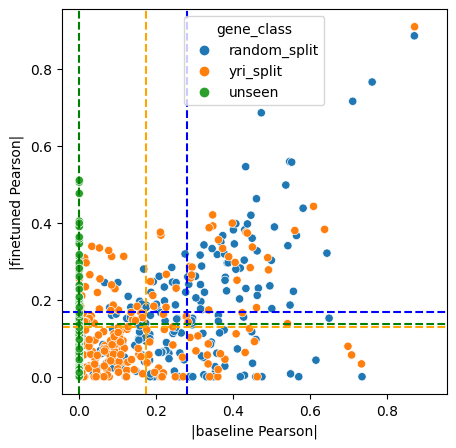

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.42


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR
Gene borcs7 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000232116 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene yipf5 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem163 has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

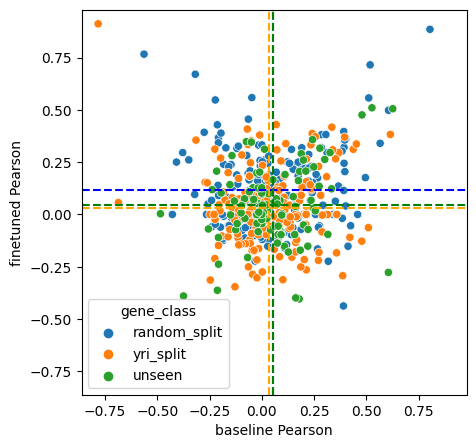

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.16274023114873848

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.12590471603062744

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



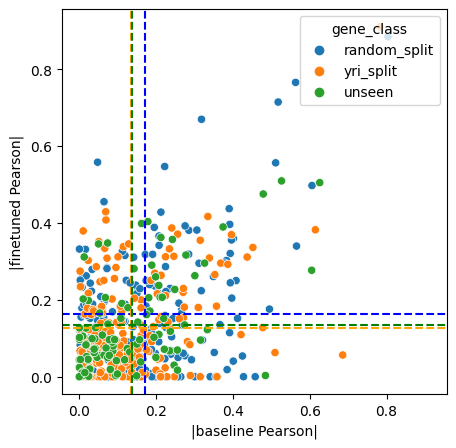

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.11860132014777357

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.03266368509319709

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



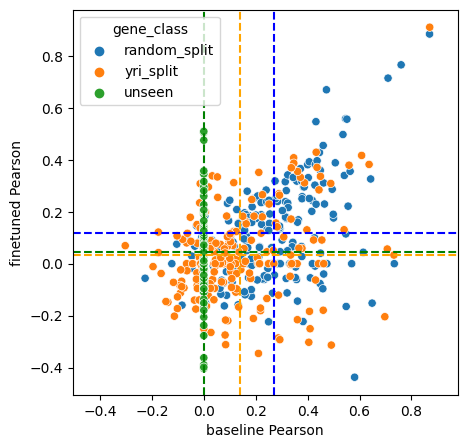

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.16274023114873848

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.12590471603062744

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



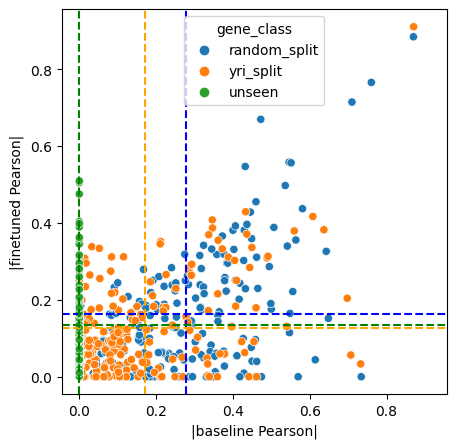

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.43
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR
Gene borcs7 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000232116 has invalid predictions/counts and thus has a nan 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene adk has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene tctn2 has invalid predictions/counts and thus has a nan pearsonR
Gene yipf5 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem1

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

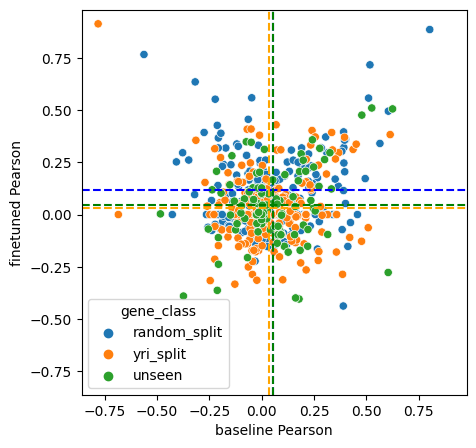

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.15617203070834912

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.12289477161550194

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



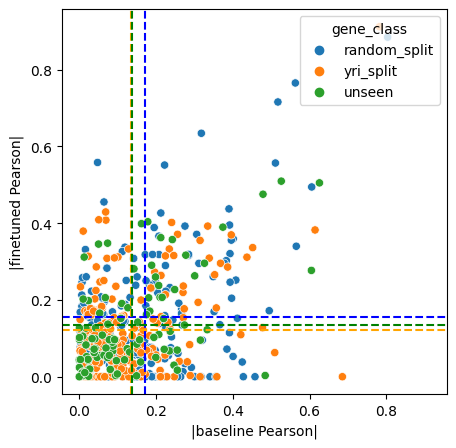

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.11618899518400143

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.032399233823896215

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



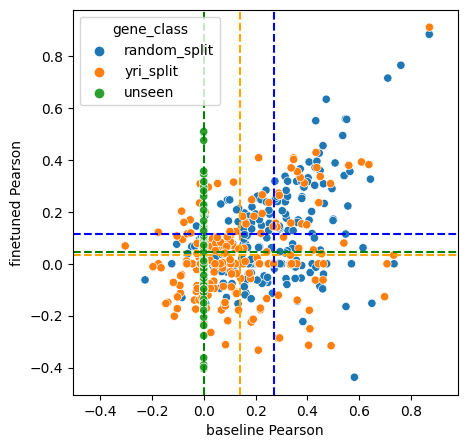

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.15617203070834912

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.12289477161550194

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



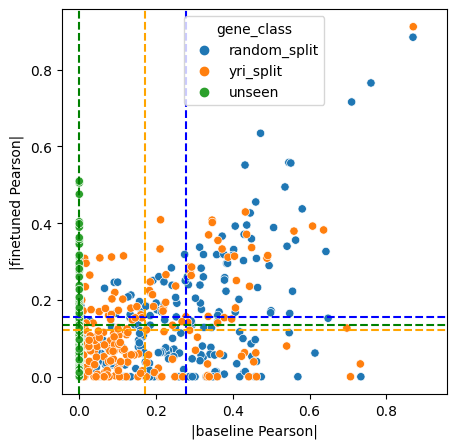

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.44


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene cdc42bpa has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR
Gene borcs7 has invalid predictions/counts and thus has a nan pearson

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearsonR
Gene ftcdnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene adk has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene e

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR
Gene hyal4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

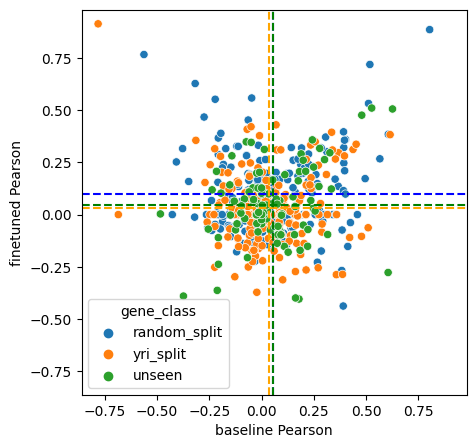

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.1494458817435458

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.12208159697722

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



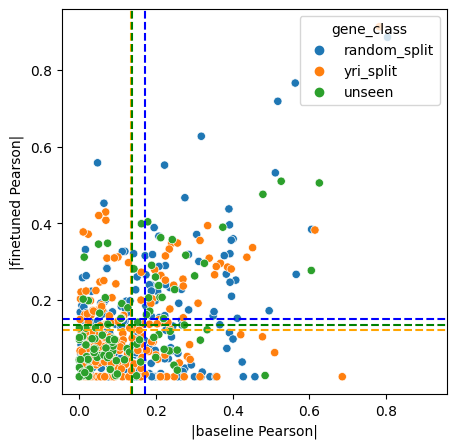

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.09894509271093088

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.03383910647172288

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



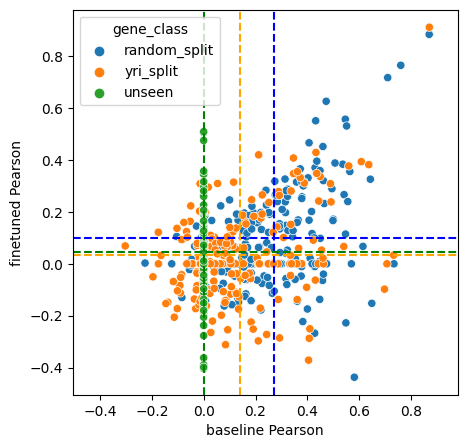

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.1494458817435458

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.12208159697722

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



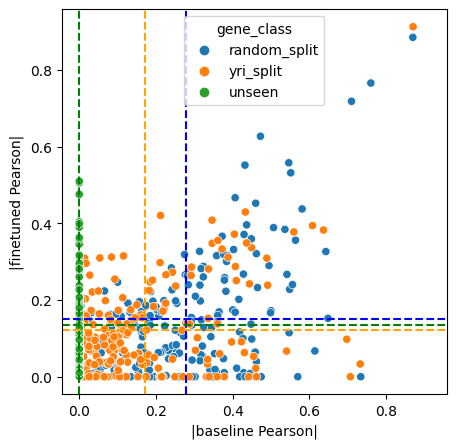

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.45


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene foxred1 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene ra

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene etv2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf283 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
Gene kptn has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
G

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rps14 has invalid predictions/counts and thus has a nan pearsonR
Gene rab33b has invalid predictions/counts and thus has a nan pearsonR
Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearsonR
Gene ftcdnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearson

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene mttp has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR
Gene arhgef35 has invalid predictions/counts and thus has a nan pearsonR
Ge

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

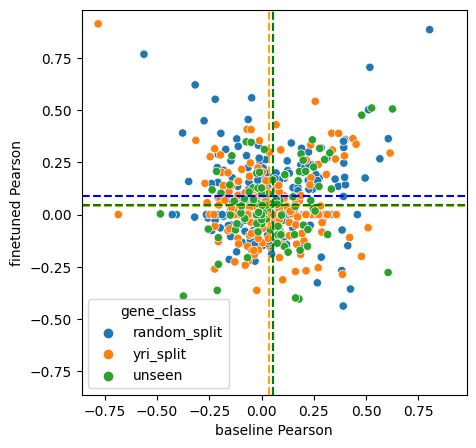

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.1458662662646216

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1139720669320239

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



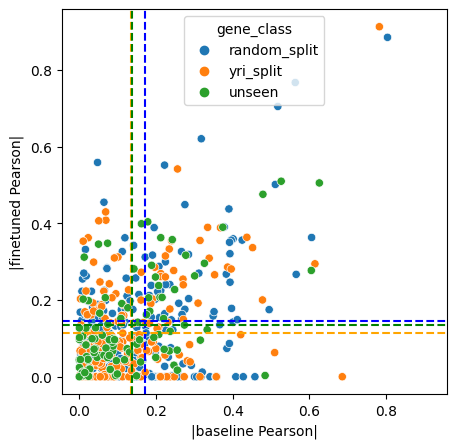

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.08896885014485724

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.04281236109282606

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



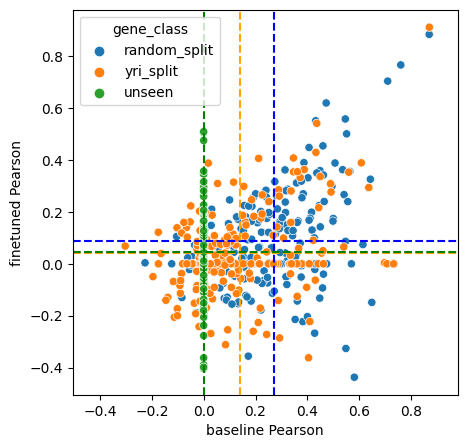

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.1458662662646216

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1139720669320239

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



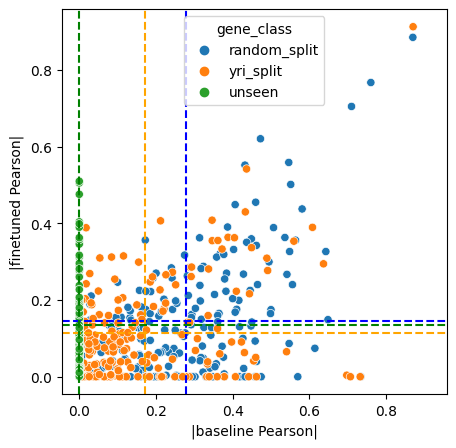

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.46


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene ap4b1 has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap35 has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene ighmbp2 has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene foxred1 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo h

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene etv2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf283 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
Gene kptn has invalid predictions/counts and thus has a nan pearsonR
Gene glul has invalid predictions/counts and thus has a nan pearsonR
Ge

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rps14 has invalid predictions/counts and thus has a nan pearsonR
Gene linc01006 has invalid predictions/counts and thus has a nan pearsonR
Gene rab33b has invalid predictions/counts and thus has a nan pearsonR
Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4m1 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearso

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene mttp has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene itgb1 has invalid predictions/counts and thus has a nan pearsonR
Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bbs12 has invalid predictions/counts and thus has a nan pearsonR
Gene nelfb has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene rnf

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

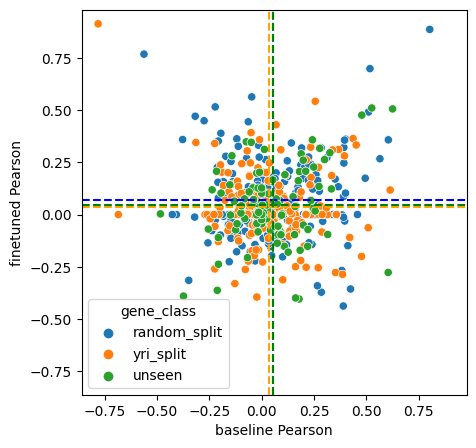

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.13733647048589104

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.10486295975626757

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



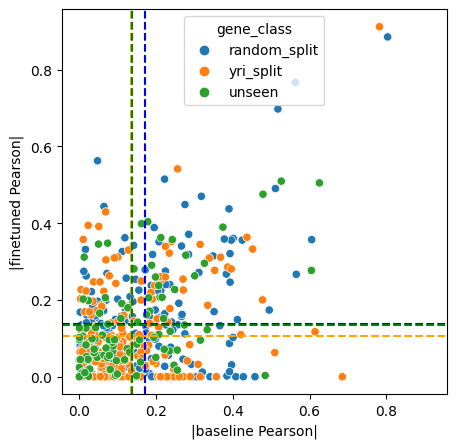

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.06864118392340486

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.03379927339337296

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



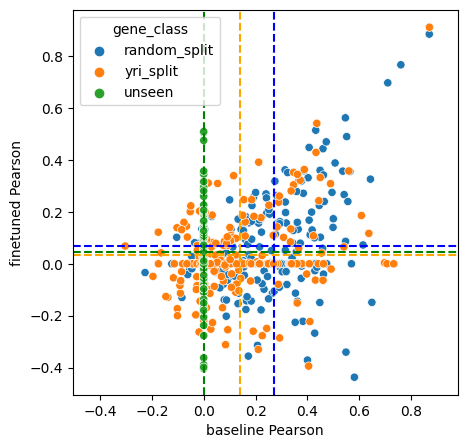

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.13733647048589104

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.10486295975626757

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



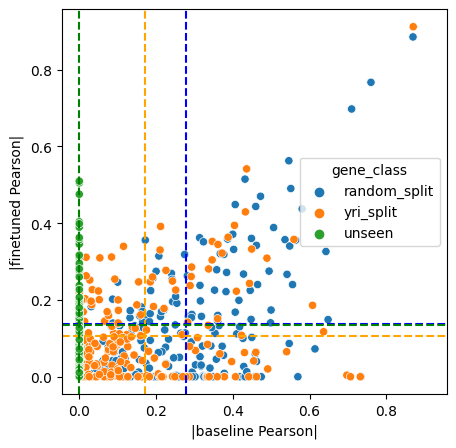

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.47


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene colca2 has invalid predictions/counts and thus has a nan pearsonR
Gene sdccag8 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4b1 has invalid predictions/counts and thus has a nan pearsonR
Gene rnf43 has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap35 has invalid predictions/counts and thus has a nan pearsonR
Gene sdhaf4 has invalid predictions/counts and thus has a nan pearsonR
Gene smtnl1 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene etv2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf283 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene cenpq has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene ppan has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
G

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene atp7b has invalid predictions/counts and thus has a nan pearsonR
Gene rps14 has invalid predictions/counts and thus has a nan pearsonR
Gene linc01006 has invalid predictions/counts and thus has a nan pearsonR
Gene cox17 has invalid predictions/counts and thus has a nan pearsonR
Gene rab33b has invalid predictions/counts and thus has a nan pearsonR
Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene tmtc4 has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene mttp has invalid predictions/counts and thus has a nan pearsonR
Gene nlrc4 has invalid predictions/counts and thus has a nan pearsonR
Gene hmhb1 has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene itgb1 has invalid predictions/counts and thus has a nan pearsonR
Gene slc18a2 has invalid predictions/counts and thus has a nan pearsonR
Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene ptbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa12

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

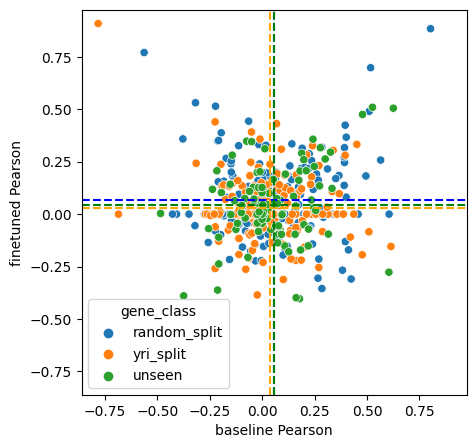

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.12583297489465659

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.08922852104488413

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



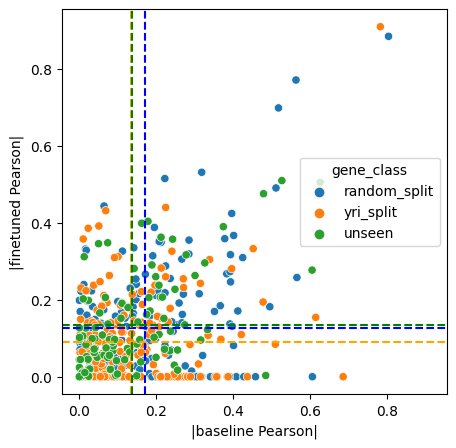

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.0682553984333406

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.028372324549821783

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



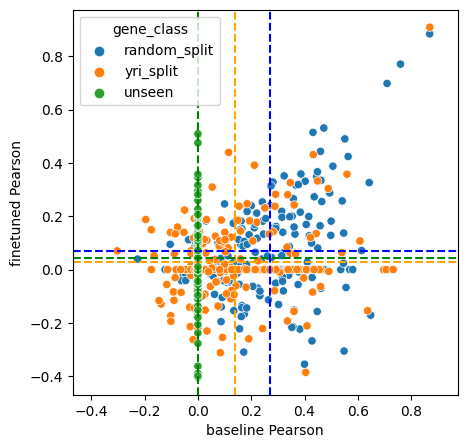

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.12583297489465659

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.08922852104488413

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



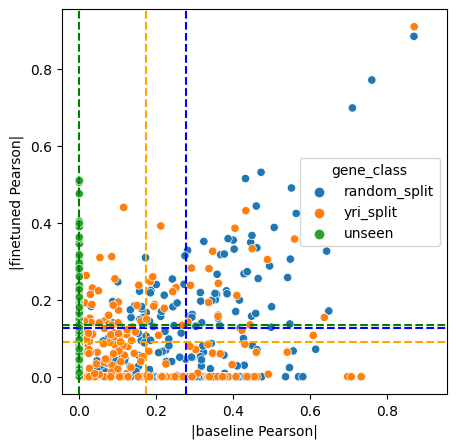

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.48
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene svbp has invalid predictions/counts and thus has a nan pearsonR
Gene exosc5 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene cd58 has invalid predictions/counts and thus has a nan pearsonR
Gene yif1a has invalid predictions/counts and thus has a nan pearsonR
Gene mag has invalid predictions/counts and thus has a nan pearsonR
Gene colca2 has invalid predictions/counts and thus has a nan pearsonR
Gene sdccag8 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4b1 has invalid predictions/counts and thus has a nan pearsonR
Gene rnf43 has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has inval

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene mthfr has invalid predictions/counts and thus has a nan pearsonR
Gene dmac2 has invalid predictions/counts and thus has a nan pearsonR
Gene cenpq has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene cct6b has invalid predictions/counts and thus has a nan pearsonR
Gene ppan has invalid predictions/counts and thus has a nan pearsonR
Gene a

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene tmtc4 has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4m1 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene ac108206.1 has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearsonR
Gene ftcdnl1 has invalid predictions/counts and thus has a nan pear

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpc has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene ptbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bbs12 has invalid predictions/counts and thus has a nan pearsonR
Gene nelfb has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene rnf168 has invalid predictions/counts and thus has a nan pearsonR
Gene brk

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

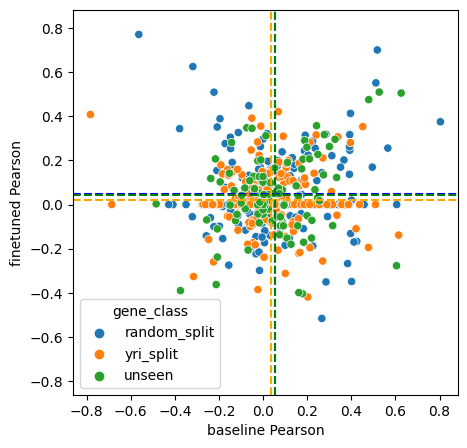

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.11743483570591202

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.0785380633816723

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



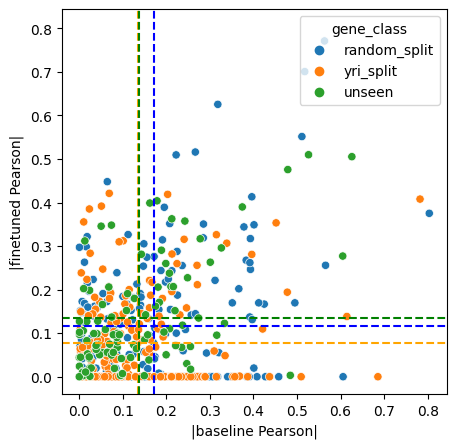

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.047298833931044795

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.021209847089142614

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



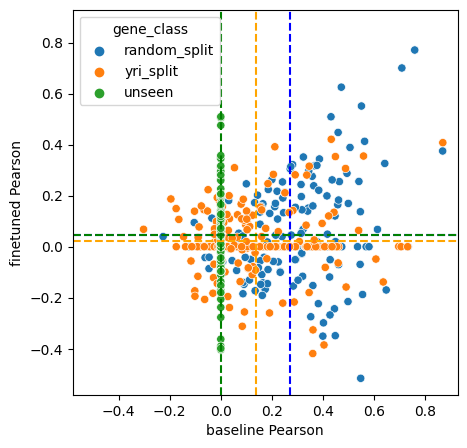

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.11743483570591202

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.0785380633816723

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



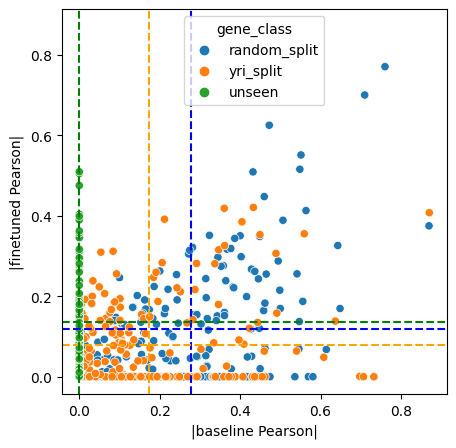

regression_data_seed_97_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.49
Gene calm3 has invalid predictions/counts and thus has a nan pearsonR
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene acat1 has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene svbp has invalid predictions/counts and thus has a nan pearsonR
Gene al160408.3 has invalid predictions/counts and thus has a nan pearsonR
Gene exosc5 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene faap24 has invalid predictions/counts and thus has a nan pearsonR
Gene cd58 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000006075 has invalid predictions/counts and thus has a nan pearsonR
Gene yif1a has invalid predictions/counts and thus has a nan pearsonR
Gene mag has invalid predictions/counts and thus has a nan pearsonR
Gene colca2 has invalid predictions/counts and thus has a nan pearsonR
Gene sdccag8 has invalid predictions/counts and thus has a nan pearsonR
Gene

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene mthfr has invalid predictions/counts and thus has a nan pearsonR
Gene taf1a has invalid predictions/counts and thus has a nan pearsonR
Gene dmac2 has invalid predictions/counts and thus has a nan pearsonR
Gene cenpq has invalid predictions/counts and thus has a nan pearsonR
Gene chaf1a has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene slc16a9 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene hdhd3 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene mgmt has invalid predictions/counts and thus has a nan pearsonR
Gene ac104653.1 has invalid predictions/counts and thus has a nan pearsonR
Gene tmtc4 has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4m1 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearson

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene xpc has invalid predictions/counts and thus has a nan pearsonR
Gene cfap91 has invalid predictions/counts and thus has a nan pearsonR
Gene b3gnt7 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc27 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene acox3 has invalid predictions/counts and thus has a nan pearsonR
Gene anxa6 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene ptbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene fam234b has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene tprkb 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

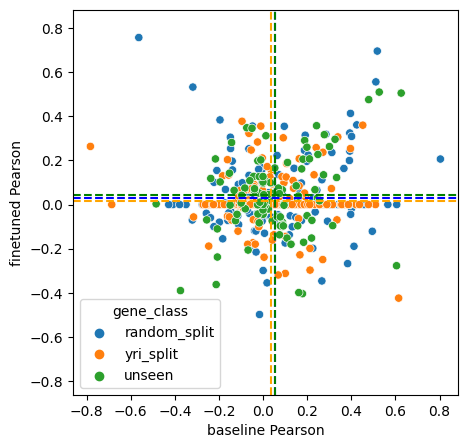

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.08325873784322216

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.05612022891998178

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.1356630337502767



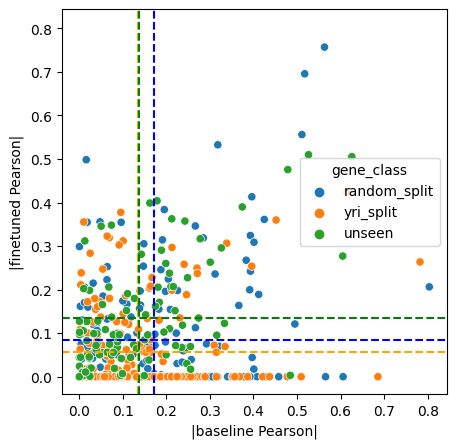

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.030420033984463624

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.01389078740661604

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.04431906920515272



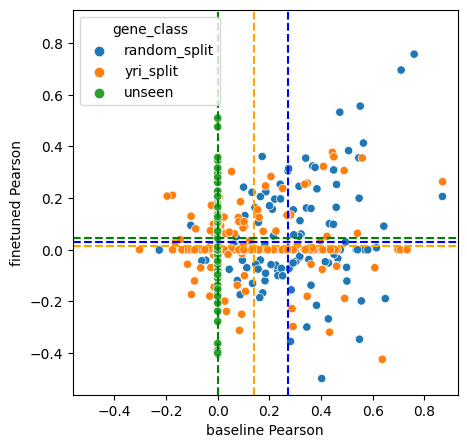

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.08325873784322216

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.05612022891998178

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.1356630337502767



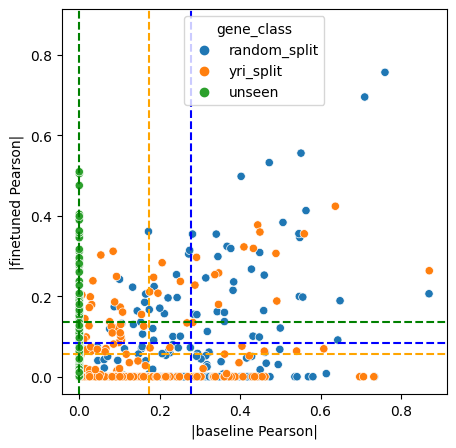

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.01


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

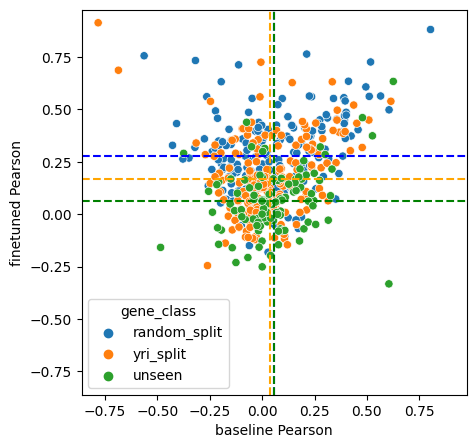

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28669405017993366

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1929558470163426

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



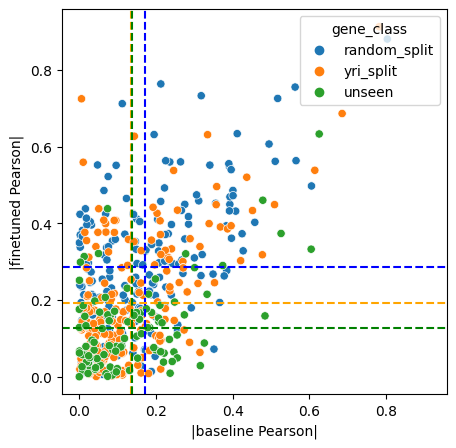

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.27966605521651244

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16992605370143854

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



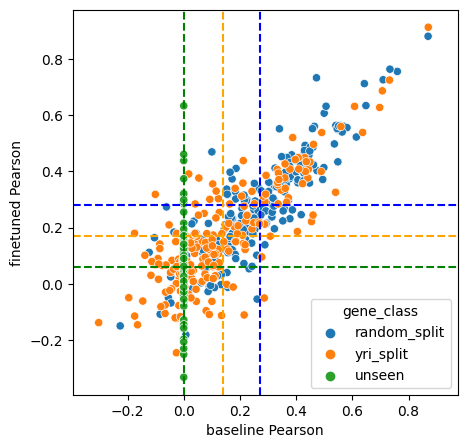

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28669405017993366

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1929558470163426

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



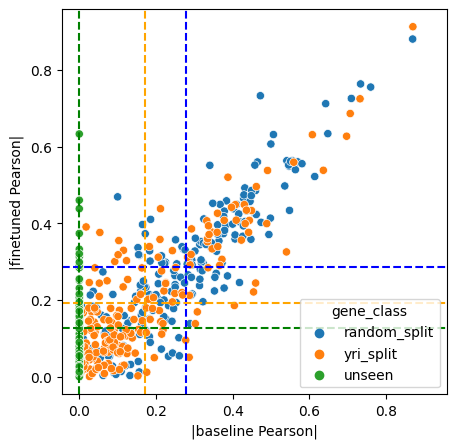

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.02


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

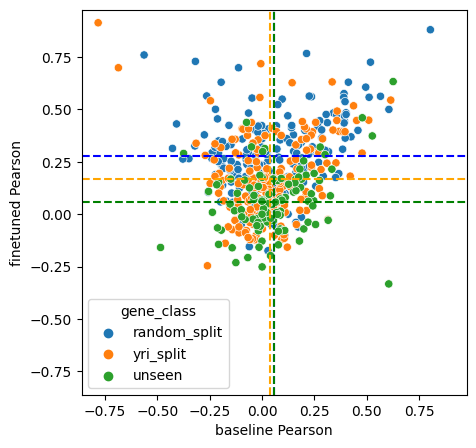

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28657818827751086

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19468119255222358

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



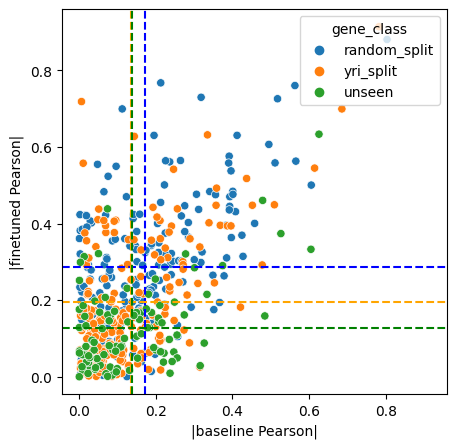

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2795349632945197

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1690362685255478

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



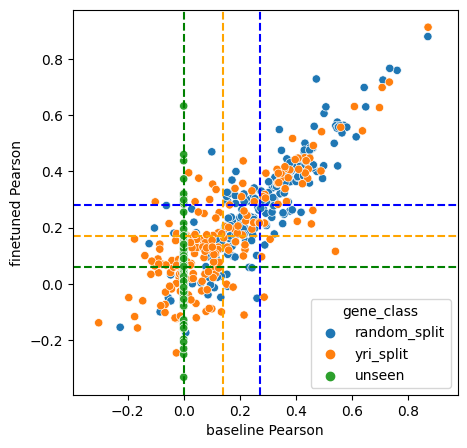

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28657818827751086

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19468119255222358

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



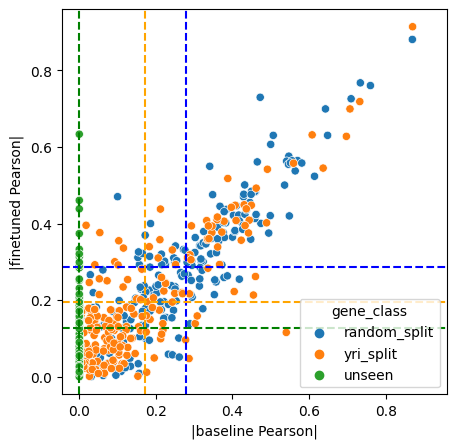

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.03


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

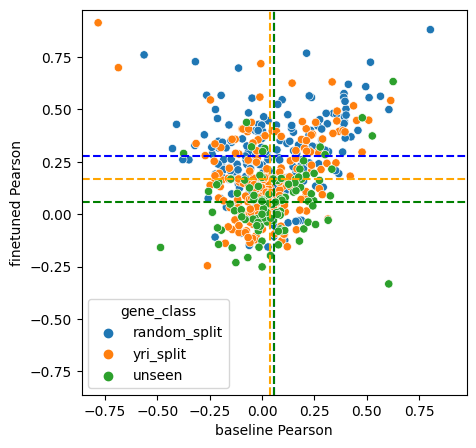

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28674087933592535

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1938238419777826

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



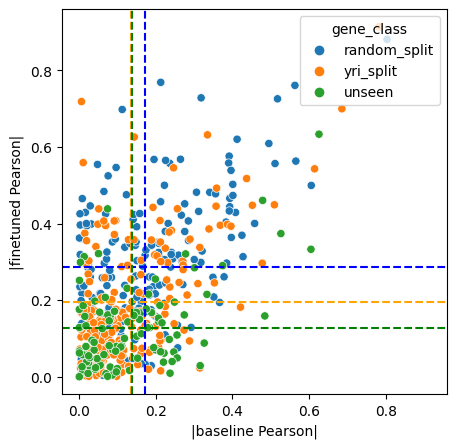

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2769852086596651

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16826119485704893

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



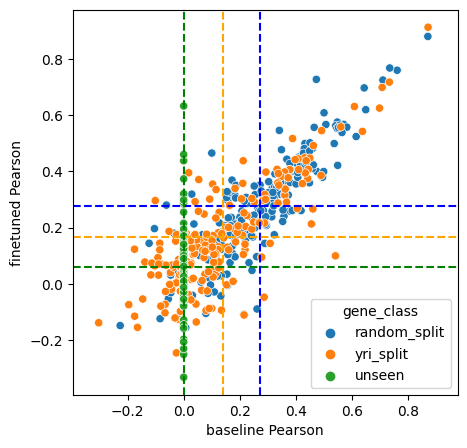

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28674087933592535

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1938238419777826

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



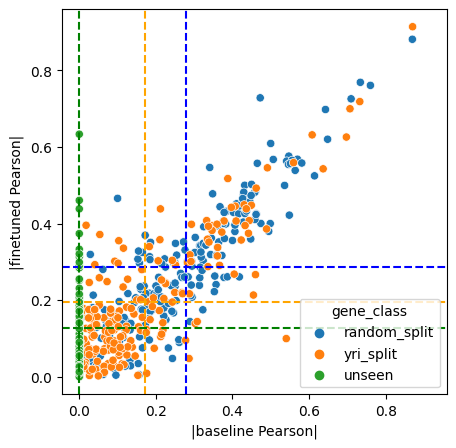

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.04


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

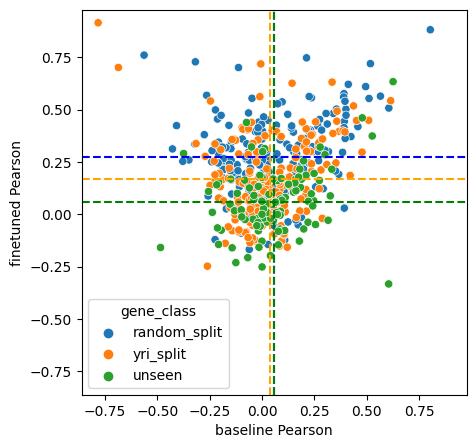

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2836085264731778

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1935256403849263

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



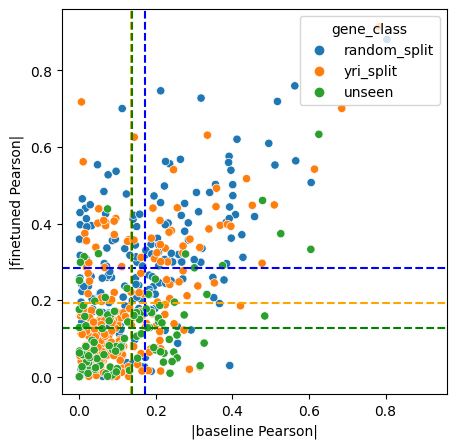

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2738427958047735

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16655246261216658

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



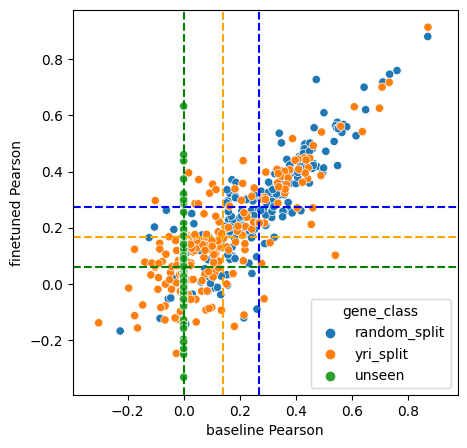

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2836085264731778

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1935256403849263

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



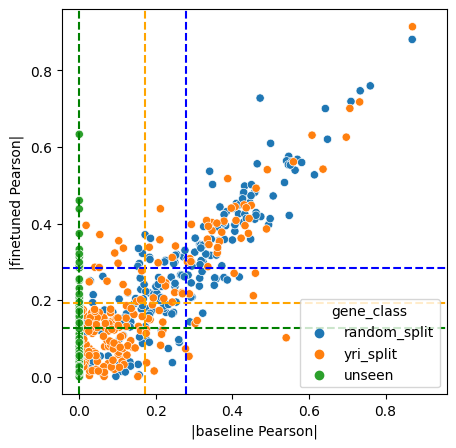

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.05


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

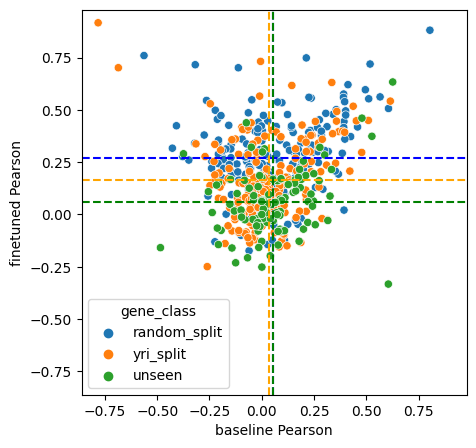

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.28226580683317953

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1934572821682874

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



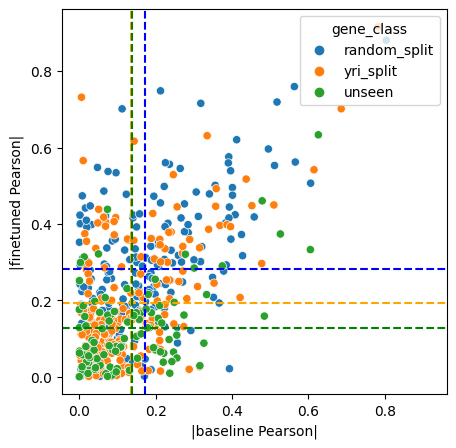

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2714631039832433

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16533915357240378

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



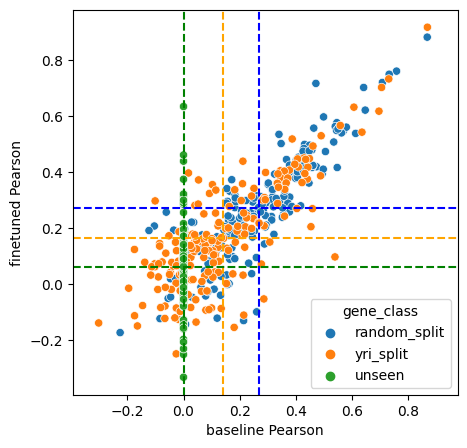

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.28226580683317953

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1934572821682874

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



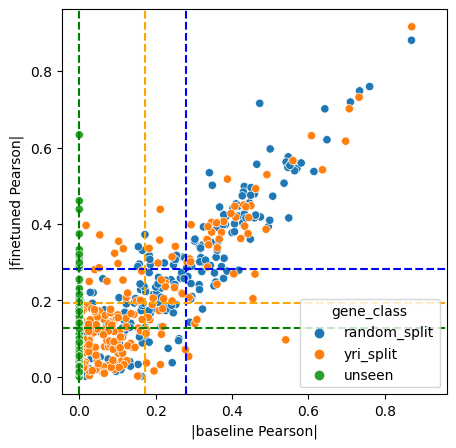

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.06


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

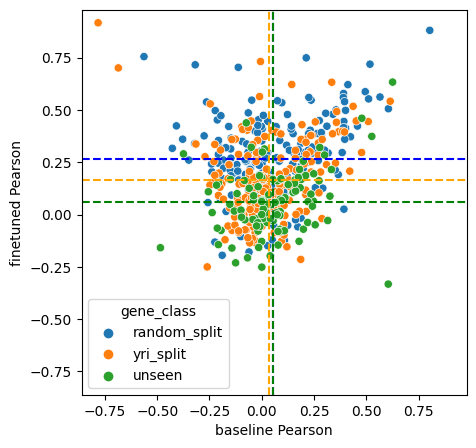

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2811363161036157

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1930180372139471

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



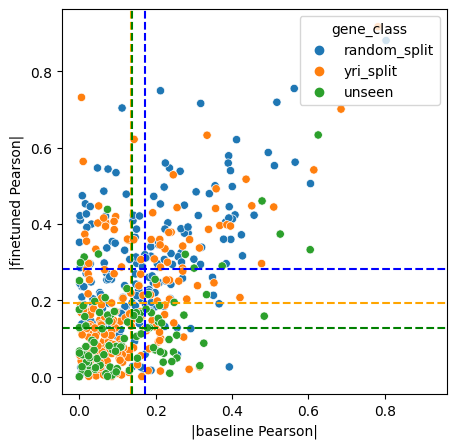

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.26725509895729843

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16531014338509628

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



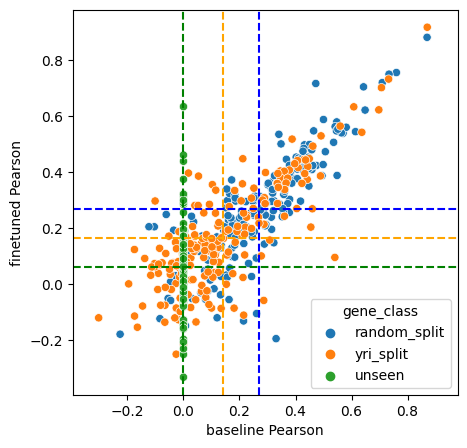

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2811363161036157

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1930180372139471

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



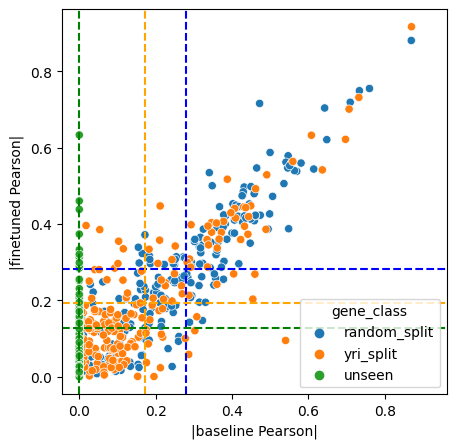

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.07


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

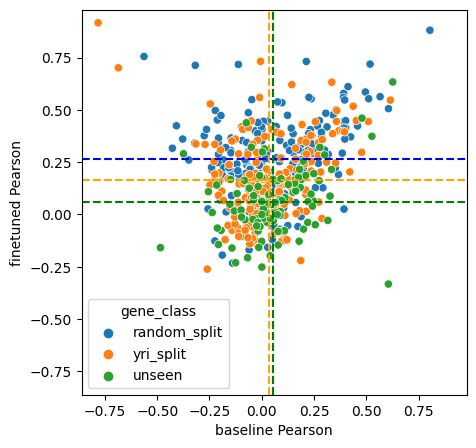

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2789080002830918

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19335757463931183

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



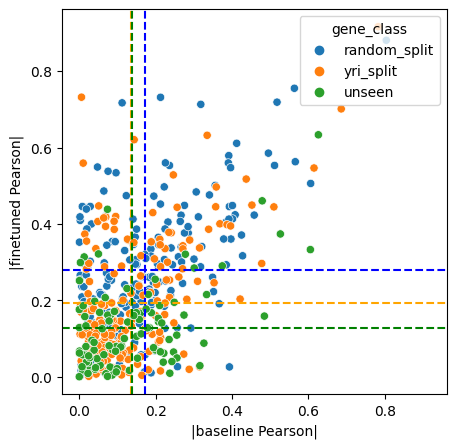

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.26310190208270184

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1650407365198555

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



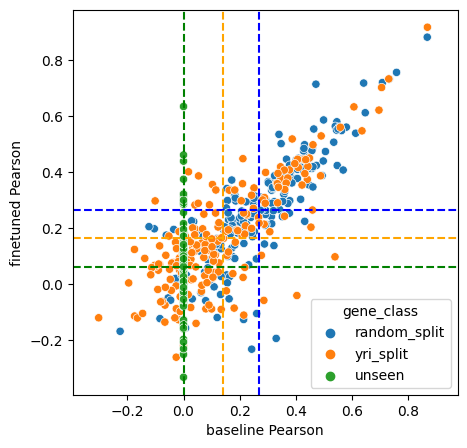

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2789080002830918

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19335757463931183

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



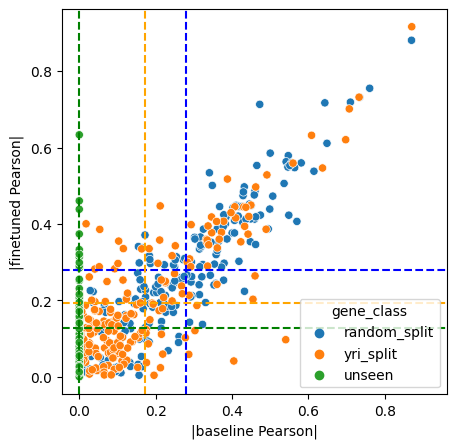

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.08


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

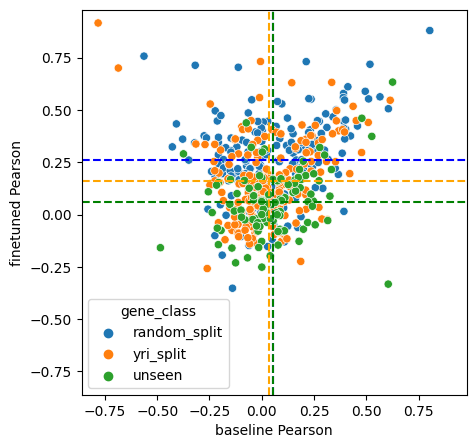

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2784130237803255

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.19385683877970727

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



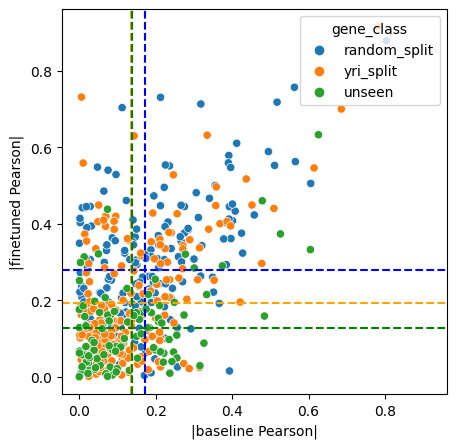

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2619800211020882

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.16263310661930547

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



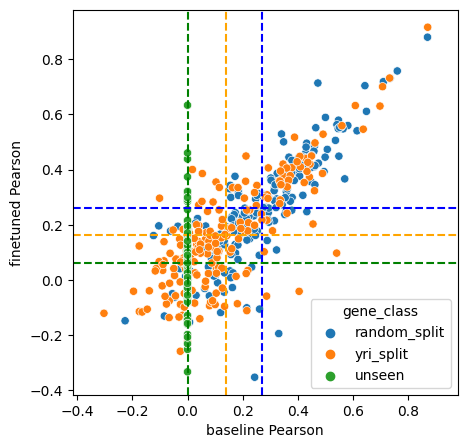

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2784130237803255

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.19385683877970727

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



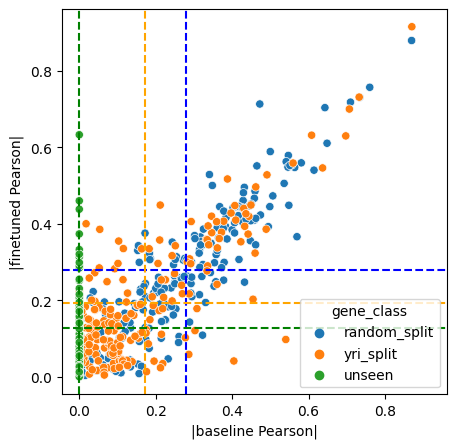

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.09


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

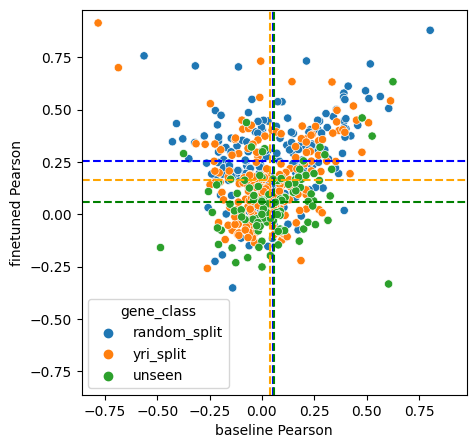

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.27437282111787586

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1922078089469269

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



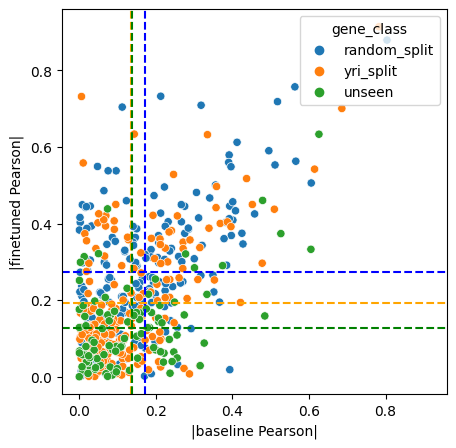

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.2570262552440734

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1615913175244821

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



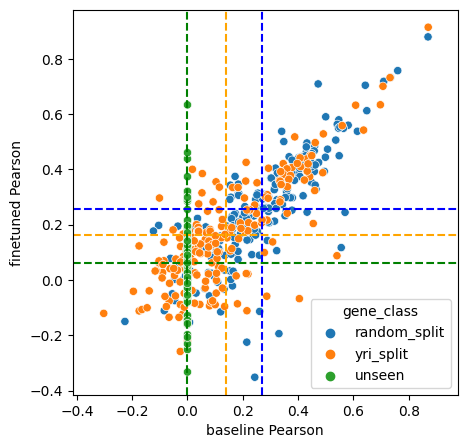

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.27437282111787586

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1922078089469269

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



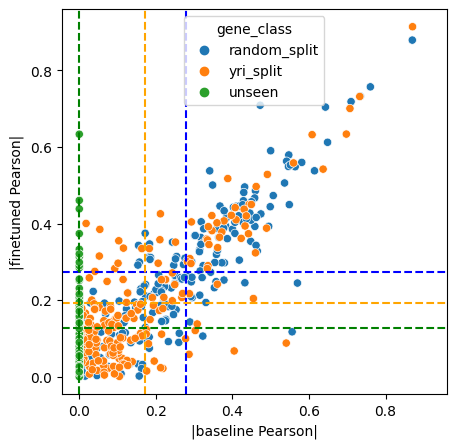

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.1


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

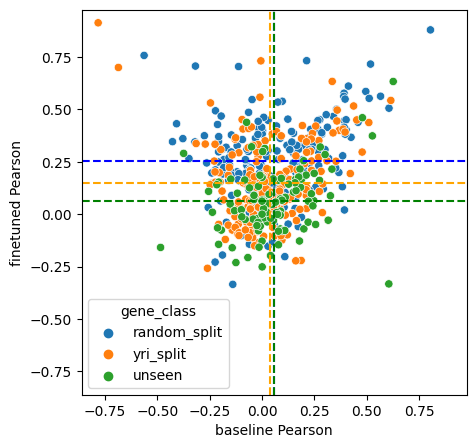

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2708660037572036

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1860416028844244

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



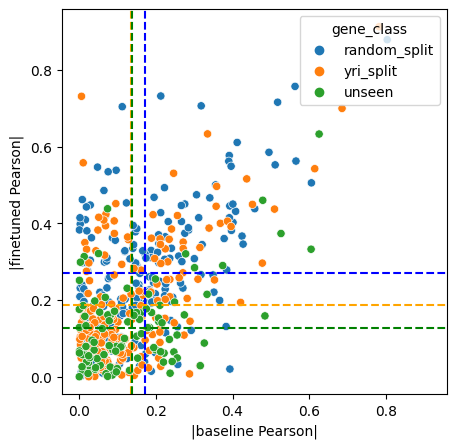

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.25251202702069153

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.15106133510867595

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



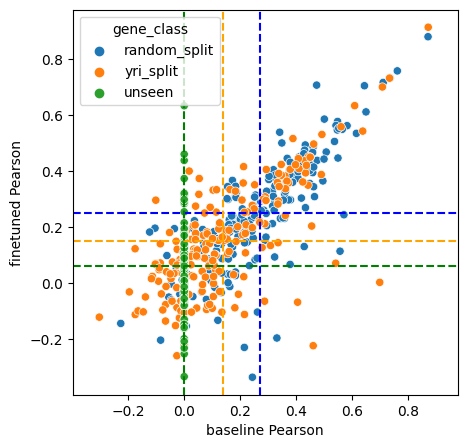

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2708660037572036

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1860416028844244

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



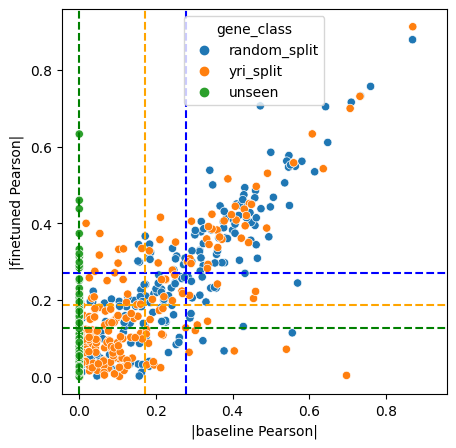

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.15


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

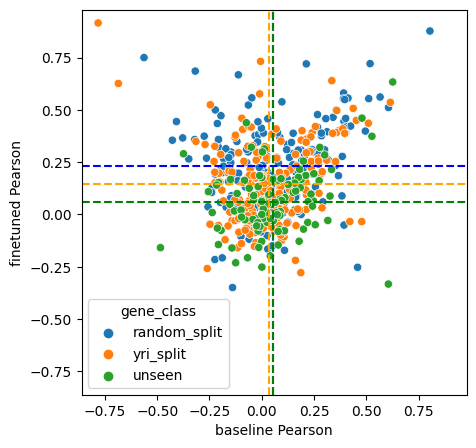

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.2538268563110709

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.18097068725065987

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



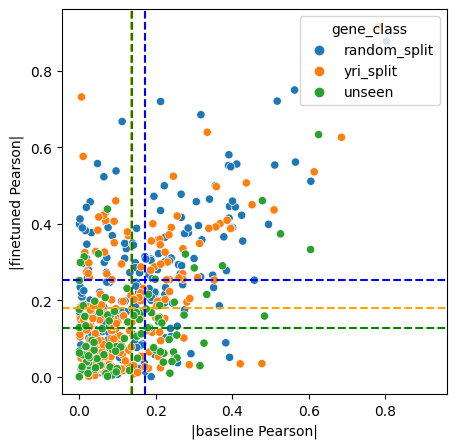

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.23083428037285622

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.14670526518251104

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



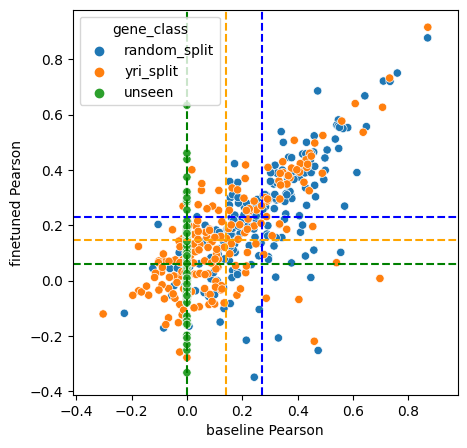

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.2538268563110709

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.18097068725065987

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



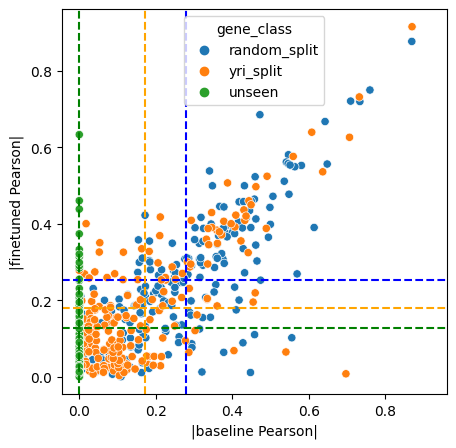

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.2


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

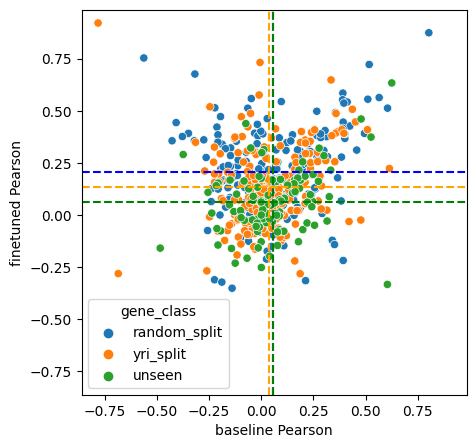

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.23972946683995464

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1723143253826135

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



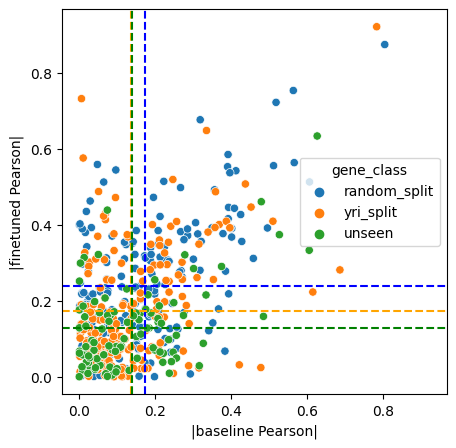

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.20588100147748914

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1339926453154695

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



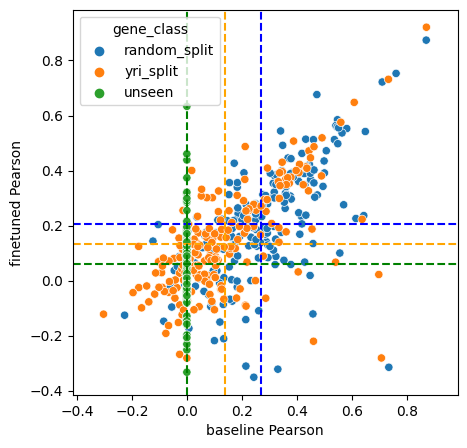

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.23972946683995464

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1723143253826135

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



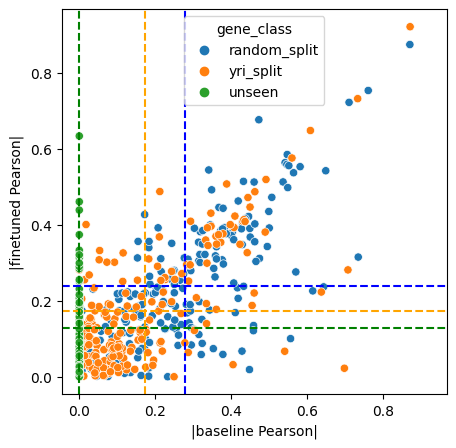

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.25


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

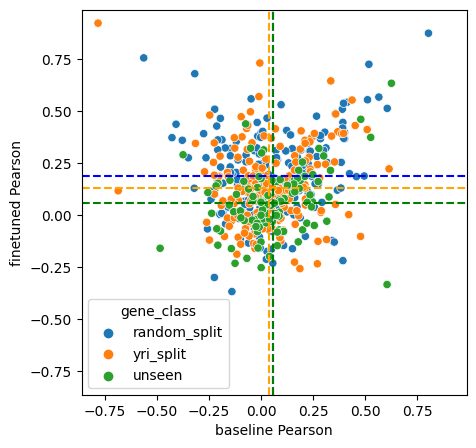

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.22461721521593467

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1682879207487574

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



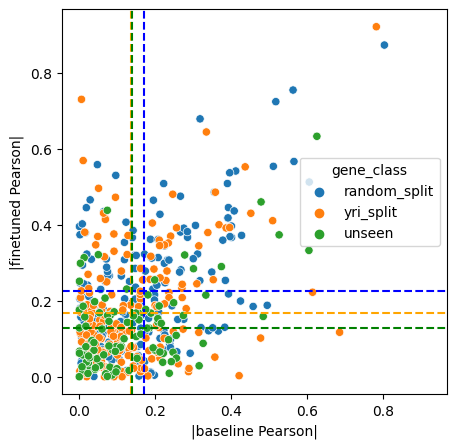

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.18980863914330684

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.13112222383541286

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



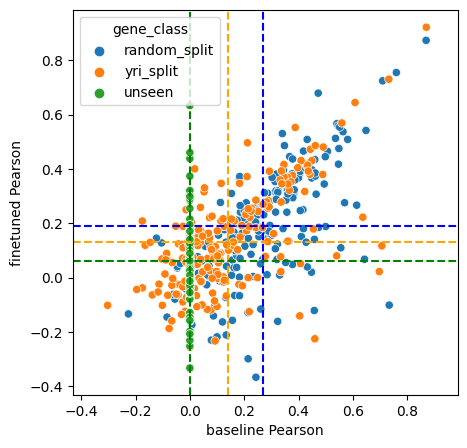

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.22461721521593467

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1682879207487574

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



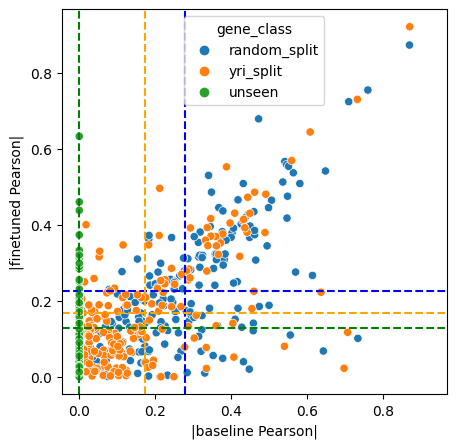

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.3


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

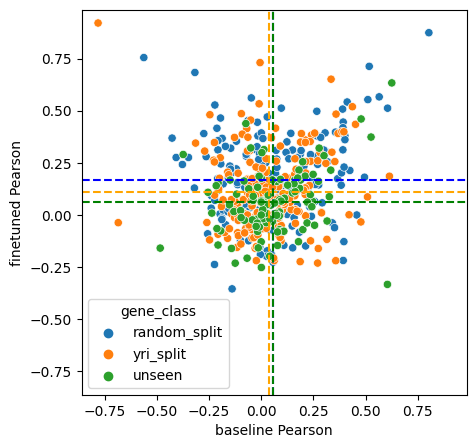

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.20849393470468322

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.16066297265128351

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



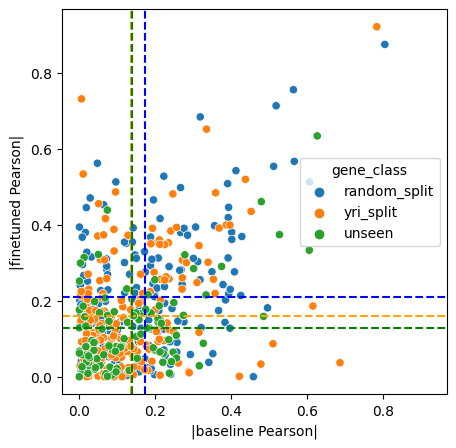

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.1696214610067752

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.1123957699899394

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



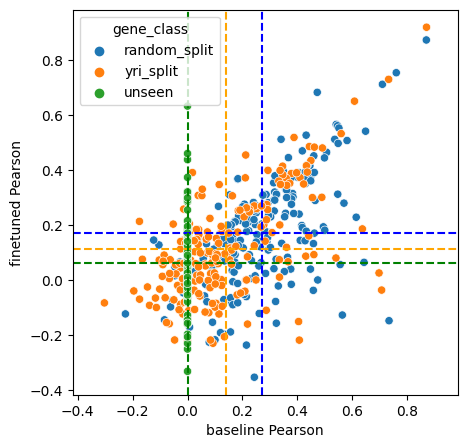

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.20849393470468322

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.16066297265128351

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



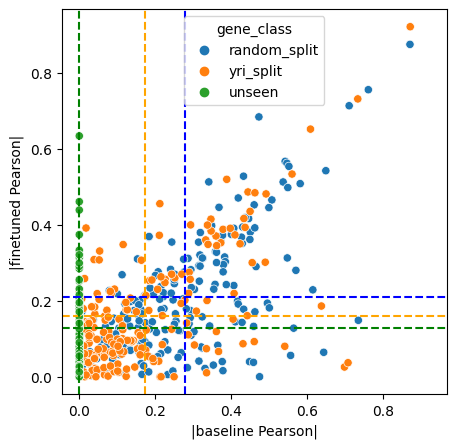

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.35


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

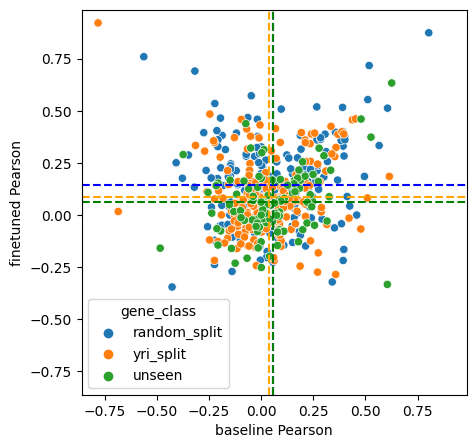

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.19359273262256907

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.14319026309813762

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



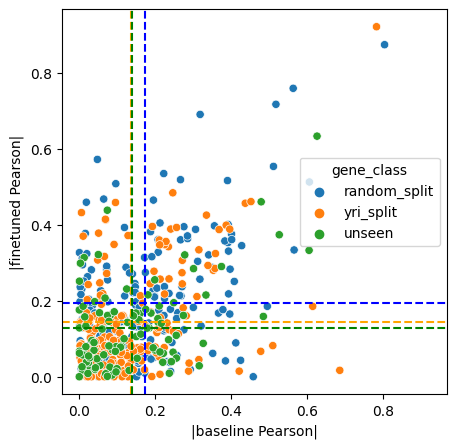

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.14503310298107494

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.08431663032738657

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



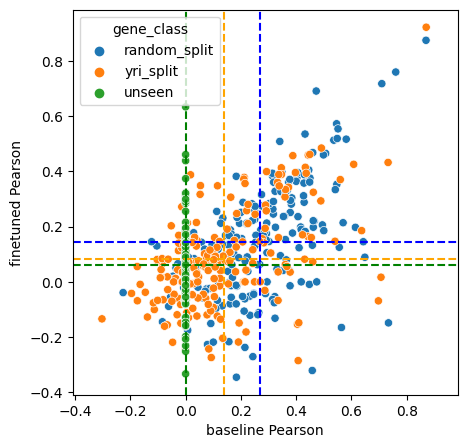

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.19359273262256907

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.14319026309813762

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



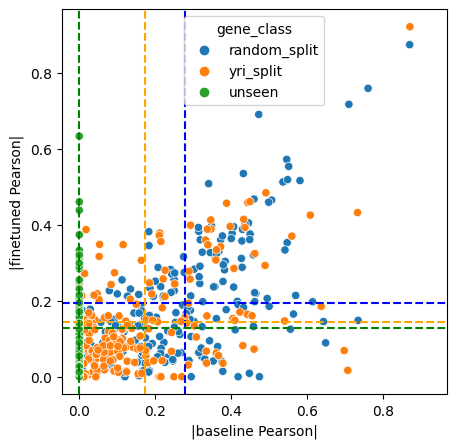

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.4


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene tmem163 has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

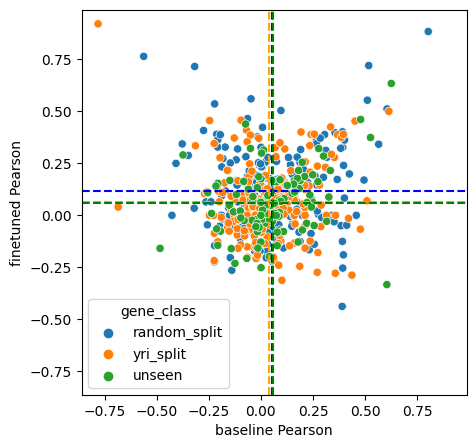

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.17738720713042064

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.13292111666508638

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



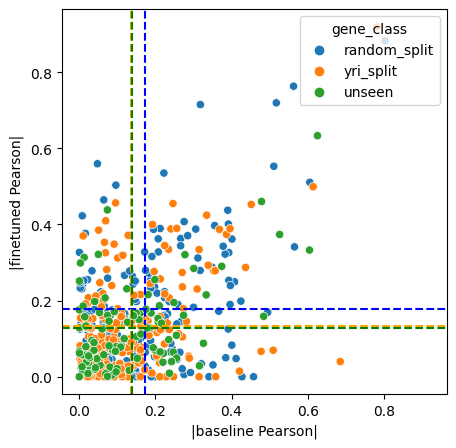

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.11863506654153314

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.06423856149008408

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



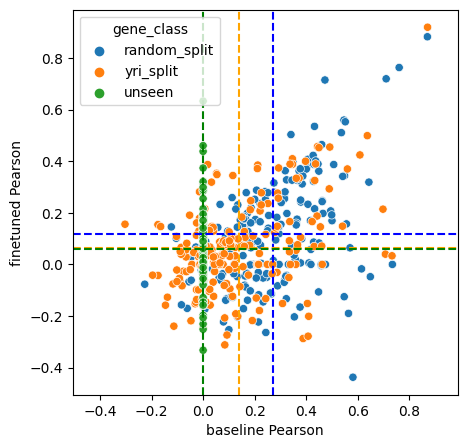

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.17738720713042064

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.13292111666508638

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



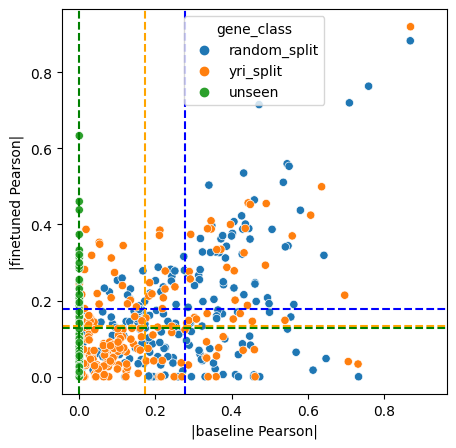

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.41
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene yipf5 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem163 has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

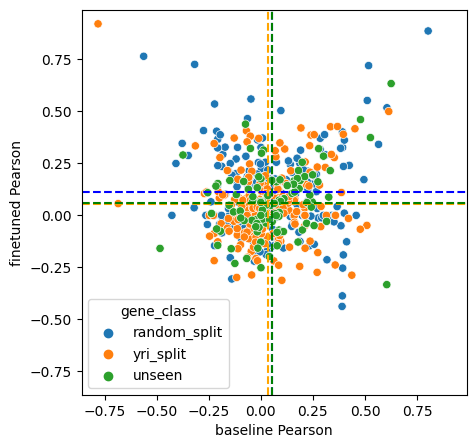

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.17165226524000837

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.12855243668803112

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



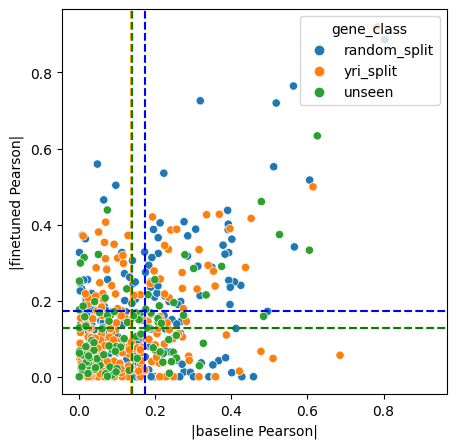

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.11154750301915746

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.05356127207394005

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



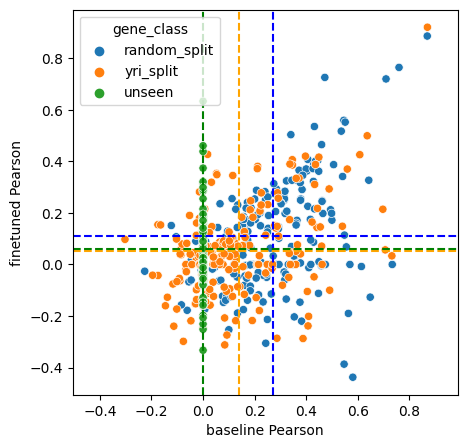

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.17165226524000837

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.12855243668803112

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



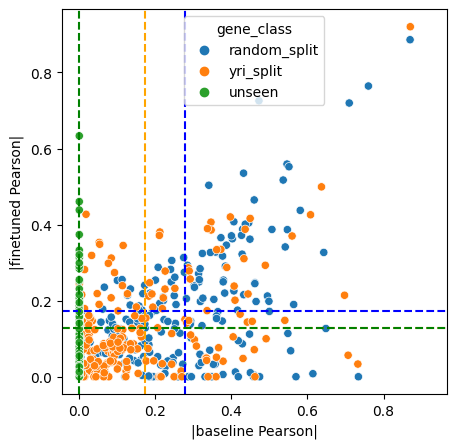

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.42


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR
Gene borcs7 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000232116 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene yipf5 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem163 has invalid predictions/counts and thus has a nan pearsonR
Gene prxl2c has invalid predictions/counts and thus has a nan pearsonR
Gene 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

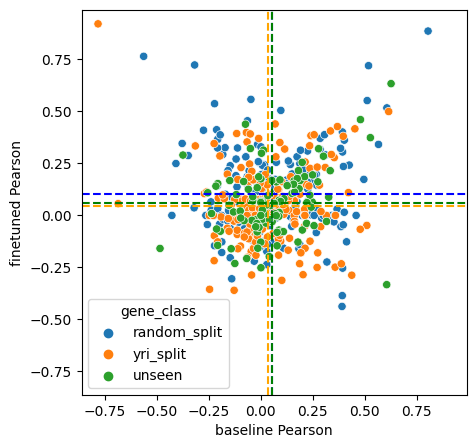

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.1639104437560973

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.12729601458569204

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



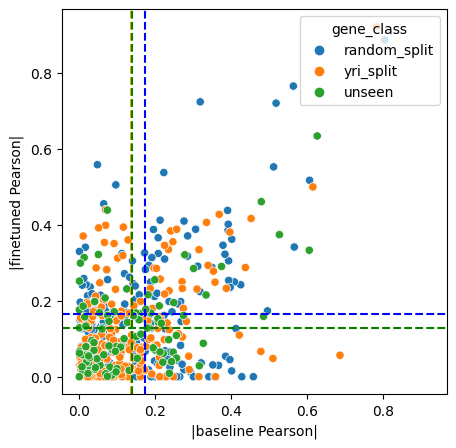

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.10286447168818352

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.046544221960860256

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



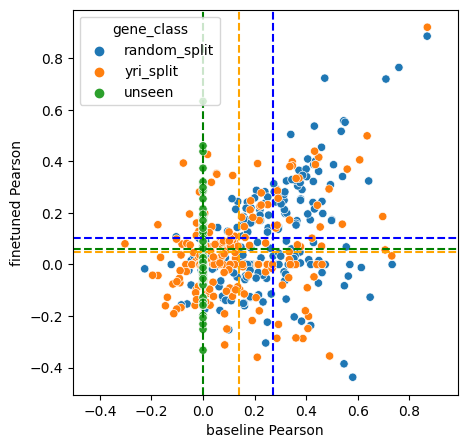

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.1639104437560973

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.12729601458569204

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



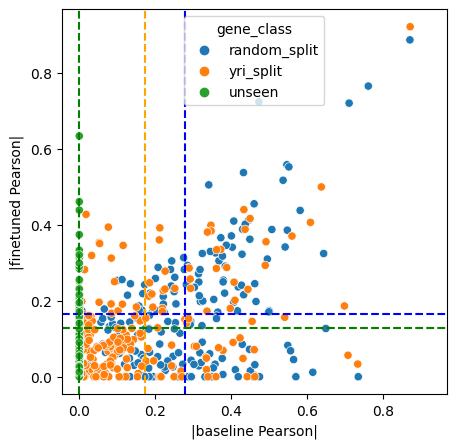

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.43


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR
Gene borcs7 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000232116 has invalid predictions/counts and thus has a nan 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene adk has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene eif4b has invalid predictions/counts and thus has a nan pearsonR
Gene tctn2 has invalid predictions/counts and thus has a nan pearsonR
Gene yipf5 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem1

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

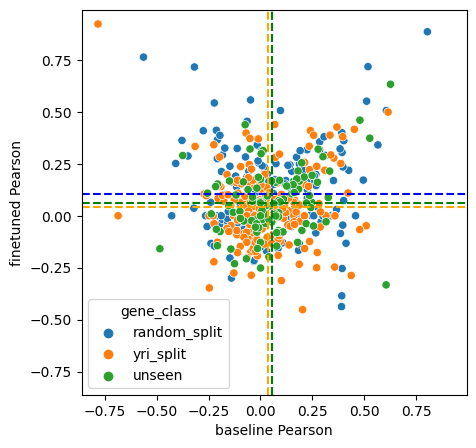

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.16158821996397368

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.12298808945752551

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



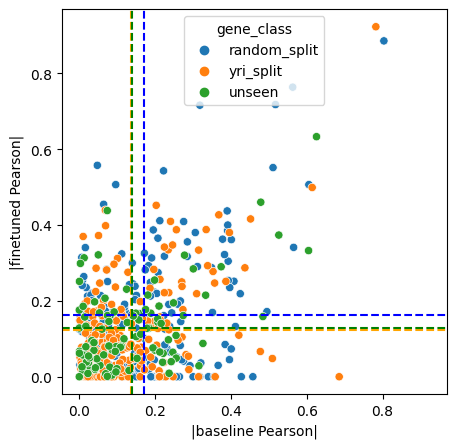

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.10386390991147493

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.043964014495791105

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



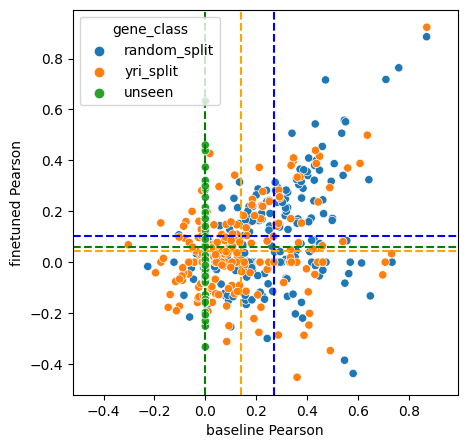

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.16158821996397368

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.12298808945752551

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



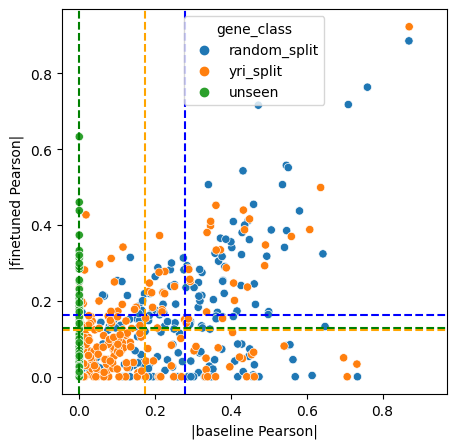

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.44
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene rabac1 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc37a3 has invalid predictions/counts and thus has a nan pearsonR
Gene cdc42bpa has invalid predictions/counts and thus has a nan pearsonR
Gene prdx5 has invalid predictions/counts and thus has a nan pearsonR
Gene borcs7 has invalid predictions/counts and thus has a nan pearson

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearsonR
Gene ftcdnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearsonR
Gene adk has invalid predictions/counts and thus has a nan pearsonR
Gene c4orf33 has invalid predictions/counts and thus has a nan pearsonR
Gene aftph has invalid predictions/counts and thus has a nan pearsonR
Gene ppip5k2 has invalid predictions/counts and thus has a nan pearsonR
Gene e

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR
Gene hyal4 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

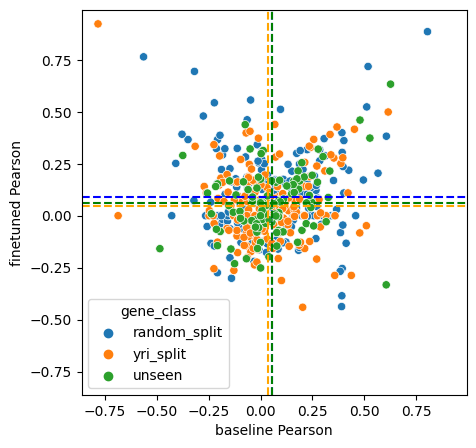

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.15646531206943678

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.1180983773155941

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



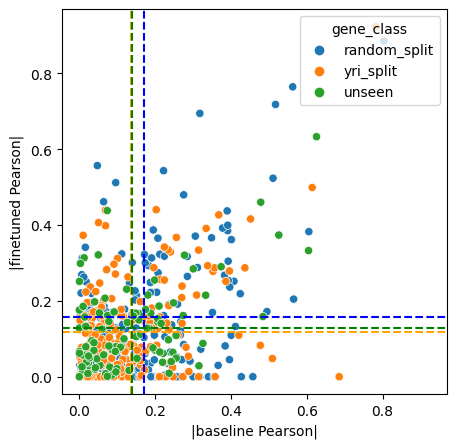

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.09246516319853482

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.04612668590365634

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



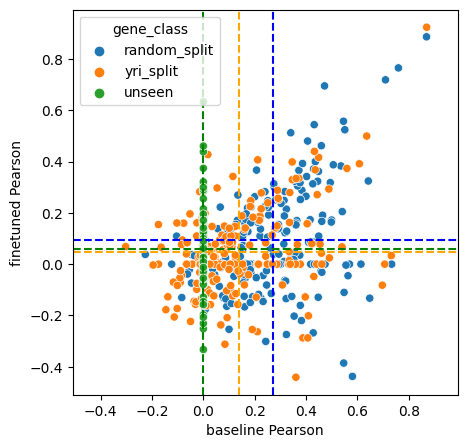

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.15646531206943678

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.1180983773155941

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



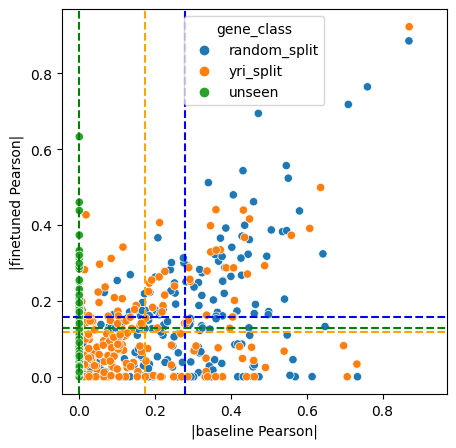

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.45


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene foxred1 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000174100 has invalid predictions/counts and thus has a nan pearsonR
Gene hebp2 has invalid predictions/counts and thus has a nan pearsonR
Gene ra

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene etv2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf283 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
Gene kptn has invalid predictions/counts and thus has a nan pearsonR
Gene rhot1 has invalid predictions/counts and thus has a nan pearsonR
G

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rps14 has invalid predictions/counts and thus has a nan pearsonR
Gene rab33b has invalid predictions/counts and thus has a nan pearsonR
Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearsonR
Gene ftcdnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pearsonR
Gene kalrn has invalid predictions/counts and thus has a nan pearson

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene mttp has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene bx088651.4 has invalid predictions/counts and thus has a nan pearsonR
Gene dmgdh has invalid predictions/counts and thus has a nan pearsonR
Gene arhgef35 has invalid predictions/counts and thus has a nan pearsonR
Ge

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

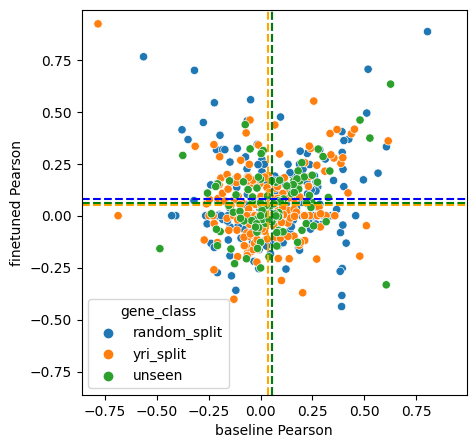

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.1502995616063013

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.11531381373800782

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



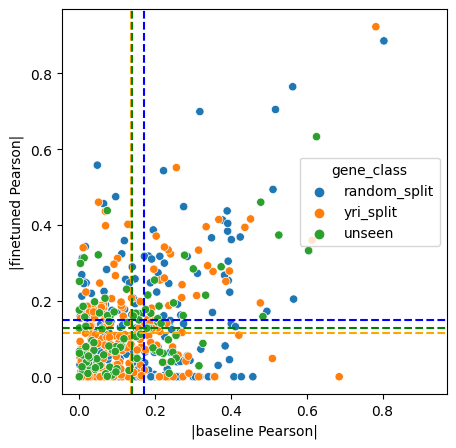

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.07820386131124826

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.05003844494795299

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



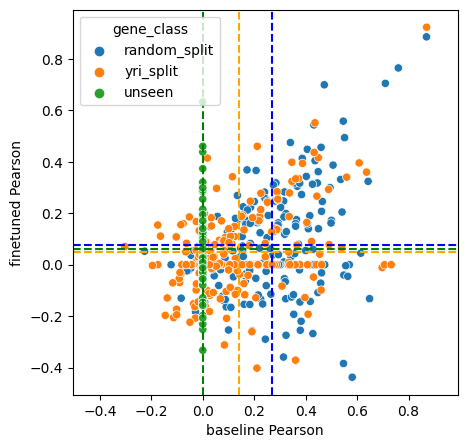

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.1502995616063013

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.11531381373800782

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



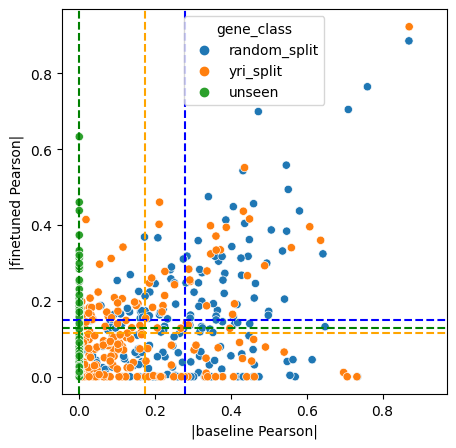

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.46


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene ap4b1 has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap35 has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx has invalid predictions/counts and thus has a nan pearsonR
Gene ighmbp2 has invalid predictions/counts and thus has a nan pearsonR
Gene c1orf216 has invalid predictions/counts and thus has a nan pearsonR
Gene foxred1 has invalid predictions/counts and thus has a nan pearsonR
Gene dxo h

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene etv2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf283 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
Gene kptn has invalid predictions/counts and thus has a nan pearsonR
Gene glul has invalid predictions/counts and thus has a nan pearsonR
Ge

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene rps14 has invalid predictions/counts and thus has a nan pearsonR
Gene linc01006 has invalid predictions/counts and thus has a nan pearsonR
Gene rab33b has invalid predictions/counts and thus has a nan pearsonR
Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4m1 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearso

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene mttp has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene itgb1 has invalid predictions/counts and thus has a nan pearsonR
Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bbs12 has invalid predictions/counts and thus has a nan pearsonR
Gene nelfb has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene rnf

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

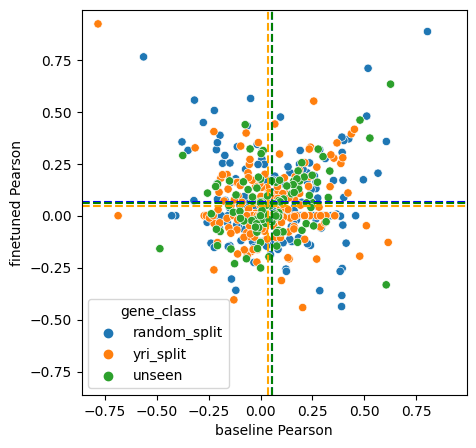

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.13977506791366096

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.10635700219542363

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



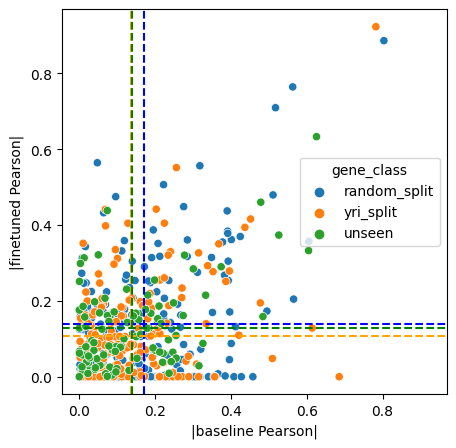

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.0654620822768258

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.04520203926731746

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



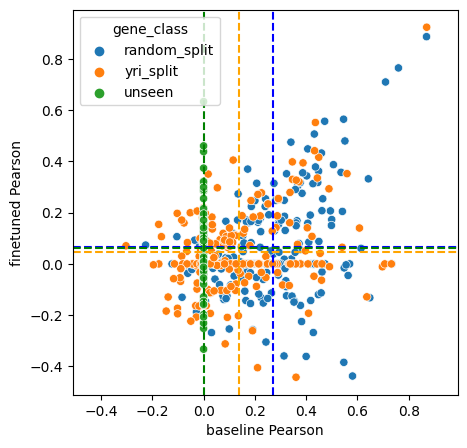

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.13977506791366096

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.10635700219542363

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



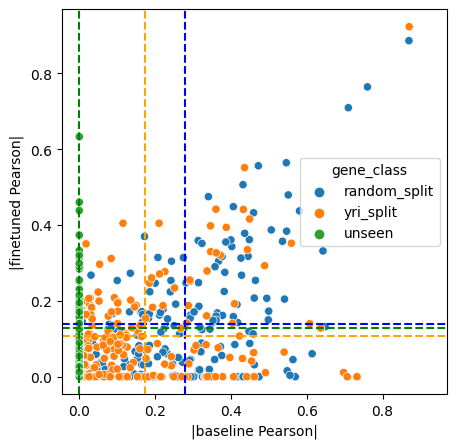

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.47
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene colca2 has invalid predictions/counts and thus has a nan pearsonR
Gene sdccag8 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4b1 has invalid predictions/counts and thus has a nan pearsonR
Gene rnf43 has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap35 has invalid predictions/counts and thus has a nan pearsonR
Gene sdhaf4 has invalid predictions/counts and thus has a nan pearsonR
Gene smtnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene pdhx ha

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene etv2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf283 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene cenpq has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene ppan has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
G

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene atp7b has invalid predictions/counts and thus has a nan pearsonR
Gene rps14 has invalid predictions/counts and thus has a nan pearsonR
Gene linc01006 has invalid predictions/counts and thus has a nan pearsonR
Gene cox17 has invalid predictions/counts and thus has a nan pearsonR
Gene rab33b has invalid predictions/counts and thus has a nan pearsonR
Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene tmtc4 has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene mttp has invalid predictions/counts and thus has a nan pearsonR
Gene nlrc4 has invalid predictions/counts and thus has a nan pearsonR
Gene hmhb1 has invalid predictions/counts and thus has a nan pearsonR
Gene p2ry1 has invalid predictions/counts and thus has a nan pearsonR
Gene itgb1 has invalid predictions/counts and thus has a nan pearsonR
Gene slc18a2 has invalid predictions/counts and thus has a nan pearsonR
Gene rfx3-as1 has invalid predictions/counts and thus has a nan pearsonR
Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene ptbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa12

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

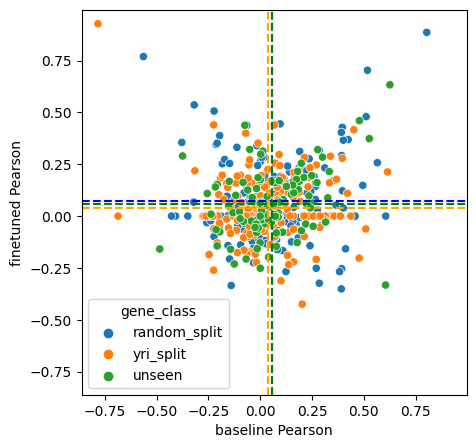

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.12713946274415866

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.09385495587081615

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



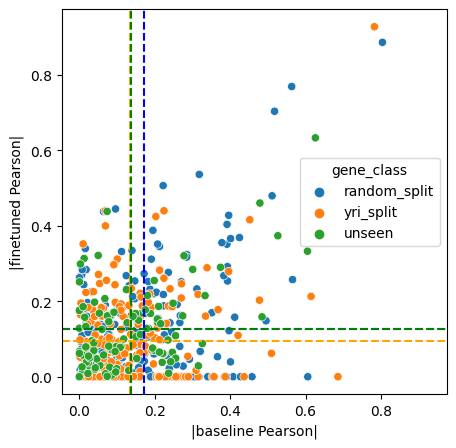

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.0706774362963224

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.03866008398496457

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



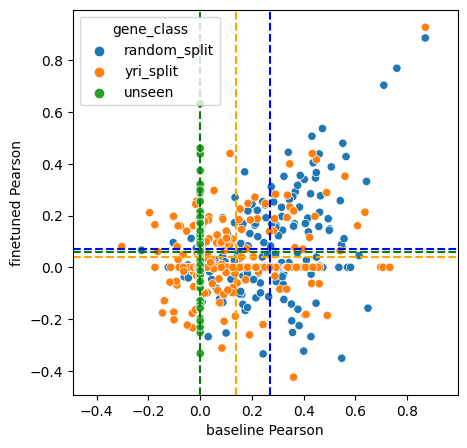

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.12713946274415866

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.09385495587081615

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



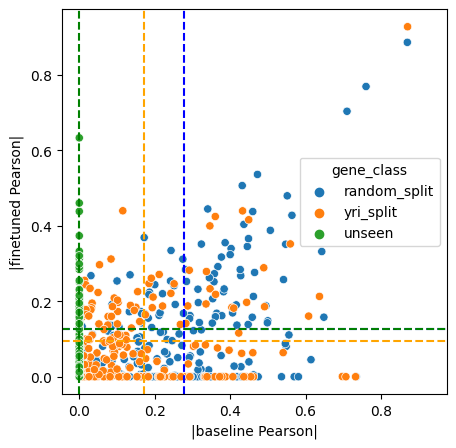

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.48
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene svbp has invalid predictions/counts and thus has a nan pearsonR
Gene exosc5 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene cd58 has invalid predictions/counts and thus has a nan pearsonR
Gene yif1a has invalid predictions/counts and thus has a nan pearsonR
Gene mag has invalid predictions/counts and thus has a nan pearsonR
Gene colca2 has invalid predictions/counts and thus has a nan pearsonR
Gene sdccag8 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4b1 has invalid predictions/counts and thus has a nan pearsonR
Gene rnf43 has invalid predictions/counts and thus has a nan pearsonR
Gene llgl1 has invalid predictions/counts and thus has a nan pearsonR
Gene coprs has invalid predictions/counts and thus has a nan pearsonR
Gene mtmr4 has invalid predictions/counts and thus has a nan pearsonR
Gene znf415 has invalid predictions/counts and thus has a nan pearsonR
Gene eif3i has inval

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene mthfr has invalid predictions/counts and thus has a nan pearsonR
Gene dmac2 has invalid predictions/counts and thus has a nan pearsonR
Gene cenpq has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR
Gene fdxr has invalid predictions/counts and thus has a nan pearsonR
Gene cct6b has invalid predictions/counts and thus has a nan pearsonR
Gene ppan has invalid predictions/counts and thus has a nan pearsonR
Gene al354740.1 has invalid predictions/counts and thus has a nan pearsonR
Gen

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene tmtc4 has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4m1 has invalid predictions/counts and thus has a nan pearsonR
Gene eif2ak3-dt has invalid predictions/counts and thus has a nan pearsonR
Gene ac108206.1 has invalid predictions/counts and thus has a nan pearsonR
Gene znf354a has invalid predictions/counts and thus has a nan pearsonR
Gene ftcdnl1 has invalid predictions/counts and thus has a nan pearsonR
Gene fgf2 has invalid predictions/counts and thus has a nan pears

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene plekha5 has invalid predictions/counts and thus has a nan pearsonR
Gene xpc has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene ptbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene bbs12 has invalid predictions/counts and thus has a nan pearsonR
Gene nelfb has invalid predictions/counts and thus has a nan pearsonR
Gene gtf2h2c has invalid predictions/counts and thus has a nan pearsonR
Gene rnf168 has invalid predictions/counts and thus has a nan pearsonR
Gene brk1 has invalid predictions/counts and thus has a nan pearsonR
Gene slc31a1

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

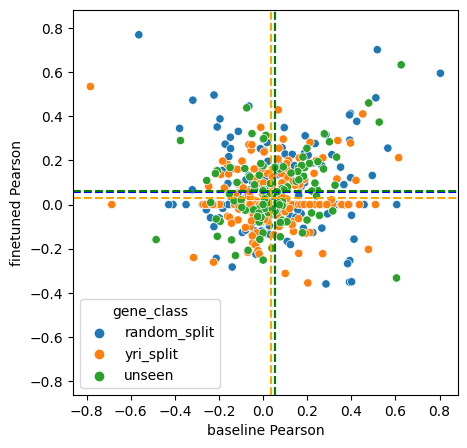

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.1151717370057171

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.07661152620731712

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



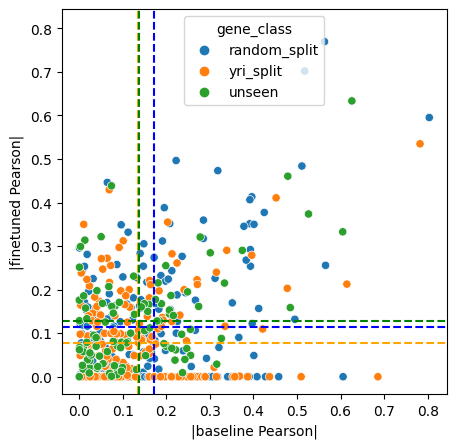

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.05858030750956132

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.028024071425020544

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



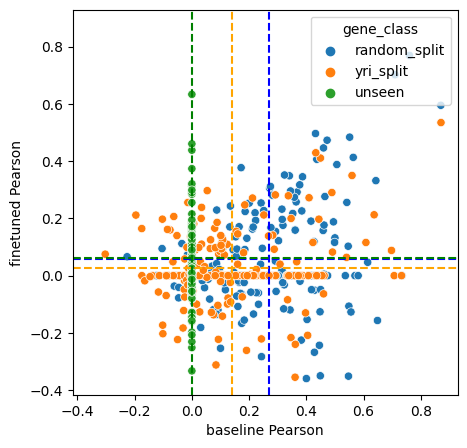

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.1151717370057171

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.07661152620731712

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



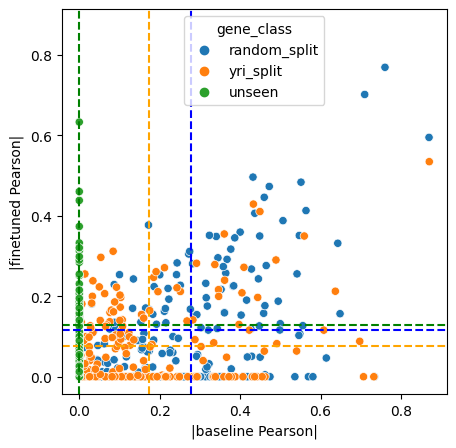

regression_data_seed_7_lr_0.0001_wd_0.001_rcprob_0.5_rsmax_3_af_0.49


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene calm3 has invalid predictions/counts and thus has a nan pearsonR
Gene rwdd2b has invalid predictions/counts and thus has a nan pearsonR
Gene acat1 has invalid predictions/counts and thus has a nan pearsonR
Gene sytl2 has invalid predictions/counts and thus has a nan pearsonR
Gene znf615 has invalid predictions/counts and thus has a nan pearsonR
Gene svbp has invalid predictions/counts and thus has a nan pearsonR
Gene al160408.3 has invalid predictions/counts and thus has a nan pearsonR
Gene exosc5 has invalid predictions/counts and thus has a nan pearsonR
Gene tpbg has invalid predictions/counts and thus has a nan pearsonR
Gene faap24 has invalid predictions/counts and thus has a nan pearsonR
Gene cd58 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000006075 has invalid predictions/counts and thus has a nan pearsonR
Gene yif1a has invalid predictions/counts and thus has a nan pearsonR
Gene mag has invalid predictions/counts and thus has a nan pearsonR
Gene c

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene linc01531 has invalid predictions/counts and thus has a nan pearsonR
Gene tmem30a has invalid predictions/counts and thus has a nan pearsonR
Gene neat1 has invalid predictions/counts and thus has a nan pearsonR
Gene mtarc2 has invalid predictions/counts and thus has a nan pearsonR
Gene rapgefl1 has invalid predictions/counts and thus has a nan pearsonR
Gene mthfr has invalid predictions/counts and thus has a nan pearsonR
Gene taf1a has invalid predictions/counts and thus has a nan pearsonR
Gene dmac2 has invalid predictions/counts and thus has a nan pearsonR
Gene cenpq has invalid predictions/counts and thus has a nan pearsonR
Gene chaf1a has invalid predictions/counts and thus has a nan pearsonR
Gene sort1 has invalid predictions/counts and thus has a nan pearsonR
Gene dram2 has invalid predictions/counts and thus has a nan pearsonR
Gene cep85 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000241768 has invalid predictions/counts and thus has a nan pearsonR

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene nup35 has invalid predictions/counts and thus has a nan pearsonR
Gene arhgap24 has invalid predictions/counts and thus has a nan pearsonR
Gene mxi1 has invalid predictions/counts and thus has a nan pearsonR
Gene ensg00000204807 has invalid predictions/counts and thus has a nan pearsonR
Gene slc16a9 has invalid predictions/counts and thus has a nan pearsonR
Gene gype has invalid predictions/counts and thus has a nan pearsonR
Gene hdhd3 has invalid predictions/counts and thus has a nan pearsonR
Gene rasa4b has invalid predictions/counts and thus has a nan pearsonR
Gene mgmt has invalid predictions/counts and thus has a nan pearsonR
Gene ac104653.1 has invalid predictions/counts and thus has a nan pearsonR
Gene tmtc4 has invalid predictions/counts and thus has a nan pearsonR
Gene tnc has invalid predictions/counts and thus has a nan pearsonR
Gene spryd3 has invalid predictions/counts and thus has a nan pearsonR
Gene ap4m1 has invalid predictions/counts and thus has a nan pearsonR
Gen

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene xpc has invalid predictions/counts and thus has a nan pearsonR
Gene cfap91 has invalid predictions/counts and thus has a nan pearsonR
Gene b3gnt7 has invalid predictions/counts and thus has a nan pearsonR
Gene lrrc27 has invalid predictions/counts and thus has a nan pearsonR
Gene sestd1 has invalid predictions/counts and thus has a nan pearsonR
Gene xpnpep1 has invalid predictions/counts and thus has a nan pearsonR
Gene acox3 has invalid predictions/counts and thus has a nan pearsonR
Gene anxa6 has invalid predictions/counts and thus has a nan pearsonR
Gene higd2a has invalid predictions/counts and thus has a nan pearsonR
Gene ptbp3 has invalid predictions/counts and thus has a nan pearsonR
Gene hadh has invalid predictions/counts and thus has a nan pearsonR
Gene fam234b has invalid predictions/counts and thus has a nan pearsonR
Gene matr3 has invalid predictions/counts and thus has a nan pearsonR
Gene kiaa1217 has invalid predictions/counts and thus has a nan pearsonR
Gene tprkb 

/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan pearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Gene golga6l9 has invalid predictions/counts and thus has a nan PearsonR


/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/clusterfs/nilah/aniketh/mamba_envs/promoter_models/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.Constan

Gene prxl2c has invalid predictions/counts and thus has a nan PearsonR
Gene csta has invalid predictions/counts and thus has a nan PearsonR
Gene hadh has invalid predictions/counts and thus has a nan PearsonR
Gene prune2 has invalid predictions/counts and thus has a nan PearsonR
Gene sec24b-as1 has invalid predictions/counts and thus has a nan PearsonR
Gene ac090825.1 has no predictions/counts and thus has a nan PearsonR
Gene dhrs4 has no predictions/counts and thus has a nan PearsonR
Gene cables2 has no predictions/counts and thus has a nan PearsonR
Gene srp14-as1 has no predictions/counts and thus has a nan PearsonR
Gene ac092384.1 has no predictions/counts and thus has a nan PearsonR
Gene rab15 has no predictions/counts and thus has a nan PearsonR
Gene blk has no predictions/counts and thus has a nan PearsonR
Gene hdgfl3 has no predictions/counts and thus has a nan PearsonR
Gene flywch2 has no predictions/counts and thus has a nan PearsonR
Gene csnk2a2 has no predictions/counts and 

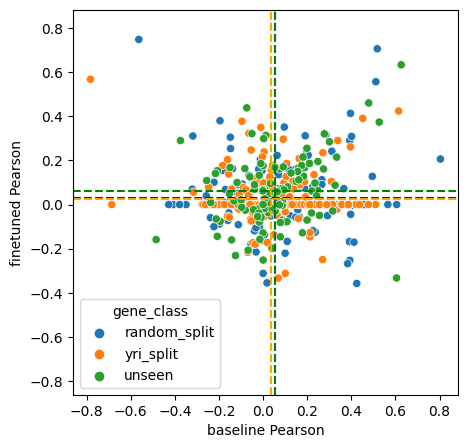

Split random_split, n_samples = 200
Baseline PearsonR = 0.17172838115005112
Finetuned PearsonR = 0.07633782595391883

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13530466452619097
Finetuned PearsonR = 0.05254743220272127

Split unseen, n_samples = 100
Baseline PearsonR = 0.1377850687128737
Finetuned PearsonR = 0.12745238395613798



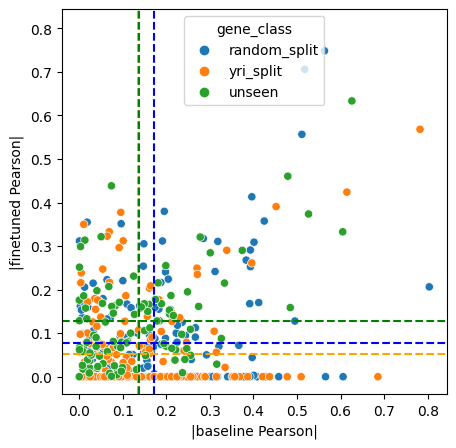

Split random_split, n_samples = 200
Baseline PearsonR = 0.27017093395111663
Finetuned PearsonR = 0.03121271163380688

Split yri_split, n_samples = 200
Baseline PearsonR = 0.13937764361090668
Finetuned PearsonR = 0.02512124335894218

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.060495804249331424



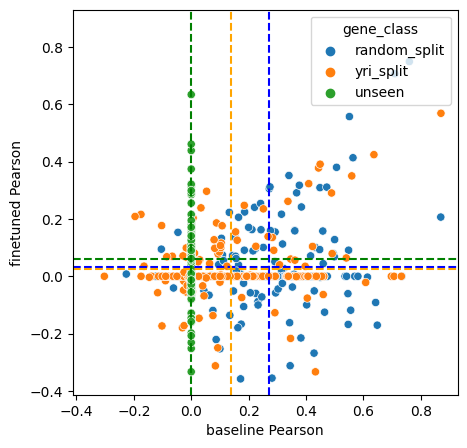

Split random_split, n_samples = 200
Baseline PearsonR = 0.27848743980329327
Finetuned PearsonR = 0.07633782595391883

Split yri_split, n_samples = 200
Baseline PearsonR = 0.17221796929297573
Finetuned PearsonR = 0.05254743220272127

Split unseen, n_samples = 100
Baseline PearsonR = 0.0
Finetuned PearsonR = 0.12745238395613798



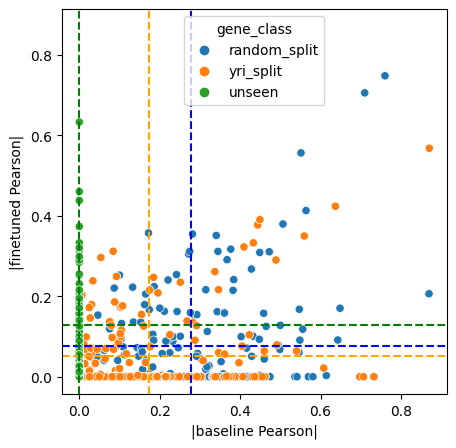

In [6]:
summary_df = {}
summary_df["Model"] = []
summary_df["random_split Genes Avg PearsonR"] = []
summary_df["yri_split Genes Avg PearsonR"] = []
summary_df["unseen Genes Avg PearsonR"] = []
summary_df["random_split Genes Avg |PearsonR|"] = []
summary_df["yri_split Genes Avg |PearsonR|"] = []
summary_df["unseen Genes Avg |PearsonR|"] = []

for model in ALL_PREDS_PATHS:
    print(model)
    
    if len(summary_df["Model"]) == 0:
        summary_df["Model"].append("Baseline Enformer")
    
    summary_df["Model"].append(model)

    if len(summary_df["Model"]) == 2:
        summary_df["Model"].append("PrediXcan")
    
    PREDS_PATH = ALL_PREDS_PATHS[model]
    finetuned_preds, ancestries_by_gene = load_finetuned_preds(PREDS_PATH)
    finetuned_corrs = get_finetuned_corrs(finetuned_preds, geuvadis_df)
    baseline_corrs = get_other_model_corrs(baseline_df, geuvadis_df, finetuned_preds)
    predixcan_corrs = get_other_model_corrs(predixcan_df, geuvadis_df, finetuned_preds)

    # baseline Enformer
    fig, axs = plt.subplots(ncols=1, figsize=(10, 5))
    s = compare_finetuned_to_baseline_perf(
        finetuned_corrs, baseline_corrs, finetuned_preds, ancestries_by_gene
    )
    
    for split in ["random_split", "yri_split", "unseen"]:
        if len(summary_df[f"{split} Genes Avg PearsonR"]) == 0:
            summary_df[f"{split} Genes Avg PearsonR"].append(s["Baseline " + split])
        
        summary_df[f"{split} Genes Avg PearsonR"].append(s["Finetuned " + split])

    # baseline Enformer absolute performance
    fig, axs = plt.subplots(ncols=1, figsize=(10, 5))
    s = compare_finetuned_to_baseline_perf(
        finetuned_corrs, baseline_corrs, finetuned_preds, ancestries_by_gene, abs_corrs=True
    )
    
    for split in ["random_split", "yri_split", "unseen"]:
        if len(summary_df[f"{split} Genes Avg |PearsonR|"]) == 0:
            summary_df[f"{split} Genes Avg |PearsonR|"].append(s["Baseline " + split])
        
        summary_df[f"{split} Genes Avg |PearsonR|"].append(s["Finetuned " + split])

    # PrediXcan
    fig, axs = plt.subplots(ncols=1, figsize=(10, 5))
    s = compare_finetuned_to_baseline_perf(
        finetuned_corrs, predixcan_corrs, finetuned_preds, ancestries_by_gene
    )
    
    for split in ["random_split", "yri_split", "unseen"]:
        if len(summary_df[f"{split} Genes Avg PearsonR"]) == 2:
            summary_df[f"{split} Genes Avg PearsonR"].append(s["Baseline " + split])

    # PrediXcan absolute performance
    fig, axs = plt.subplots(ncols=1, figsize=(10, 5))
    s = compare_finetuned_to_baseline_perf(
        finetuned_corrs, predixcan_corrs, finetuned_preds, ancestries_by_gene, abs_corrs=True
    )
    
    for split in ["random_split", "yri_split", "unseen"]:
        if len(summary_df[f"{split} Genes Avg |PearsonR|"]) == 2:
            summary_df[f"{split} Genes Avg |PearsonR|"].append(s["Baseline " + split])
        
summary_df = pd.DataFrame(summary_df)

In [7]:
summary_df

,Model,random_split Genes Avg PearsonR,yri_split Genes Avg PearsonR,unseen Genes Avg PearsonR,random_split Genes Avg |PearsonR|,yri_split Genes Avg |PearsonR|,unseen Genes Avg |PearsonR|
0,Baseline Enformer,0.055015,0.036394,0.055850,0.171728,0.135305,0.137785
1,classification_data_seed_42_lr_0.0001_wd_0.001...,0.284497,0.167187,0.058410,0.290330,0.195299,0.137000
2,PrediXcan,0.270171,0.139378,0.000000,0.278487,0.172218,0.000000
3,classification_data_seed_97_lr_0.0001_wd_0.001...,0.287295,0.170668,0.020060,0.292473,0.195429,0.133765
4,classification_data_seed_7_lr_0.0001_wd_0.001_...,0.280234,0.154500,0.051495,0.287485,0.188440,0.121657
...,...,...,...,...,...,...,...
99,regression_data_seed_7_lr_0.0001_wd_0.001_rcpr...,0.078204,0.050038,0.060496,0.150300,0.115314,0.127452
100,regression_data_seed_7_lr_0.0001_wd_0.001_rcpr...,0.065462,0.045202,0.060496,0.139775,0.106357,0.127452
101,regression_data_seed_7_lr_0.0001_wd_0.001_rcpr...,0.070677,0.038660,0.060496,0.127139,0.093855,0.127452
102,regression_data_seed_7_lr_0.0001_wd_0.001_rcpr...,0.058580,0.028024,0.060496,0.115172,0.076612,0.127452


# Generate figure comparing all methods

In [8]:
model_type = []
replicate = []
subsample_ratio = []
min_af = []

for i in range(summary_df.shape[0]):
    row = summary_df.iloc[i]
    if row["Model"].startswith("classification_"):
        model_type.append("Pairwise \nClassification")
        replicate.append(int(row["Model"].split("data_seed_")[-1].split("_")[0]))
        subsample_ratio.append(-1)
        min_af.append(-1)
        
    elif row["Model"].startswith("regression_"):
        replicate.append(int(row["Model"].split("data_seed_")[-1].split("_")[0]))
        if "subsample" in row["Model"]:
            subsample_ratio.append(float(row["Model"].split("subsample_ratio_")[-1]))
            min_af.append(-1)
            model_type.append("Pairwise \nRegression \nwith {}% of Samples".format(int(subsample_ratio[-1] * 100)))
        else:
            subsample_ratio.append(1.0)
            if "_af_" in row["Model"]:
                min_af.append(float(row["Model"].split("_af_")[-1]))
                model_type.append("Pairwise \nRegression")
            else:
                min_af.append(0.0)
                model_type.append("Pairwise \nRegression")
            
    elif row["Model"].startswith("single_regression_"):
        model_type.append("Single Sample \nRegression")
        replicate.append(int(row["Model"].split("data_seed_")[-1].split("_")[0]))
        subsample_ratio.append(-1)
        min_af.append(-1)
        
    elif row["Model"].startswith("joint_classification_"):
        model_type.append("Pairwise \nClassification \nwith Joint Training")
        replicate.append(int(row["Model"].split("data_seed_")[-1].split("_")[0]))
        subsample_ratio.append(-1)
        min_af.append(-1)
        
    elif row["Model"].startswith("joint_regression_"):
        model_type.append("Pairwise \nRegression \nwith Joint Training")
        replicate.append(int(row["Model"].split("data_seed_")[-1].split("_")[0]))
        subsample_ratio.append(-1)
        min_af.append(-1)
        
    else:
        model_type.append(row["Model"])
        replicate.append(0)
        subsample_ratio.append(-1)
        min_af.append(-1)
        
summary_df["Model Type"] = model_type
summary_df["Replicate"] = replicate
summary_df["Subsample Ratio"] = subsample_ratio
summary_df["Min AF"] = min_af

In [9]:
summary_df

,Model,random_split Genes Avg PearsonR,yri_split Genes Avg PearsonR,unseen Genes Avg PearsonR,random_split Genes Avg |PearsonR|,yri_split Genes Avg |PearsonR|,unseen Genes Avg |PearsonR|,Model Type,Replicate,Subsample Ratio,Min AF
0,Baseline Enformer,0.055015,0.036394,0.055850,0.171728,0.135305,0.137785,Baseline Enformer,0,-1.0,-1.00
1,classification_data_seed_42_lr_0.0001_wd_0.001...,0.284497,0.167187,0.058410,0.290330,0.195299,0.137000,Pairwise \nClassification,42,-1.0,-1.00
2,PrediXcan,0.270171,0.139378,0.000000,0.278487,0.172218,0.000000,PrediXcan,0,-1.0,-1.00
3,classification_data_seed_97_lr_0.0001_wd_0.001...,0.287295,0.170668,0.020060,0.292473,0.195429,0.133765,Pairwise \nClassification,97,-1.0,-1.00
4,classification_data_seed_7_lr_0.0001_wd_0.001_...,0.280234,0.154500,0.051495,0.287485,0.188440,0.121657,Pairwise \nClassification,7,-1.0,-1.00
...,...,...,...,...,...,...,...,...,...,...,...
99,regression_data_seed_7_lr_0.0001_wd_0.001_rcpr...,0.078204,0.050038,0.060496,0.150300,0.115314,0.127452,Pairwise \nRegression,7,1.0,0.45
100,regression_data_seed_7_lr_0.0001_wd_0.001_rcpr...,0.065462,0.045202,0.060496,0.139775,0.106357,0.127452,Pairwise \nRegression,7,1.0,0.46
101,regression_data_seed_7_lr_0.0001_wd_0.001_rcpr...,0.070677,0.038660,0.060496,0.127139,0.093855,0.127452,Pairwise \nRegression,7,1.0,0.47
102,regression_data_seed_7_lr_0.0001_wd_0.001_rcpr...,0.058580,0.028024,0.060496,0.115172,0.076612,0.127452,Pairwise \nRegression,7,1.0,0.48


In [10]:
plot_df = {}
plot_df["Model Type"] = []
plot_df["Replicate"] = []
plot_df["Gene Classes"] = []
plot_df["Pearson Correlation"] = []
# plot_df["Abs Pearson Correlation"] = []

for i in range(summary_df.shape[0]):
    row = summary_df.iloc[i]
    
    if ((row["Subsample Ratio"] != -1) and (row["Subsample Ratio"] != 1)) or ("_af_" in row["Model"]):
        continue        
    
    plot_df["Model Type"].append(row["Model Type"])
    plot_df["Replicate"].append(row["Replicate"])
    plot_df["Gene Classes"].append("Random Split Genes")
    plot_df["Pearson Correlation"].append(row["random_split Genes Avg PearsonR"])
#     plot_df["Abs Pearson Correlation"].append(row["random_split Genes Avg |PearsonR|"])
    
    plot_df["Model Type"].append(row["Model Type"])
    plot_df["Replicate"].append(row["Replicate"])
    plot_df["Gene Classes"].append("Population Split Genes")
    plot_df["Pearson Correlation"].append(row["yri_split Genes Avg PearsonR"])
#     plot_df["Abs Pearson Correlation"].append(row["yri_split Genes Avg |PearsonR|"])
    
    plot_df["Model Type"].append(row["Model Type"])
    plot_df["Replicate"].append(row["Replicate"])
    plot_df["Gene Classes"].append("Unseen Genes")
    plot_df["Pearson Correlation"].append(row["unseen Genes Avg PearsonR"])
#     plot_df["Abs Pearson Correlation"].append(row["unseen Genes Avg |PearsonR|"])

    if row["Model"] == "Baseline Enformer":
        plot_df["Model Type"].append("|Baseline Enformer|")
        plot_df["Replicate"].append(row["Replicate"])
        plot_df["Gene Classes"].append("Random Split Genes")
        plot_df["Pearson Correlation"].append(row["random_split Genes Avg |PearsonR|"])
    #     plot_df["Abs Pearson Correlation"].append(row["random_split Genes Avg |PearsonR|"])
        
        plot_df["Model Type"].append("|Baseline Enformer|")
        plot_df["Replicate"].append(row["Replicate"])
        plot_df["Gene Classes"].append("Population Split Genes")
        plot_df["Pearson Correlation"].append(row["yri_split Genes Avg |PearsonR|"])
    #     plot_df["Abs Pearson Correlation"].append(row["yri_split Genes Avg |PearsonR|"])
        
        plot_df["Model Type"].append("|Baseline Enformer|")
        plot_df["Replicate"].append(row["Replicate"])
        plot_df["Gene Classes"].append("Unseen Genes")
        plot_df["Pearson Correlation"].append(row["unseen Genes Avg |PearsonR|"])
    #     plot_df["Abs Pearson Correlation"].append(row["unseen Genes Avg |PearsonR|"])
    
plot_df = pd.DataFrame(plot_df)

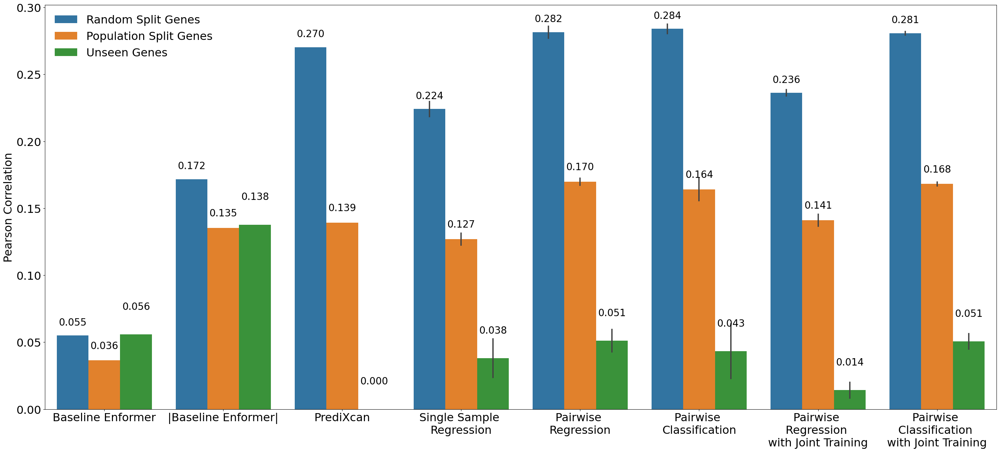

In [11]:
fontsize = 18
plt.rcParams.update({'font.size': fontsize+5})
matplotlib.rc('xtick', labelsize=fontsize+5) 
matplotlib.rc('ytick', labelsize=fontsize+5)
fig, ax = plt.subplots(figsize=(35, 15))

sns.barplot(data=plot_df, x="Model Type", y="Pearson Correlation", hue="Gene Classes", errorbar="sd", ax=ax,
           order=["Baseline Enformer", 
                  "|Baseline Enformer|", 
                  "PrediXcan", 
                  "Single Sample \nRegression", 
                  "Pairwise \nRegression", 
                  "Pairwise \nClassification", 
                  "Pairwise \nRegression \nwith Joint Training",
                  "Pairwise \nClassification \nwith Joint Training",])
ax.bar_label(ax.containers[0], fontsize=fontsize+2, padding=17, fmt="%.3f")
ax.bar_label(ax.containers[1], fontsize=fontsize+2, padding=20, fmt="%.3f")
ax.bar_label(ax.containers[2], fontsize=fontsize+2, padding=47, fmt="%.3f")
plt.xlabel("")
plt.legend(frameon=False)
# ax.spines['top'].set_visible(False)
# ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)

os.makedirs("figures", exist_ok=True)
plt.savefig("figures/fig_1_comparison_of_all_methods.pdf")
# plt.tick_params(axis="x", labelrotation=45)

# Generate figure showing how performance scales with number of samples

In [12]:
plot_df = {}
plot_df["Subsample Ratio"] = []
plot_df["% of Samples Used for Training"] = []
plot_df["Replicate"] = []
plot_df["Gene Classes"] = []
plot_df["Pearson Correlation"] = []
# plot_df["Abs Pearson Correlation"] = []

for i in range(1, summary_df.shape[0]):
    row = summary_df.iloc[i]
    
    if row["Subsample Ratio"] == -1 or "_af_" in row["Model"]:
        continue        
    
    plot_df["Subsample Ratio"].append(row["Subsample Ratio"])
    plot_df["% of Samples Used for Training"].append(int(row["Subsample Ratio"]*100))
    plot_df["Replicate"].append(row["Replicate"])
    plot_df["Gene Classes"].append("Random Split Genes")
    plot_df["Pearson Correlation"].append(row["random_split Genes Avg PearsonR"])
#     plot_df["Abs Pearson Correlation"].append(row["random_split Genes Avg |PearsonR|"])
    
    plot_df["Subsample Ratio"].append(row["Subsample Ratio"])
    plot_df["% of Samples Used for Training"].append(int(row["Subsample Ratio"]*100))
    plot_df["Replicate"].append(row["Replicate"])
    plot_df["Gene Classes"].append("Population Split Genes")
    plot_df["Pearson Correlation"].append(row["yri_split Genes Avg PearsonR"])
#     plot_df["Abs Pearson Correlation"].append(row["yri_split Genes Avg |PearsonR|"])
    
    plot_df["Subsample Ratio"].append(row["Subsample Ratio"])
    plot_df["% of Samples Used for Training"].append(int(row["Subsample Ratio"]*100))
    plot_df["Replicate"].append(row["Replicate"])
    plot_df["Gene Classes"].append("Unseen Genes")
    plot_df["Pearson Correlation"].append(row["unseen Genes Avg PearsonR"])
#     plot_df["Abs Pearson Correlation"].append(row["unseen Genes Avg |PearsonR|"])
    
plot_df = pd.DataFrame(plot_df)

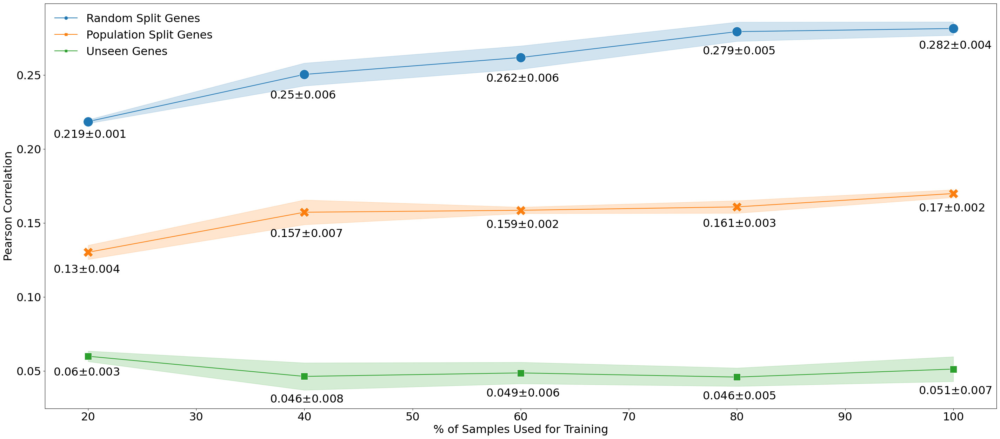

In [13]:
fontsize = 18
plt.rcParams.update({'font.size': fontsize+5})
matplotlib.rc('xtick', labelsize=fontsize+5) 
matplotlib.rc('ytick', labelsize=fontsize+5)
fig, ax = plt.subplots(figsize=(35, 15))

sns.lineplot(data=plot_df, 
             x="% of Samples Used for Training", 
             style="Gene Classes",
             y="Pearson Correlation", 
             hue="Gene Classes", 
             errorbar="sd", 
             ax=ax,
             markers=True, dashes=False, markersize=20,
#              err_style="bars",
             hue_order=["Random Split Genes", "Population Split Genes", "Unseen Genes"])

# label points on the plot
for x in set(plot_df["% of Samples Used for Training"]):
    for hue in set(plot_df["Gene Classes"]):
        corrs = plot_df[(plot_df["% of Samples Used for Training"] == x) & (plot_df["Gene Classes"] == hue)]["Pearson Correlation"]
        disp = f"{np.mean(corrs).round(3)}" + r"$\pm$" + f"{np.std(corrs).round(3)}"
    
        plt.text(x = x - 3.2, # x-coordinate position of data label
                 y = np.mean(corrs) - np.std(corrs) - 0.01, # y-coordinate position of data label, adjusted to be 150 below the data point
                 s = disp, # data label, formatted to ignore decimals
                 color = "black") # set colour of line

plt.legend(frameon=False)
# ax.spines['top'].set_visible(False)
# ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)

plt.savefig("figures/fig_1_perf_vs_num_samples.pdf")
# plt.tick_params(axis="x", labelrotation=45)

# Generate figure showing how performance scales with min AF of variants

In [14]:
plot_df = {}
plot_df["Min AF"] = []
plot_df["% Min AF"] = []
plot_df["Replicate"] = []
plot_df["Gene Classes"] = []
plot_df["Pearson Correlation"] = []
# plot_df["Abs Pearson Correlation"] = []

for i in range(1, summary_df.shape[0]):
    row = summary_df.iloc[i]
    
    if row["Min AF"] == -1:
        continue        
    
    plot_df["Min AF"].append(row["Min AF"])
    plot_df["% Min AF"].append(int(row["Min AF"]*100))
    plot_df["Replicate"].append(row["Replicate"])
    plot_df["Gene Classes"].append("Random Split Genes")
    plot_df["Pearson Correlation"].append(row["random_split Genes Avg PearsonR"])
#     plot_df["Abs Pearson Correlation"].append(row["random_split Genes Avg |PearsonR|"])
    
    plot_df["Min AF"].append(row["Min AF"])
    plot_df["% Min AF"].append(int(row["Min AF"]*100))
    plot_df["Replicate"].append(row["Replicate"])
    plot_df["Gene Classes"].append("Population Split Genes")
    plot_df["Pearson Correlation"].append(row["yri_split Genes Avg PearsonR"])
#     plot_df["Abs Pearson Correlation"].append(row["yri_split Genes Avg |PearsonR|"])
    
    plot_df["Min AF"].append(row["Min AF"])
    plot_df["% Min AF"].append(int(row["Min AF"]*100))
    plot_df["Replicate"].append(row["Replicate"])
    plot_df["Gene Classes"].append("Unseen Genes")
    plot_df["Pearson Correlation"].append(row["unseen Genes Avg PearsonR"])
#     plot_df["Abs Pearson Correlation"].append(row["unseen Genes Avg |PearsonR|"])
    
plot_df = pd.DataFrame(plot_df)

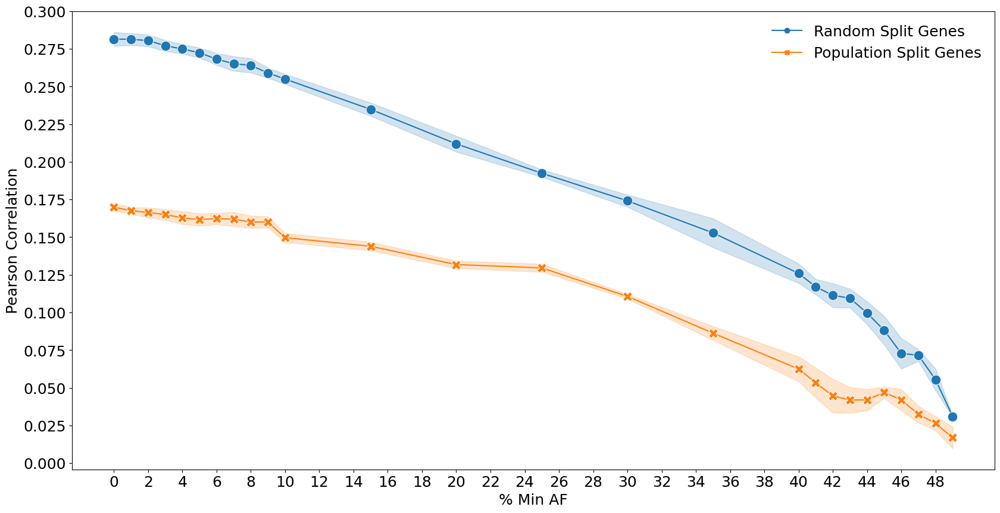

In [15]:
fontsize = 18
plt.rcParams.update({'font.size': fontsize})
matplotlib.rc('xtick', labelsize=fontsize) 
matplotlib.rc('ytick', labelsize=fontsize)
fig, ax = plt.subplots(figsize=(20, 10))

sns.lineplot(data=plot_df[plot_df["Gene Classes"] != "Unseen Genes"], 
             x="% Min AF", 
             style="Gene Classes",
             y="Pearson Correlation", 
             hue="Gene Classes", 
             errorbar="sd", 
             ax=ax,
             markers=True, dashes=False, markersize=12,
#              err_style="bars",
             hue_order=["Random Split Genes", "Population Split Genes", ])
                        # "Unseen Genes"])
plt.xticks(np.arange(0, max(all_afs) * 100 + 1, 2))
plt.yticks(np.arange(0, max(plot_df["Pearson Correlation"]) + 0.02, 0.025))

# label points on the plot
for c, x in enumerate(set(plot_df["% Min AF"])):
    for _, hue in enumerate(set(plot_df["Gene Classes"])):
        corrs = plot_df[(plot_df["% Min AF"] == x) & (plot_df["Gene Classes"] == hue)]["Pearson Correlation"]
        disp = f"{np.mean(corrs).round(3)}" + r"$\pm$" + f"\n{np.std(corrs).round(3)}"

        # y_pos = np.mean(corrs) + ((-1)**(c))*(np.std(corrs))
        # if c % 2 != 0:
        #     y_pos -= 0.01
        # plt.text(x = x - 0.1, # x-coordinate position of data label
        #          y = y_pos, # y-coordinate position of data label, adjusted to be 150 below the data point
        #          s = disp, # data label, formatted to ignore decimals
        #          color = "black") # set colour of line

plt.legend(frameon=False)
# ax.spines['top'].set_visible(False)
# ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)

plt.savefig("figures/fig_1_perf_vs_num_samples.pdf")
# plt.tick_params(axis="x", labelrotation=45)